In [1]:
# py38 environment, python = 3.8
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc

## v1.2 after initial clean up

In [ ]:
adata_clean = sc.read_h5ad('normalized_gex_all_no_ribo_clustering_remove_B_mito.h5ad')

In [ ]:
sc.pp.highly_variable_genes(adata_clean, layer = 'raw_data', n_top_genes = 4000, flavor = 'seurat_v3')
adata_clean.uns['id_hvg'] = np.where(adata_clean.var['highly_variable'])[0]
sc.tl.pca(adata_clean, n_comps=30, use_highly_variable=None)
sc.pp.neighbors(adata_clean, n_neighbors=30, use_rep='X_pca', metric='euclidean', key_added='neighbors_30')
sc.tl.umap(adata_clean, neighbors_key = 'neighbors_30', min_dist=0.1)
sc.tl.draw_graph(adata_clean, layout='fa', random_state=0, neighbors_key='neighbors_30')

### Initial Clustering

In [ ]:
sc.external.tl.phenograph(adata_clean, clustering_algo='louvain', k=30, jaccard=True, primary_metric='euclidean', 
                          resolution_parameter=1)

#import scipy
adata_clean.obsp['pheno_jaccard_ig'] = scipy.sparse.csr_matrix(adata_clean.obsp['pheno_jaccard_ig'])

Finding 30 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 3.3461802005767822 seconds
Jaccard graph constructed in 8.555759191513062 seconds
Wrote graph to binary file in 0.9349498748779297 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.844224
After 8 runs, maximum modularity is Q = 0.845515
Louvain completed 28 runs in 69.16415619850159 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 84.35402822494507 seconds


/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


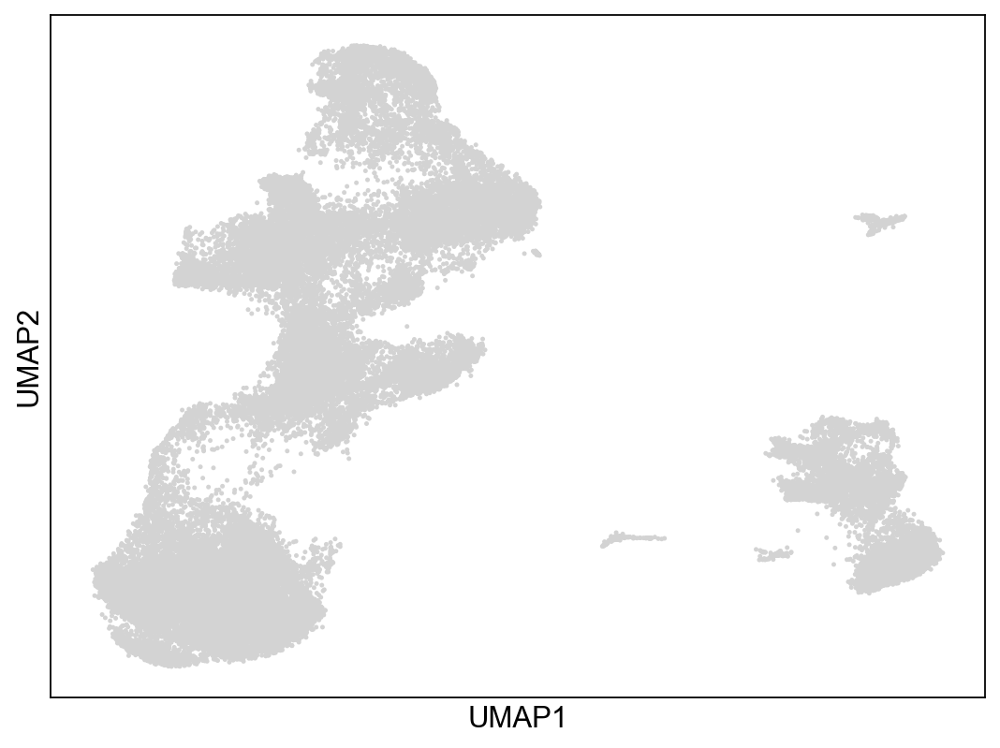

In [ ]:
sc.pl.umap(adata_clean, size = 20)

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


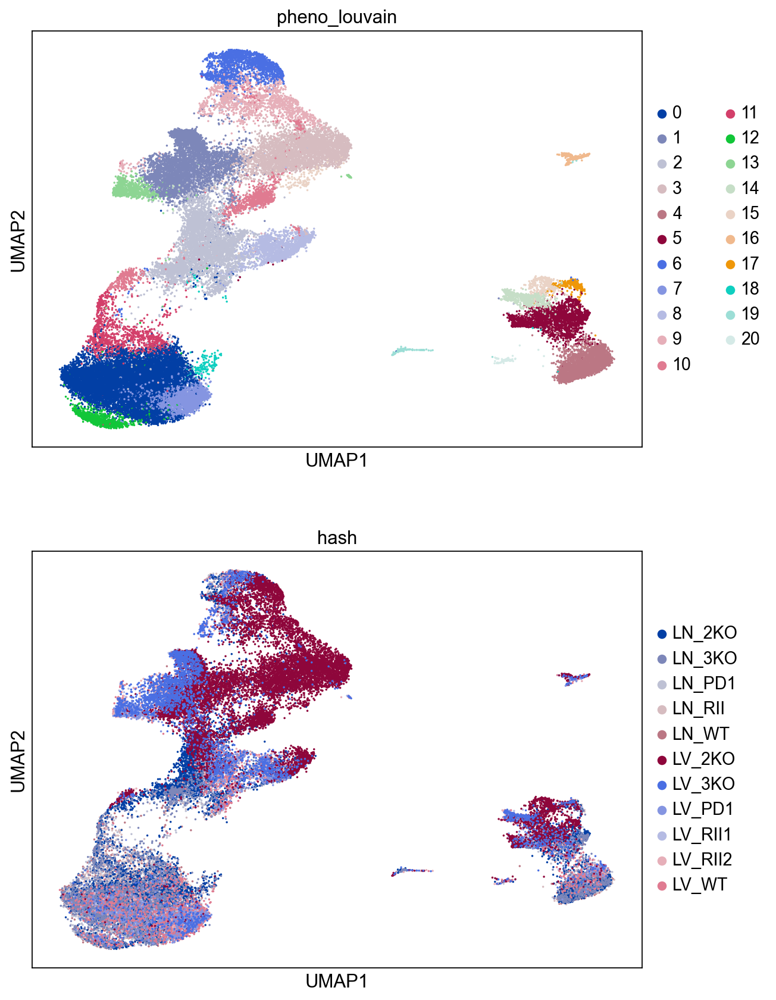

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14, figsize = (8, 6))
sc.pl.umap(adata_clean, color = ['pheno_louvain', 'hash'], s = 10, palette = sc.pl.palettes.zeileis_28, ncols = 1)

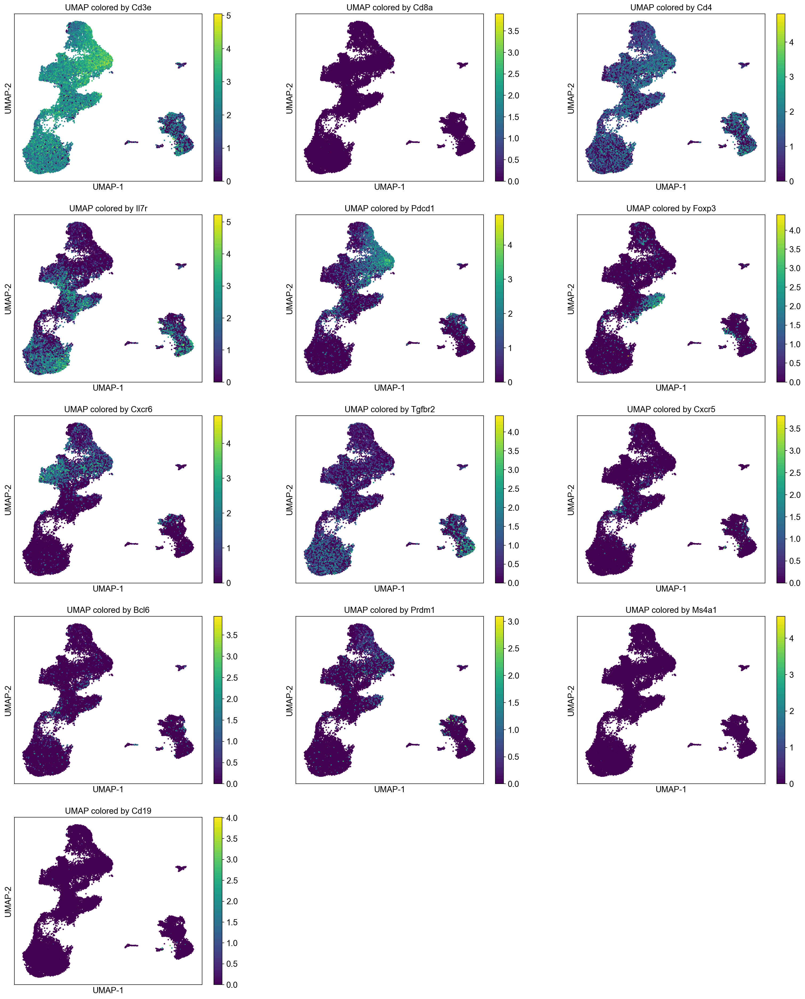

In [ ]:
genes = ['Cd3e', 'Cd8a', 'Cd4', 'Il7r', 'Pdcd1', 'Foxp3', 'Cxcr6', 'Tgfbr2', 'Cxcr5', 'Bcl6', 'Prdm1', 'Ms4a1', 'Cd19']

fig_nrow = 5
fig_ncol = 3

fig = plt.figure(figsize = (8*fig_ncol, 6*fig_nrow))
count = 0
for gene_name in genes:
    ax = fig.add_subplot(fig_nrow, fig_ncol, count + 1)
    col_gene = adata_clean.X[:, adata_clean.var_names.get_loc(gene_name)]
    im1 = ax.scatter(adata_clean.obsm['X_umap'][:, 0], adata_clean.obsm['X_umap'][:, 1], s = 2, c = col_gene, 
                    cmap = 'viridis')
    ax.set_xlabel('UMAP-1', fontsize = 14)
    ax.set_ylabel('UMAP-2', fontsize = 14)
    ax.set_title('UMAP colored by ' + gene_name, fontsize = 14)
    ax.set_xticks([])
    ax.set_yticks([])
    fig.colorbar(im1)
    count = count + 1
    

In [ ]:
sc.tl.rank_genes_groups(adata_clean, groupby = 'pheno_louvain', groups='all', reference='rest', method='wilcoxon')

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarni

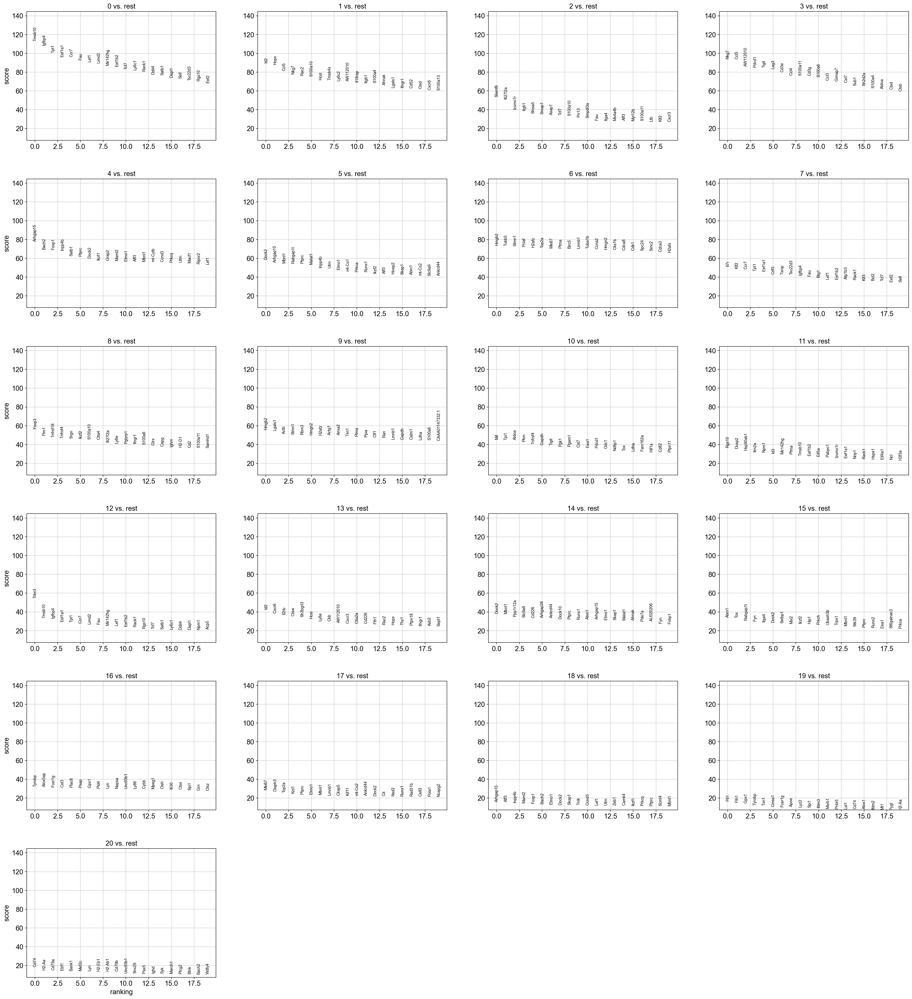

In [ ]:
sc.pl.rank_genes_groups(adata_clean)

In [ ]:
adata_clean.obs['hash']

AAACCTGAGTGTGAAT-1     LN_WT
AAACCTGCAAATTGCC-1     LN_WT
AAACCTGGTACATGTC-1     LN_WT
AAACCTGGTACGCTGC-1     LN_WT
AAACCTGTCCAAGTAC-1     LN_WT
                       ...  
TTTGGTTGTTCCCTTG-1    LV_3KO
TTTGGTTGTTGAACTC-1    LV_3KO
TTTGTCACACCGGAAA-1    LV_3KO
TTTGTCAGTATGAAAC-1    LV_3KO
TTTGTCATCAAACGGG-1    LV_3KO
Name: hash, Length: 44489, dtype: category
Categories (11, object): ['LN_2KO', 'LN_3KO', 'LN_PD1', 'LN_RII', ..., 'LV_PD1', 'LV_RII1', 'LV_RII2', 'LV_WT']

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided 

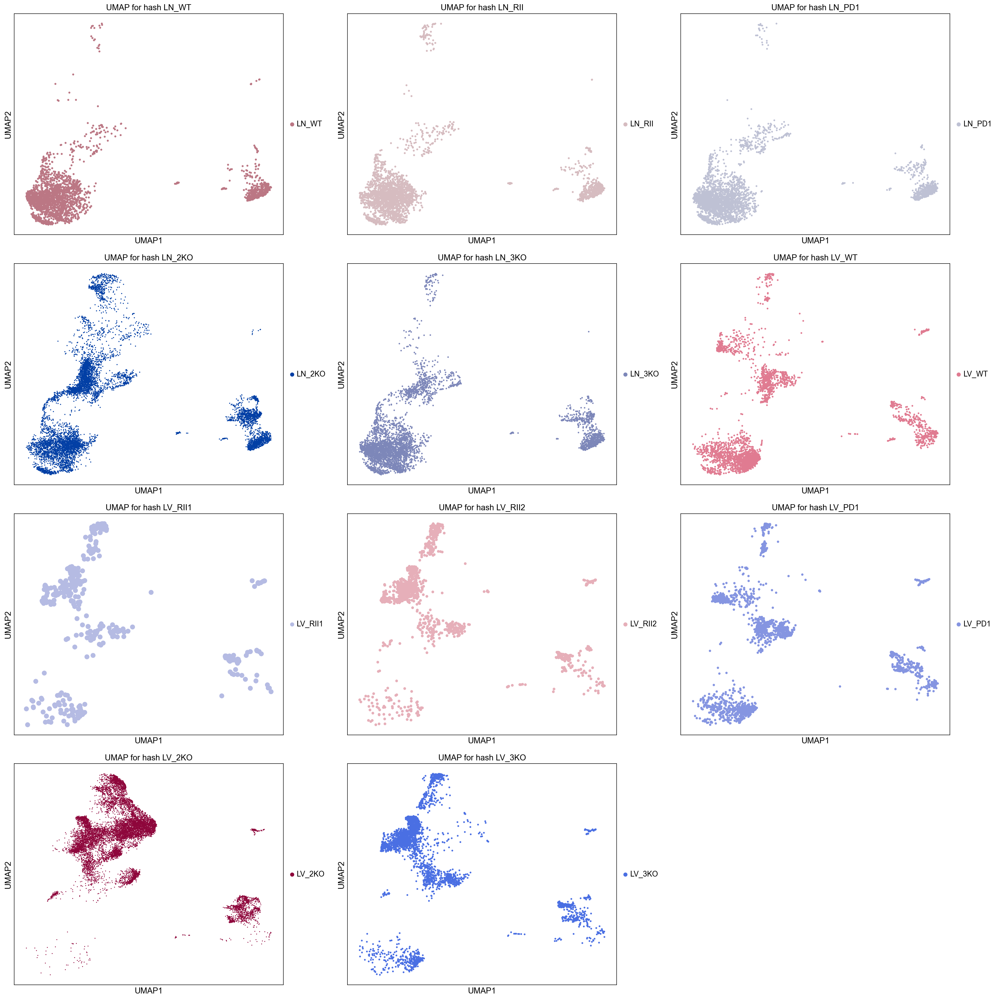

In [ ]:
unique_hashes = adata_clean.obs['hash'].unique()
nrows = 4
ncols = 3
fig, axs = plt.subplots(nrows, ncols, figsize = (8*ncols, 6*nrows))
axs = axs.flatten()  # Flatten to easily iterate over

for i, hash_val in enumerate(unique_hashes):
    adata_subset = adata_clean[adata_clean.obs['hash'] == hash_val]
    # Plot in the correct subplot
    sc.pl.umap(adata_subset, color='hash', title=f'UMAP for hash {hash_val}', ax=axs[i], show=False)

# Remove unused subplots
if len(axs) > len(unique_hashes):
    for i in range(len(unique_hashes), len(axs)):
        fig.delaxes(axs[i])

plt.tight_layout()
plt.show()

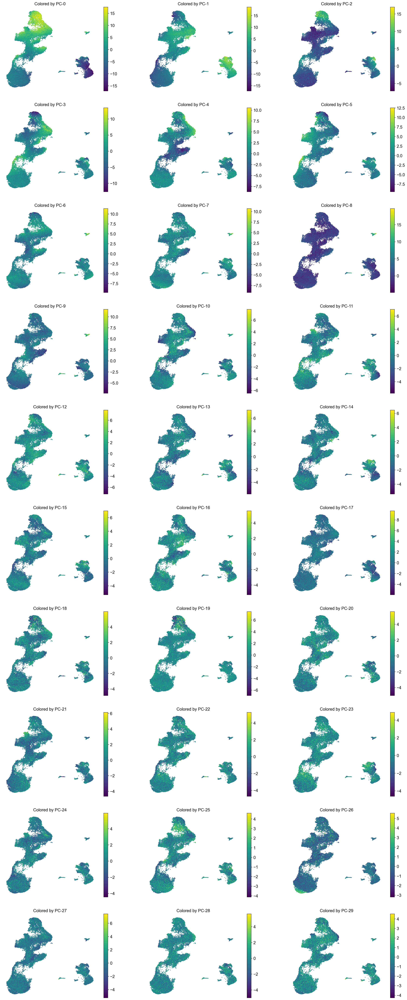

In [ ]:
# Color UMAP by PCA
nrows = 10
ncols = 3
fig = plt.figure(figsize = (8*ncols, 6*nrows))
for j in range(30):
    ax = fig.add_subplot(nrows, ncols, j+1)
    im1 = ax.scatter(adata_clean.obsm['X_umap'][:, 0], adata_clean.obsm['X_umap'][:, 1], s = 1, 
                     c = adata_clean.obsm['X_pca'][:, j])
    ax.axis('off')
    fig.colorbar(im1)
    ax.set_title('Colored by PC-' + str(j))

In [ ]:
# ensure that loadings of only HVG are kept track of
adata_clean.uns['loadings'] = adata_clean.varm['PCs'][adata_clean.var['highly_variable'], :]
df_loadings = pd.DataFrame(adata_clean.uns['loadings'], 
                           index = adata_clean.var_names[adata.var['highly_variable']], 
                           columns = ['PC-' + str(j) for j in range(30)])

In [ ]:
np.abs(df_loadings).sort_values(by = 'PC-0', ascending = False)['PC-0'][0:20]

Nos2        0.224654
Gpi1        0.167230
Ssr2        0.158477
AW112010    0.150836
Eef1d       0.144115
Cks1b       0.130247
Lmna        0.120647
Pmvk        0.113861
Large1      0.112563
Tmsb4x      0.107875
Rnf157      0.104718
Meg3        0.099223
Pla2g12a    0.092496
Kdm6b       0.089209
Ndufb9      0.089193
Asf1a       0.088303
Acsm1       0.087957
Asah1       0.087630
Treml1      0.086363
Actb        0.085153
Name: PC-0, dtype: float64

#### save

In [ ]:
adata_clean.write_h5ad('normalized_gex_all_no_ribo_clustering_remove_B_mito_clustering.h5ad')

### Choice of clustering parameters

In [ ]:
adata = sc.read_h5ad('normalized_gex_all_no_ribo_clustering_remove_B_mito_clustering.h5ad')

In [ ]:
# Compute clusters for various values of k: around k = 30
k_vals = np.arange(21, 42, 3)
cluster_label_list = []
Q_list = []
for k in k_vals:
    cluster_label, graph, Q = sc.external.tl.phenograph(adata, clustering_algo='louvain', k=k, jaccard=True, 
                                                        primary_metric='euclidean', resolution_parameter=1, 
                                                        copy = True)
    cluster_label_list.append(cluster_label)
    Q_list.append(Q)

Finding 21 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 3.334005832672119 seconds
Jaccard graph constructed in 6.913509130477905 seconds
Wrote graph to binary file in 0.7156422138214111 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.851229
After 7 runs, maximum modularity is Q = 0.854161
Louvain completed 27 runs in 55.71545720100403 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 68.75910568237305 seconds
Finding 24 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 3.00520396232605 seconds
Jaccard graph constructed in 7.030363321304321 seconds
Wrote graph to binary file in 0.6761960983276367 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.848583
After 4 runs, maximum modularity is Q = 0.85063
Louvain completed 24 runs in 43.98948574066162 seconds
Sorting communities by size, please wait ...
PhenoGraph

Text(0, 0.5, 'Modularity score')

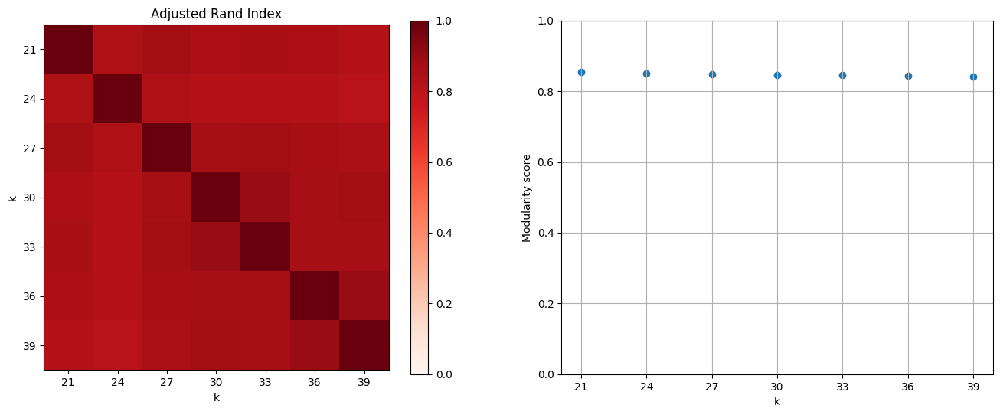

In [ ]:
# Look at the similarity in clustering assignments across various values of k
# We will use adjusted_rand_score for this:
from sklearn.metrics import adjusted_rand_score

rand_index_mat = np.zeros(shape = (len(k_vals), len(k_vals)))
for ct0 in range(len(k_vals)):
    for ct1 in range(len(k_vals)):
        rand_index_mat[ct0, ct1] = adjusted_rand_score(cluster_label_list[ct0], cluster_label_list[ct1])
    
fig = plt.figure(figsize = (8*2, 6*1))
ax = fig.add_subplot(1, 2, 1)
im1 = ax.imshow(rand_index_mat, cmap = 'Reds', vmin = 0, vmax = 1)
fig.colorbar(im1)
ax.set_xticks(range(len(k_vals)))
ax.set_xticklabels(k_vals)
ax.set_yticks(range(len(k_vals)));
ax.set_yticklabels(k_vals);
ax.set_xlabel('k')
ax.set_ylabel('k')
ax.set_title('Adjusted Rand Index')

ax = fig.add_subplot(1, 2, 2)
ax.scatter(k_vals, Q_list)
ax.grid('on')
ax.set_ylim([0, 1])
ax.set_xticks(k_vals);
ax.set_xlabel('k')
ax.set_ylabel('Modularity score')

In [ ]:
# Compute clusters for various values of k: around k = 30
r_vals = np.arange(0.2, 2.2, 0.4)
cluster_label_list = []
Q_list = []
for resoultion in r_vals:
    cluster_label, graph, Q = sc.external.tl.phenograph(adata, clustering_algo='louvain', k=30, jaccard=True, 
                                                        primary_metric='euclidean', resolution_parameter=resoultion, 
                                                        copy = True)
    cluster_label_list.append(cluster_label)
    Q_list.append(Q)

Finding 30 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 3.066362142562866 seconds
Jaccard graph constructed in 9.211262941360474 seconds
Wrote graph to binary file in 1.2327470779418945 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.845716
After 13 runs, maximum modularity is Q = 0.847027
Louvain completed 33 runs in 77.52980017662048 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 93.36139225959778 seconds
Finding 30 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 3.919201135635376 seconds
Jaccard graph constructed in 8.769636869430542 seconds
Wrote graph to binary file in 1.1860668659210205 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.845297
Louvain completed 21 runs in 55.79407787322998 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 71.97369909286499 seconds
Findin

Text(0, 0.5, 'Modularity score')

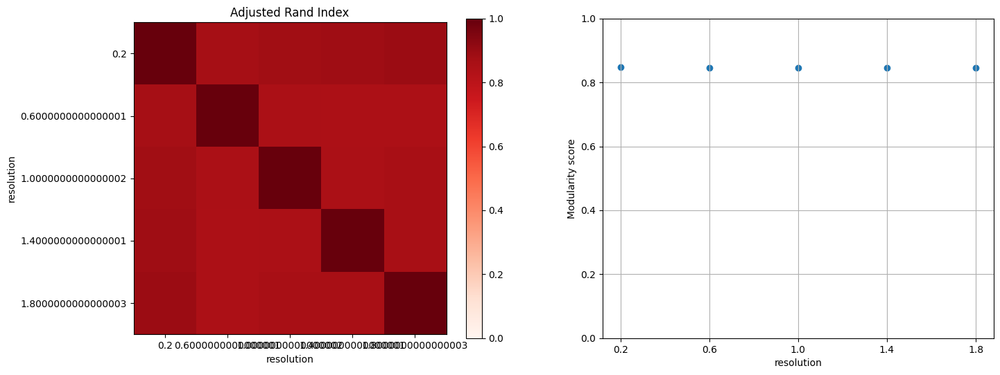

In [ ]:
# Look at the similarity in clustering assignments across various values of k
# We will use adjusted_rand_score for this:
from sklearn.metrics import adjusted_rand_score

rand_index_mat = np.zeros(shape = (len(r_vals), len(r_vals)))
for ct0 in range(len(r_vals)):
    for ct1 in range(len(r_vals)):
        rand_index_mat[ct0, ct1] = adjusted_rand_score(cluster_label_list[ct0], cluster_label_list[ct1])
    
fig = plt.figure(figsize = (8*2, 6*1))
ax = fig.add_subplot(1, 2, 1)
im1 = ax.imshow(rand_index_mat, cmap = 'Reds', vmin = 0, vmax = 1)
fig.colorbar(im1)
ax.set_xticks(range(len(r_vals)))
ax.set_xticklabels(r_vals)
ax.set_yticks(range(len(r_vals)));
ax.set_yticklabels(r_vals);
ax.set_xlabel('resolution')
ax.set_ylabel('resolution')
ax.set_title('Adjusted Rand Index')

ax = fig.add_subplot(1, 2, 2)
ax.scatter(r_vals, Q_list)
ax.grid('on')
ax.set_ylim([0, 1])
ax.set_xticks(r_vals);
ax.set_xlabel('resolution')
ax.set_ylabel('Modularity score')

In [ ]:
adata

AnnData object with n_obs × n_vars = 44489 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'pheno_louvain_str'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'draw_graph', 'hash_colors', 'hvg', 'id_hvg', 'loadings', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'rank_genes_groups', 'umap', 'dendrogram_pheno_louvain', 'wilcoxon', 'pheno_louvain_str_colors', 'dendrogram_pheno_louvain_str'
    obsm: 'X_draw_graph_fa', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'norm_counts', 'raw_data', 'zs_no

In [ ]:
# Compute clusters for various resolution values ---> failed, need to redo to try different resolutions
import phenograph

r_vals = np.arange(0.4, 1.2, 0.2)
Q_list = []
base = 'pheno_louvain_'
for resolution in r_vals:
    cluster_label, graph, Q = phenograph.cluster(adata.obsp['neighbors_30_distances'], 
                                            clustering_algo = 'louvain', resolution_parameter = resolution)
    name = base + str(resolution)
    adata.obs[name] = cluster_label


Using neighbor information from provided graph, rather than computing neighbors directly
Jaccard graph constructed in 8.833095788955688 seconds
Wrote graph to binary file in 0.8240828514099121 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.844497
After 2 runs, maximum modularity is Q = 0.846229
After 6 runs, maximum modularity is Q = 0.847449
Louvain completed 26 runs in 58.188568115234375 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 71.10290622711182 seconds
Using neighbor information from provided graph, rather than computing neighbors directly
Jaccard graph constructed in 7.448202848434448 seconds
Wrote graph to binary file in 0.7650630474090576 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.845435
After 5 runs, maximum modularity is Q = 0.846636
After 24 runs, maximum modularity is Q = 0.847656
Louvain completed 44 runs in 90.44290614128113 seconds
Sorting communiti

In [ ]:
adata

AnnData object with n_obs × n_vars = 44489 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'pheno_louvain_str', 'pheno_louvain_0.4', 'pheno_louvain_0.6000000000000001', 'pheno_louvain_0.8000000000000002', 'pheno_louvain_1.0000000000000002'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'draw_graph', 'hash_colors', 'hvg', 'id_hvg', 'loadings', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'rank_genes_groups', 'umap', 'dendrogram_pheno_louvain', 'wilcoxon', 'pheno_louvain_str_colors', 'dendrogra

In [ ]:
adata.obs.rename(columns={'pheno_louvain_0.6000000000000001': 'pheno_louvain_0.6',
                          'pheno_louvain_0.8000000000000002': 'pheno_louvain_0.8',
                          'pheno_louvain_1.0000000000000002': 'pheno_louvain_1.0'}, inplace=True)
adata

AnnData object with n_obs × n_vars = 44489 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'pheno_louvain_str', 'pheno_louvain_0.4', 'pheno_louvain_0.6', 'pheno_louvain_0.8', 'pheno_louvain_1.0'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'draw_graph', 'hash_colors', 'hvg', 'id_hvg', 'loadings', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'rank_genes_groups', 'umap', 'dendrogram_pheno_louvain', 'wilcoxon', 'pheno_louvain_str_colors', 'dendrogram_pheno_louvain_str'
    obsm: 'X_draw_graph_

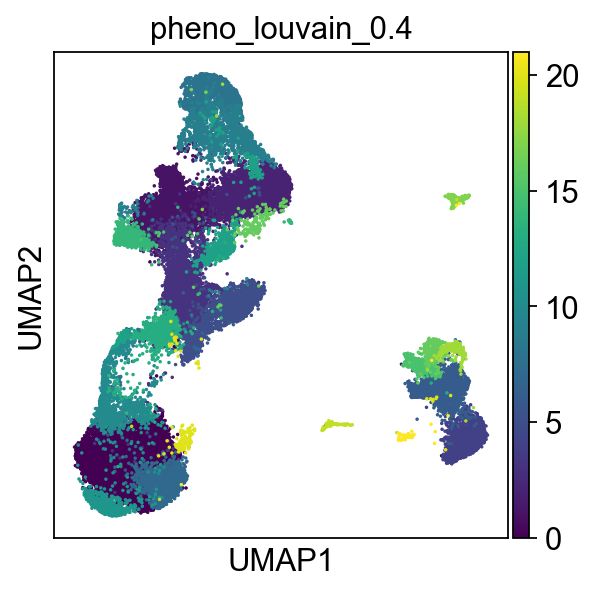

In [ ]:
sc.settings.set_figure_params(dpi=80)
sc.pl.umap(adata, color='pheno_louvain_0.4',  s = 10, palette = sc.pl.palettes.zeileis_28, legend_fontsize = 14)

In [ ]:
# conclusion: k =30 , resultion =1 is robust

### Exploratory analysis

In [ ]:
adata = sc.read_h5ad('intermediate/normalized_gex_all_no_ribo_clustering_remove_B_mito_clustering.h5ad')

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [ ]:
# formating
adata.obs['organ'] = adata.obs['hash'].apply(lambda x: 'LV' if 'LV' in x else 'LN')
adata.obs['sample'] = adata.obs['hash'].apply(lambda x: 'LV_RII' if 'LV_RII' in x else x)
def assign_genotype(x):
    if 'WT' in x:
        return 'WT'
    elif 'RII' in x:
        return 'RII'
    elif 'PD1' in x:
        return 'PD1'
    elif '2KO' in x:
        return '2KO'
    else:
        return '3KO'

adata.obs['genotype'] = adata.obs['hash'].apply(assign_genotype)
adata.obs_names_make_unique()

#### Annotation 

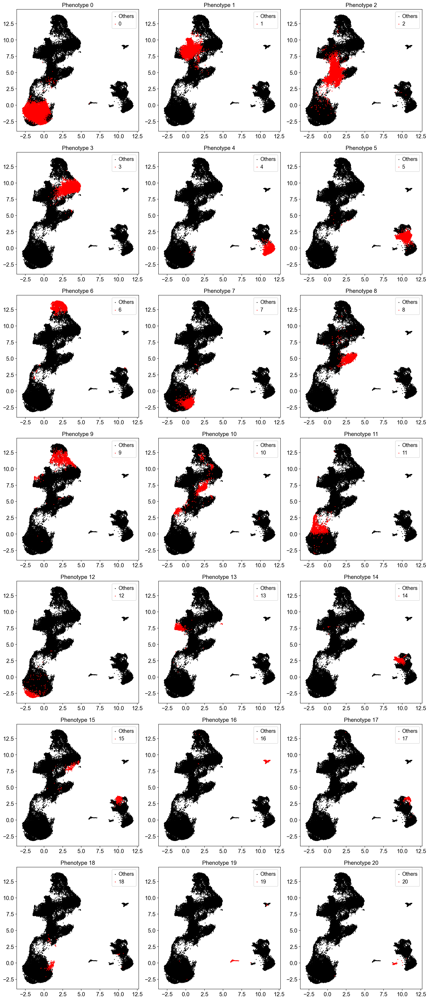

In [ ]:
fig, axs = plt.subplots(7, 3, figsize=(15,35))  
axs = axs.ravel()  # flatten the axes for easy indexing

for i in range(21):  # for i from 0 to 20
    cells = np.isin(adata.obs['pheno_louvain'], [i])
    axs[i].scatter(adata.obsm['X_umap'][~cells, 0], adata.obsm['X_umap'][~cells, 1], s=1, c='k', label='Others')
    axs[i].scatter(adata.obsm['X_umap'][cells, 0], adata.obsm['X_umap'][cells, 1], s=1, c='r', label=f'{i}')
    axs[i].set_title(f'Phenotype {i}')
    axs[i].legend()
    axs[i].grid(False)

plt.tight_layout()
plt.show()

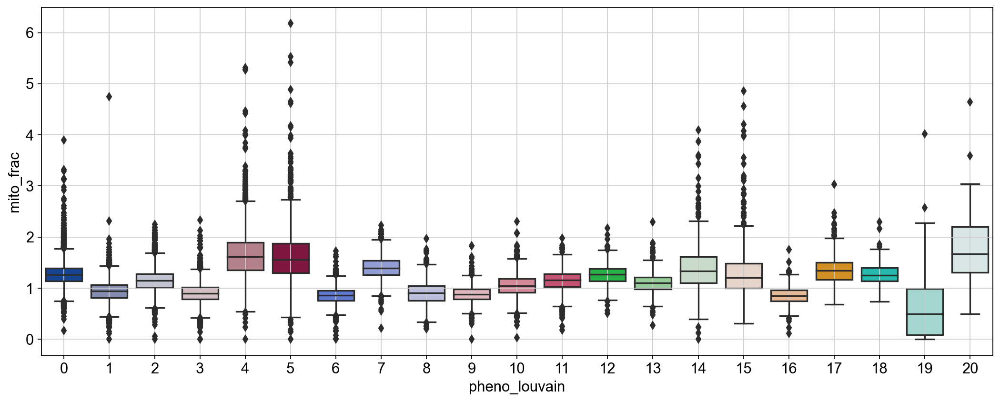

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = adata.obs[['mito_frac', 'pheno_louvain']]

import seaborn as sns
fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.boxplot(x = "pheno_louvain", y = "mito_frac", data = df_temp, ax = ax, 
            palette = sc.pl.palettes.zeileis_28)
ax.grid('on')

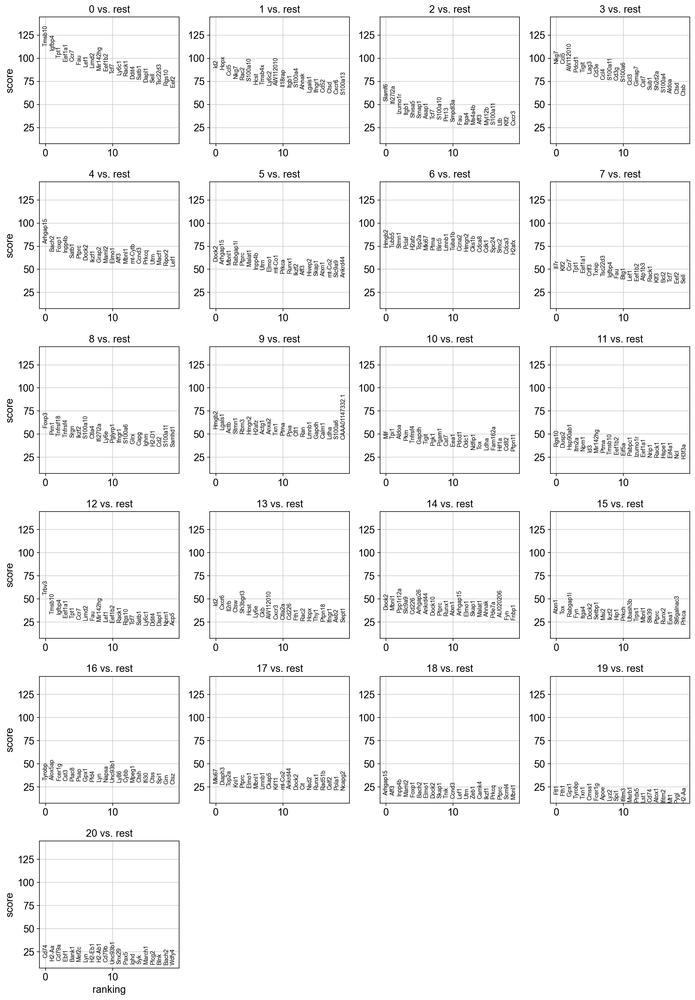

In [ ]:
sc.pl.rank_genes_groups(adata)

In [ ]:
cluster_genes = ['Tgfbr2','Tcf7', 'Sell', 'Lef1', 'Cd69', 'Ccr7', 'Il7r', 'Ly6c2','Foxp3', 'Il2ra', 'Il21', 'Bcl6', 'Prdm1','Pdcd1', 'Lag3', 'Cxcr6', 'Gzmk',
                 'Ifng', 'Ifngr1','Tbx21', 'Il2', 'Ldha', 'Mki67', 'Itgae','Cd40lg' ]

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


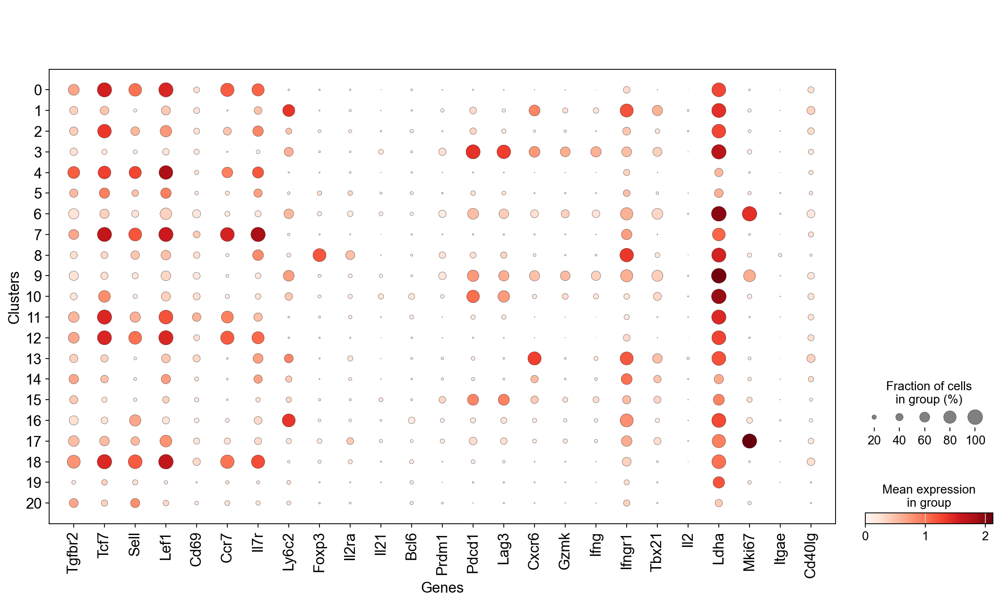

In [ ]:
fig = plt.figure(figsize = (8*2, 6*1.5))
ax1 = fig.add_subplot(1, 1, 1)
ac = sc.pl.dotplot(adata, cluster_genes, groupby = 'pheno_louvain', log=True, layer = 'norm_counts', 
                   show = False, ax = ax1)

# Label the x and y-axes
ac['mainplot_ax'].set_xlabel('Genes', fontsize = 14)
ac['mainplot_ax'].set_ylabel('Clusters', fontsize = 14)

# Increase the fontsize of the x ticklabels
ac['mainplot_ax'].set_xticklabels(ac['mainplot_ax'].get_xticklabels(), fontsize = 14)

# Increase the fontsize of the y ticklabels
ac['mainplot_ax'].set_yticklabels(ac['mainplot_ax'].get_yticklabels(), fontsize = 14);

/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


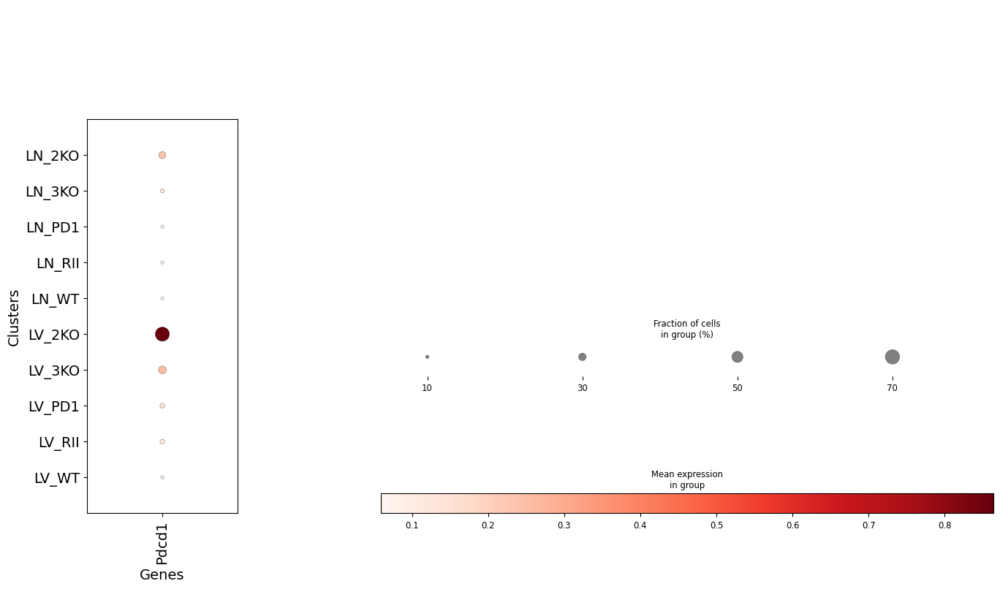

In [ ]:
cluster_genes = ['Pdcd1' ]
fig = plt.figure(figsize = (8*2, 6*1.5))
ax1 = fig.add_subplot(1, 1, 1)
ac = sc.pl.dotplot(adata, cluster_genes, groupby = 'sample', log=True, layer = 'norm_counts', 
                   show = False, ax = ax1)

# Label the x and y-axes
ac['mainplot_ax'].set_xlabel('Genes', fontsize = 14)
ac['mainplot_ax'].set_ylabel('Clusters', fontsize = 14)

# Increase the fontsize of the x ticklabels
ac['mainplot_ax'].set_xticklabels(ac['mainplot_ax'].get_xticklabels(), fontsize = 14)

# Increase the fontsize of the y ticklabels
ac['mainplot_ax'].set_yticklabels(ac['mainplot_ax'].get_yticklabels(), fontsize = 14);

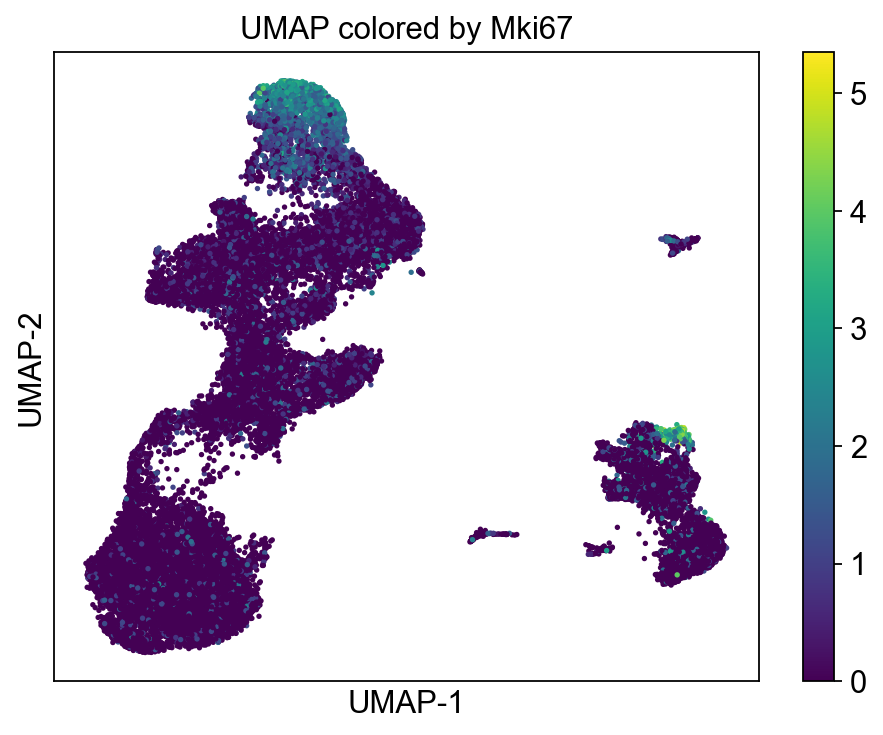

In [ ]:
genes = ['Mki67']
fig_nrow = 5
fig_ncol = 3

fig = plt.figure(figsize = (8*fig_ncol, 6*fig_nrow))
count = 0
for gene_name in genes:
    ax = fig.add_subplot(fig_nrow, fig_ncol, count + 1)
    col_gene = adata.X[:, adata.var_names.get_loc(gene_name)]
    im1 = ax.scatter(adata.obsm['X_umap'][:, 0], adata.obsm['X_umap'][:, 1], s = 2, c = col_gene, 
                    cmap = 'viridis')
    ax.set_xlabel('UMAP-1', fontsize = 14)
    ax.set_ylabel('UMAP-2', fontsize = 14)
    ax.set_title('UMAP colored by ' + gene_name, fontsize = 14)
    ax.set_xticks([])
    ax.set_yticks([])
    fig.colorbar(im1)
    count = count + 1

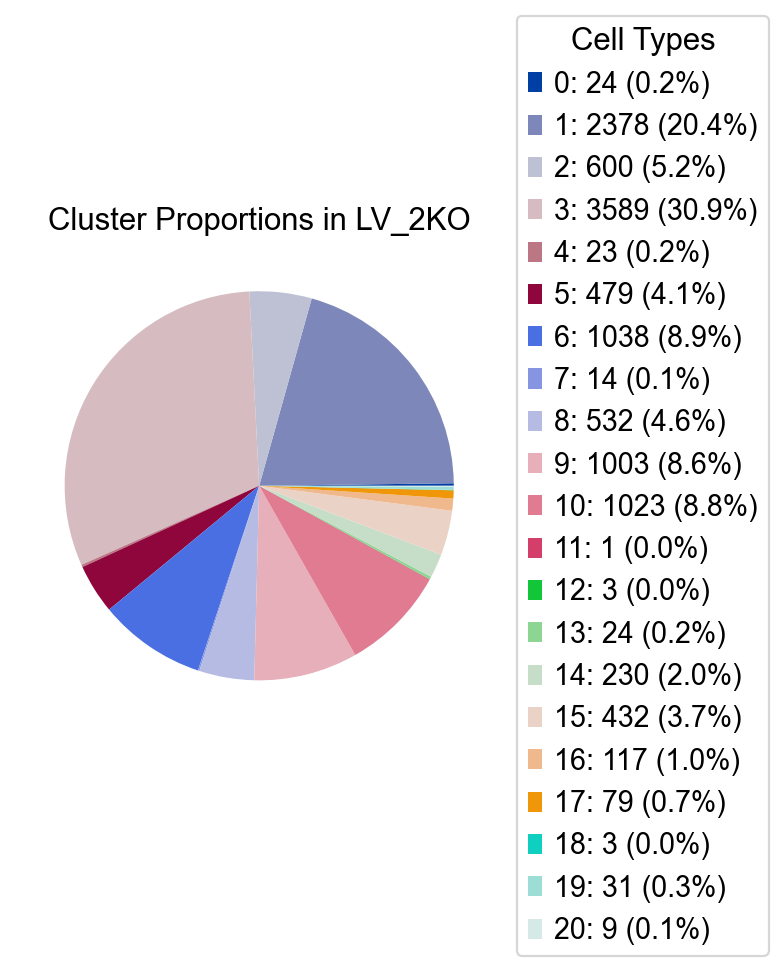

In [ ]:
# Assuming adata.obs['sample'] contains sample IDs and adata.obs['cluster'] contains cluster labels
grouped = adata.obs.groupby(['sample', 'pheno_louvain']).size().reset_index(name='counts')

# For one specific sample
sample_name = 'LV_2KO'

sample_data = grouped[grouped['sample'] == sample_name]

# Retrieve the custom color palette from Scanpy
colors = sc.pl.palettes.zeileis_28

# Cut or extend the color palette to the needed number of colors
colors_needed = len(sample_data)
if colors_needed > len(colors):
    print(f"Warning: Not enough colors in palette, consider using another palette.")
else:
    colors = colors[:colors_needed]

# Create the pie chart
fig, ax = plt.subplots()
wedges, texts = ax.pie(
    sample_data['counts'], 
    labels=None,  # No labels inside pie chart
    autopct=None,  # No autopct inside pie chart
    colors=colors
)

# Prepare labels with counts and percentages for the legend
labels_with_counts_and_percentages = [
    f"{row['pheno_louvain']}: {row['counts']} ({row['counts']/sample_data['counts'].sum()*100:.1f}%)"
    for _, row in sample_data.iterrows()
]

# Add a legend with the labels, counts, and percentages
plt.legend(wedges, labels_with_counts_and_percentages,
           title="Cell Types",
           loc="center left",
           bbox_to_anchor=(1, 0, 0.5, 1))

plt.title(f'Cluster Proportions in {sample_name}')
plt.show()

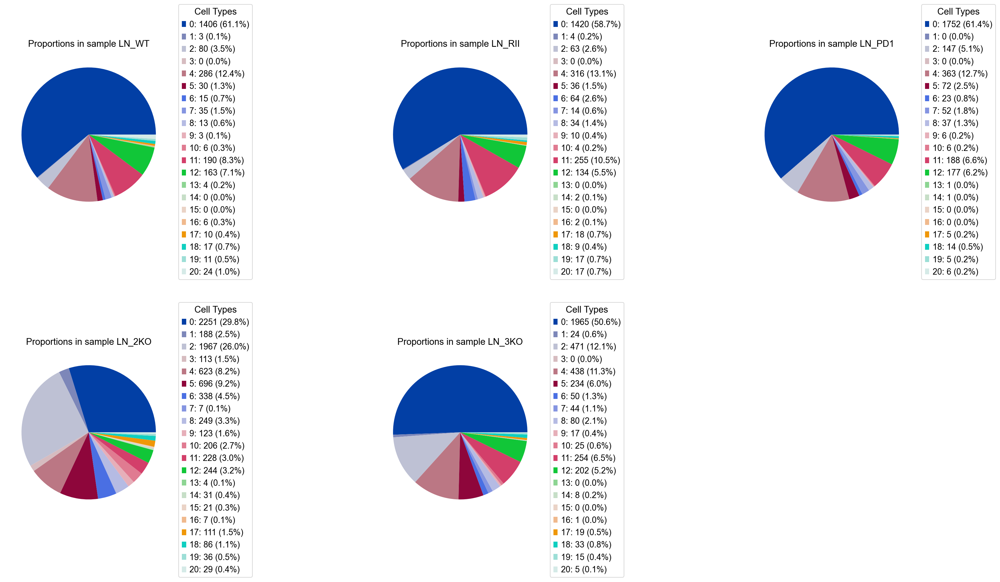

In [ ]:
unique_samples = adata.obs['sample'].unique()
nrows = 4
ncols = 3
fig, axs = plt.subplots(nrows, ncols, figsize = (8*ncols, 6*nrows))
axs = axs.flatten()  # Flatten to easily iterate over

# Assuming adata.obs['samples'] contains sample IDs and adata.obs['cluster'] contains cluster labels
grouped = adata.obs.groupby(['sample', 'pheno_louvain']).size().reset_index(name='counts')

for i, sample_val in enumerate(unique_samples):
    sample_data = grouped[grouped['sample'] == sample_val]
    if 'LN' in sample_val:
        # Cut or extend the color palette to the needed number of colors
        colors = sc.pl.palettes.zeileis_28
        colors_needed = len(sample_data)
        if colors_needed > len(colors):
            print(f"Warning: Not enough colors in palette, consider using another palette.")
        else:
            colors = colors[:colors_needed]

        # Create the pie chart in the correct subplot
        wedges, texts= axs[i].pie(
            sample_data['counts'], 
            labels=None,  # No labels inside pie chart
            autopct=None,  # No autopct inside pie chart
            colors=colors
        )

        # Prepare labels with counts and percentages for the legend
        labels_with_counts_and_percentages = [
            f"{row['pheno_louvain']}: {row['counts']} ({row['counts']/sample_data['counts'].sum()*100:.1f}%)"
            for _, row in sample_data.iterrows()
        ]

        # Add a legend with the labels, counts, and percentages
        axs[i].legend(wedges, labels_with_counts_and_percentages,
                title="Cell Types",
                loc="upper right",
                bbox_to_anchor=(1, 0.3, 0.5, 1))
        
        axs[i].set_title(f'Proportions in sample {sample_val}')

# Remove unused subplots
if len(axs) > 5:
    for i in range(5, len(axs)):
        fig.delaxes(axs[i])
plt.subplots_adjust(hspace=0.5)  # Increase the space between subplots
plt.tight_layout()
plt.show()

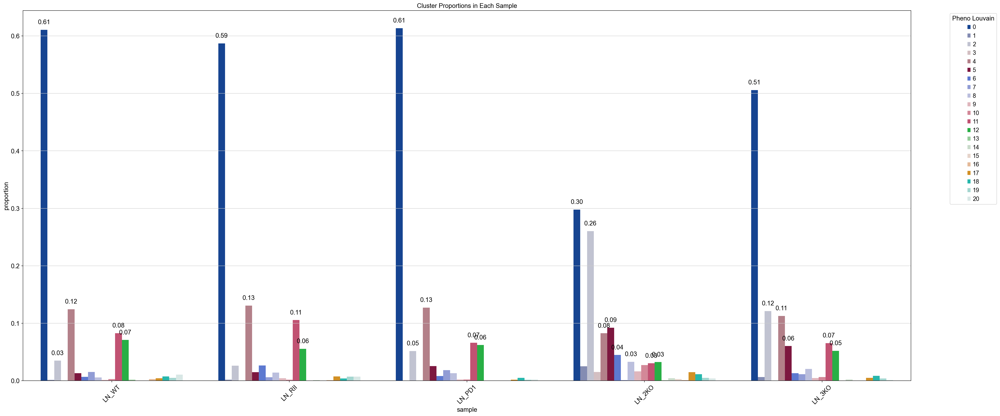

In [ ]:
grouped = adata.obs.groupby(['sample', 'pheno_louvain']).size().reset_index(name='counts')

# Calculate the total count for each sample
total_count = grouped.groupby('sample')['counts'].sum().reset_index()
total_count = total_count.rename(columns={'counts': 'total_count'})

# Merge this total count back to the original dataframe
grouped = pd.merge(grouped, total_count, on='sample', how='left')

# Calculate the proportion for each cluster in each sample
grouped['proportion'] = grouped['counts'] / grouped['total_count']

# Define the order in which you want the samples to appear
sample_order = ['LN_WT', 'LN_RII', 'LN_PD1', 'LN_2KO', 'LN_3KO']

# Create the plot with an extended x-axis
plt.figure(figsize=(35, 15)) 
# Now, plot these proportions
bar_plot = sns.barplot(x='sample', y='proportion', hue='pheno_louvain', 
            data=grouped, palette=sc.pl.palettes.zeileis_28, width = 0.8, order=sample_order)

# Title and Legend
plt.title('Cluster Proportions in Each Sample')
plt.legend(loc='upper right', bbox_to_anchor=(1.1, 1), title='Pheno Louvain')

# Annotate the bars at the bottom
for p in bar_plot.patches:
    height = p.get_height()
    if height > 0.03:  # Adjust the threshold as needed
        bar_plot.annotate(f"{height:.2f}", 
                          (p.get_x() + p.get_width() / 2., height),
                          ha='center', va='bottom',
                          xytext=(0, 10),  
                          textcoords='offset points')

# Rotate x-axis labels if necessary
plt.xticks(rotation=45)

plt.show()

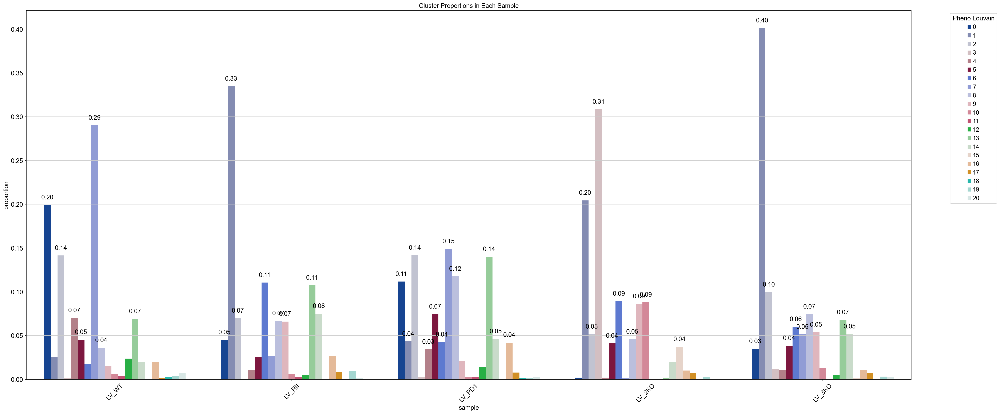

In [ ]:

# Assuming adata.obs['sample'] contains sample IDs and adata.obs['cluster'] contains cluster labels
grouped = adata.obs.groupby(['sample', 'pheno_louvain']).size().reset_index(name='counts')

# Calculate the total count for each sample
total_count = grouped.groupby('sample')['counts'].sum().reset_index()
total_count = total_count.rename(columns={'counts': 'total_count'})

# Merge this total count back to the original dataframe
grouped = pd.merge(grouped, total_count, on='sample', how='left')

# Calculate the proportion for each cluster in each sample
grouped['proportion'] = grouped['counts'] / grouped['total_count']

# Define the order in which you want the samples to appear
sample_order = ['LV_WT', 'LV_RII', 'LV_PD1', 'LV_2KO', 'LV_3KO']

# Create the plot with an extended x-axis
plt.figure(figsize=(35, 15)) 
# Now, plot these proportions
bar_plot = sns.barplot(x='sample', y='proportion', hue='pheno_louvain', 
            data=grouped, palette=sc.pl.palettes.zeileis_28, width = 0.8, order=sample_order)

# Title and Legend
plt.title('Cluster Proportions in Each Sample')
plt.legend(loc='upper right', bbox_to_anchor=(1.1, 1), title='Pheno Louvain')

# Annotate the bars at the bottom
for p in bar_plot.patches:
    height = p.get_height()
    if height > 0.03:  # Adjust the threshold as needed
        bar_plot.annotate(f"{height:.2f}", 
                          (p.get_x() + p.get_width() / 2., height),
                          ha='center', va='bottom',
                          xytext=(0, 10),  
                          textcoords='offset points')

# Rotate x-axis labels if necessary
plt.xticks(rotation=45)

plt.show()

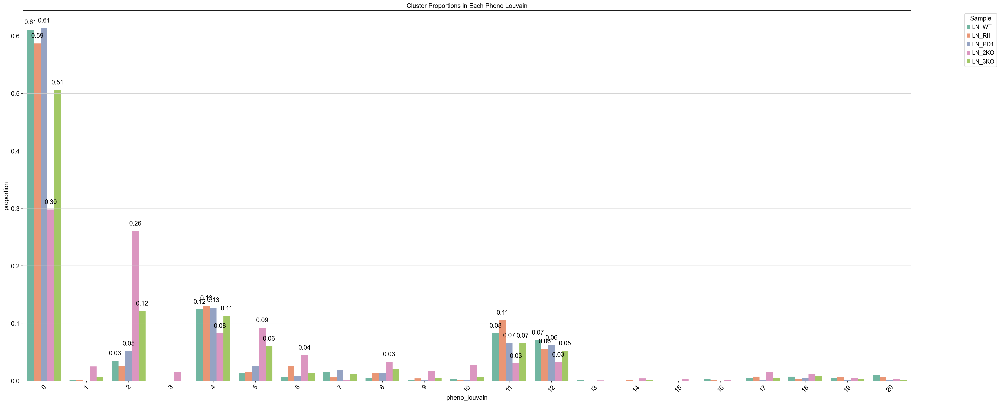

In [ ]:
# Assuming adata.obs['sample'] contains sample IDs and adata.obs['cluster'] contains cluster labels
grouped = adata.obs.groupby(['sample', 'pheno_louvain']).size().reset_index(name='counts')

# Calculate the total count for each sample
total_count = grouped.groupby('sample')['counts'].sum().reset_index()
total_count = total_count.rename(columns={'counts': 'total_count'})

# Merge this total count back to the original dataframe
grouped = pd.merge(grouped, total_count, on='sample', how='left')

# Calculate the proportion for each cluster in each sample
grouped['proportion'] = grouped['counts'] / grouped['total_count']

# Define the order in which you want the samples to appear
sample_order = ['LN_WT', 'LN_RII', 'LN_PD1', 'LN_2KO', 'LN_3KO']

# Create the plot with an extended x-axis
plt.figure(figsize=(35, 15)) 
# Now, plot these proportions
bar_plot = sns.barplot(x='pheno_louvain', y='proportion', hue='sample', 
            data=grouped, palette='Set2', width=0.8,
            hue_order=sample_order)  # You can keep hue_order if you want to control the order of the hue

# Title and Legend
plt.title('Cluster Proportions in Each Pheno Louvain')
plt.legend(loc='upper right', bbox_to_anchor=(1.1, 1), title='Sample')

# Annotate the bars at the bottom
for p in bar_plot.patches:
    height = p.get_height()
    if height > 0.03:  # Adjust the threshold as needed
        bar_plot.annotate(f"{height:.2f}", 
                          (p.get_x() + p.get_width() / 2., height),
                          ha='center', va='bottom',
                          xytext=(0, 10),  
                          textcoords='offset points')

# Rotate x-axis labels if necessary
plt.xticks(rotation=45)

plt.show()


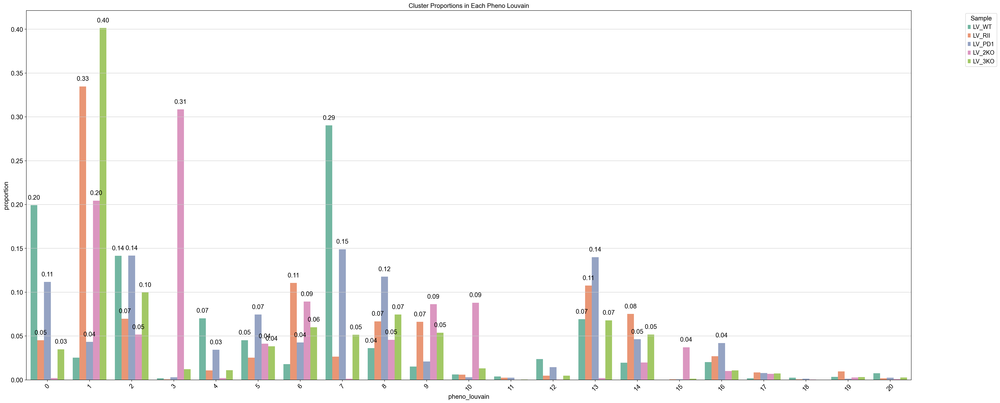

In [ ]:
# Assuming adata.obs['sample'] contains sample IDs and adata.obs['cluster'] contains cluster labels
grouped = adata.obs.groupby(['sample', 'pheno_louvain']).size().reset_index(name='counts')

# Calculate the total count for each sample
total_count = grouped.groupby('sample')['counts'].sum().reset_index()
total_count = total_count.rename(columns={'counts': 'total_count'})

# Merge this total count back to the original dataframe
grouped = pd.merge(grouped, total_count, on='sample', how='left')

# Calculate the proportion for each cluster in each sample
grouped['proportion'] = grouped['counts'] / grouped['total_count']

# Define the order in which you want the samples to appear
sample_order = ['LV_WT', 'LV_RII', 'LV_PD1', 'LV_2KO', 'LV_3KO']

# Create the plot with an extended x-axis
plt.figure(figsize=(35, 15)) 
# Now, plot these proportions
bar_plot = sns.barplot(x='pheno_louvain', y='proportion', hue='sample', 
            data=grouped, palette='Set2', width=0.8,
            hue_order=sample_order)  # You can keep hue_order if you want to control the order of the hue

# Title and Legend
plt.title('Cluster Proportions in Each Pheno Louvain')
plt.legend(loc='upper right', bbox_to_anchor=(1.1, 1), title='Sample')

# Annotate the bars at the bottom
for p in bar_plot.patches:
    height = p.get_height()
    if height > 0.03:  # Adjust the threshold as needed
        bar_plot.annotate(f"{height:.2f}", 
                          (p.get_x() + p.get_width() / 2., height),
                          ha='center', va='bottom',
                          xytext=(0, 10),  
                          textcoords='offset points')

# Rotate x-axis labels if necessary
plt.xticks(rotation=45)

plt.show()


In [ ]:
xls = pd.ExcelFile('elife-76339-supp2-v2.xlsx')
genes_df = xls.parse('State Signatures')
genes = {col: genes_df[col].dropna().tolist() for col in genes_df.columns}

In [ ]:
genes_remove = ['2010107E04Rik', '2010111I01Rik', 'Gm10073', 'Gm20400', 'Gm28727', 'Gm9493', 'Gm9844', 'Rpl10-ps3', 'Rpl27', 'Rps12', 'Rps12-ps3', 'Rps27']

# Iterate through the dictionary's values and remove the unwanted genes
for cell_type, gene_list in genes.items():
    genes[cell_type] = [gene for gene in gene_list if gene not in genes_remove]

# Print the updated dictionary
print(genes)

{'Th1 Effector': ['1500009L16Rik', '4930453N24Rik', 'Adgre5', 'Agpat4', 'Anxa1', 'Anxa6', 'Arsb', 'Ccl4', 'Ccl5', 'Ccr2', 'Cd48', 'Ctla2a', 'Ctsc', 'Ctsd', 'Ctsw', 'Cxcr6', 'Cyth4', 'D16Ertd472e', 'Dnajc15', 'Dusp5', 'Emp3', 'Epsti1', 'Fasl', 'Ggt1', 'Gimap7', 'Glipr2', 'Glrx', 'Gna15', 'Gzmb', 'Gzmk', 'Id2', 'Ifngr1', 'Il12rb2', 'Klrc1', 'Lgals3', 'Ly6c2', 'Mt1', 'Nkg7', 'Plac8', 'Plek', 'Ppp3ca', 'Rasgrp2', 'Rgs1', 'Rnf166', 'Rpa2', 'Runx3', 'S1pr4', 'Selplg', 'Serpinb6b', 'Serpinb9', 'Slamf1', 'Slamf7', 'Tmem163', 'Tpst2', 'Zyx'], 'Tfh Effector ': ['2310001H17Rik', 'Angptl2', 'Areg', 'Arid5b', 'Asap1', 'AY036118', 'B3gnt2', 'Cd200', 'Cd81', 'Cd83', 'Chd4', 'Coq10b', 'Crem', 'Cxcl10', 'Cxcr4', 'Cxcr5', 'Ddit4', 'Ddx24', 'Dusp1', 'Dusp14', 'Dusp4', 'Eea1', 'Ephx1', 'Fam162a', 'Fam43a', 'Fau', 'Fosl2', 'Fus', 'Fyn', 'Gapdh', 'Gas5', 'Gem', 'Gna13', 'Gpm6b', 'Hivep2', 'Hnrnpa0', 'Ikzf2', 'Il21', 'Inpp4b', 'Irf2bp2', 'Isg15', 'Isg20', 'Itgav', 'Izumo1r', 'Jak2', 'Jarid2', 'Kdm6b', 'Klf4'

Text(0, 0.5, 'Clusters')

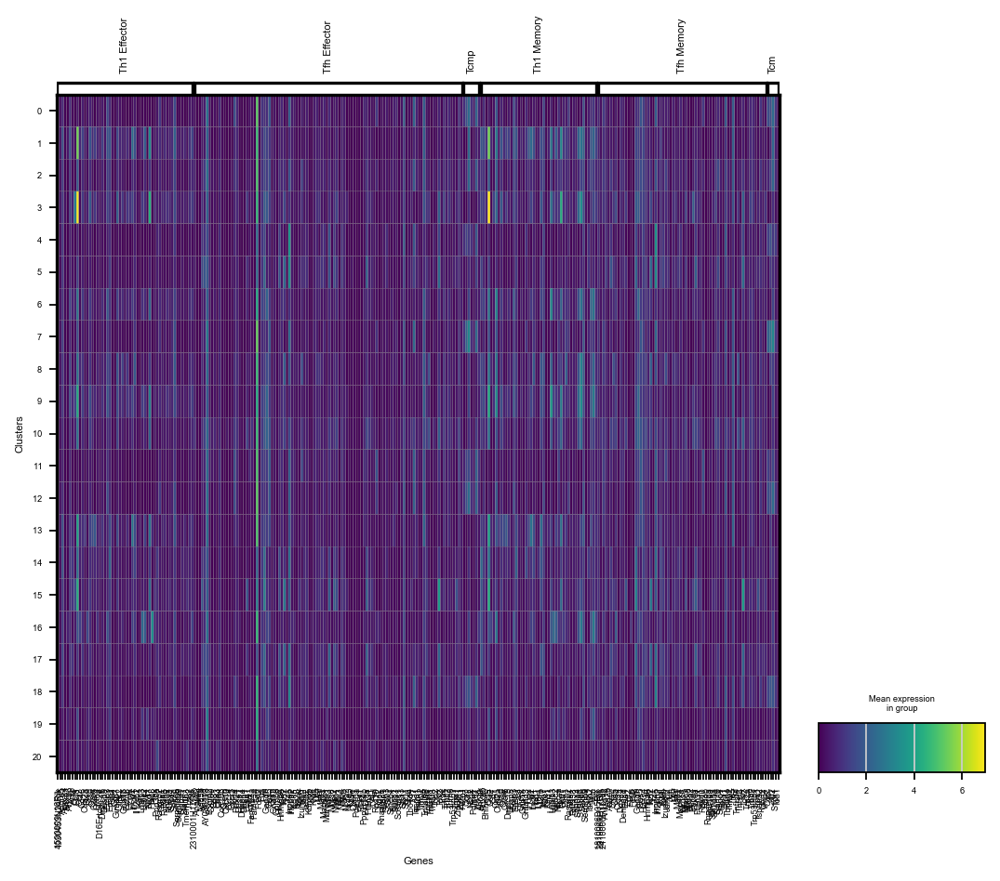

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 5)
ac = sc.pl.matrixplot(adata, genes, groupby = 'pheno_louvain_str', show = False, figsize = (8, 6))
ac['mainplot_ax'].set_xlabel('Genes')
ac['mainplot_ax'].set_ylabel('Clusters')

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarni

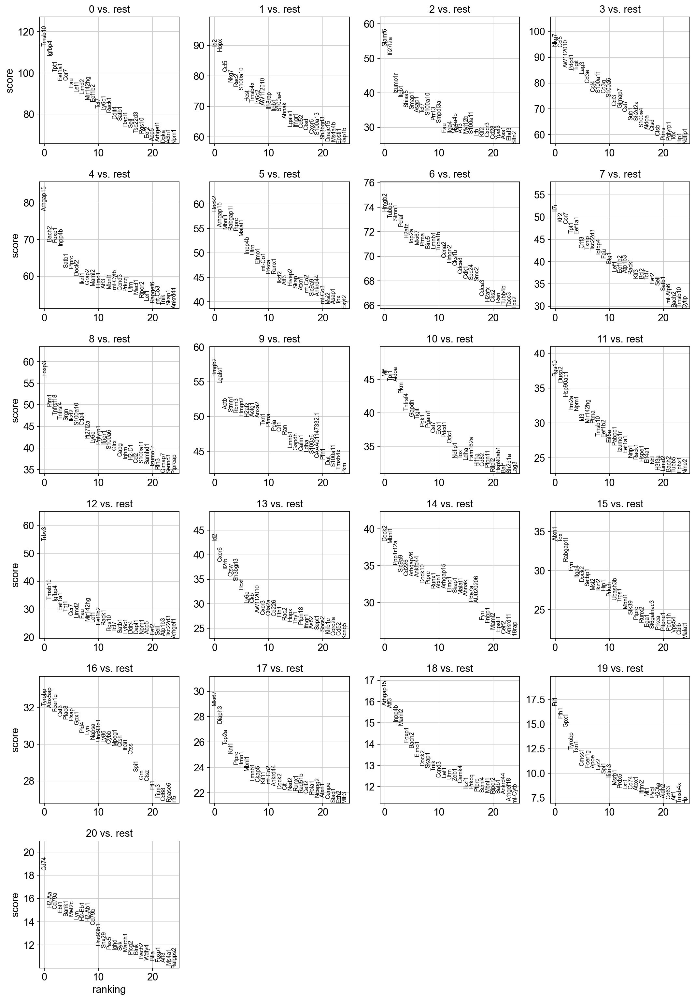

In [ ]:
sc.tl.rank_genes_groups(adata, 'pheno_louvain', method='wilcoxon', key_added = "wilcoxon")
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key="wilcoxon")

In [ ]:
adata

AnnData object with n_obs × n_vars = 44489 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'draw_graph', 'hash_colors', 'hvg', 'id_hvg', 'loadings', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'rank_genes_groups', 'umap', 'dendrogram_pheno_louvain', 'wilcoxon'
    obsm: 'X_draw_graph_fa', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'norm_counts', 'raw_data', 'zs_norm_log'
    obsp: 'neighbors_30_connectivities', 'neighbors_30_distances', 'pheno

In [ ]:
adata.obs['pheno_louvain_str'] = adata.obs['pheno_louvain'].astype('str')
adata

AnnData object with n_obs × n_vars = 44489 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'pheno_louvain_str'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'draw_graph', 'hash_colors', 'hvg', 'id_hvg', 'loadings', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'rank_genes_groups', 'umap', 'dendrogram_pheno_louvain', 'wilcoxon'
    obsm: 'X_draw_graph_fa', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'norm_counts', 'raw_data', 'zs_norm_log'
    obsp: 'neighbors_30_connectivities', 'neighbors_

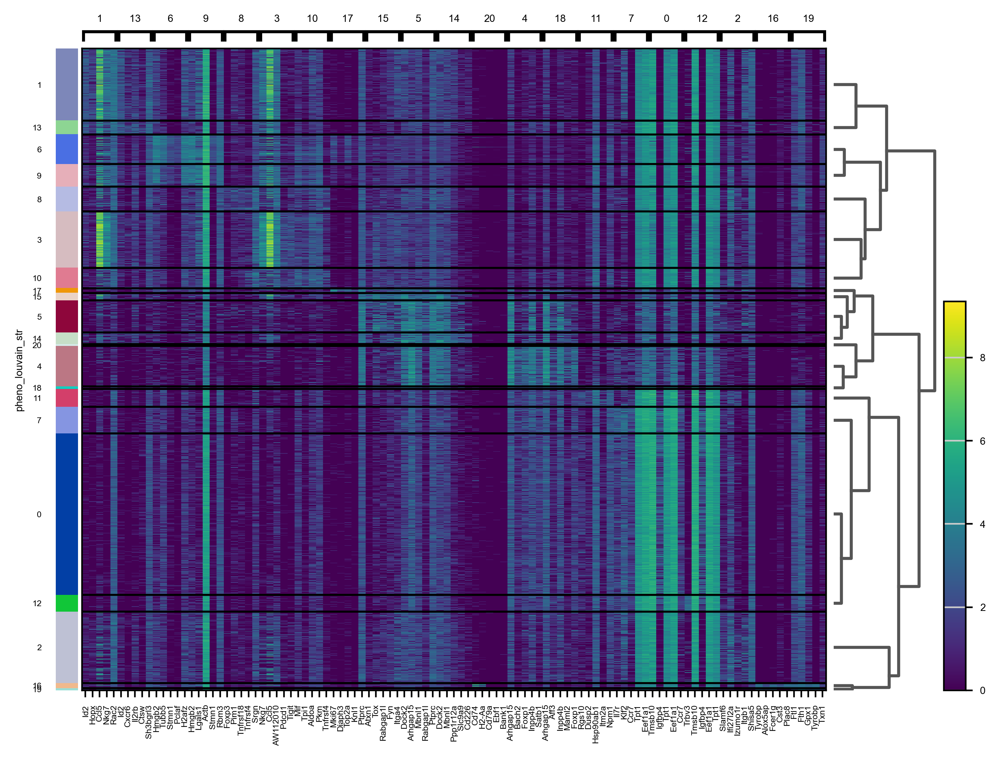

In [ ]:
sc.set_figure_params(scanpy=True, fontsize=5, figsize=(64, 24), dpi = 200)

# Call the plotting function with a custom figure size
ac = sc.pl.rank_genes_groups_heatmap(adata, n_genes=5, key="wilcoxon", groupby="pheno_louvain_str", show_gene_labels=True, figsize=(8, 6))


In [ ]:
adata

AnnData object with n_obs × n_vars = 44489 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'pheno_louvain_str', 'pheno_louvain_0.4', 'pheno_louvain_0.6', 'pheno_louvain_0.8', 'pheno_louvain_1.0'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'draw_graph', 'hash_colors', 'hvg', 'id_hvg', 'loadings', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'rank_genes_groups', 'umap', 'dendrogram_pheno_louvain', 'wilcoxon', 'pheno_louvain_str_colors', 'dendrogram_pheno_louvain_str'
    obsm: 'X_draw_graph_

In [ ]:
markers_dict = {'CD4_T': ['Cd3e', 'Cd4', 'Trac'],
                'Tfh':['Il21', 'Bcl6', 'Cxcr5', 'Izumo1r', 'Pdcd1'],
                'Treg':['Foxp3'],
                'ILTC': ['Fcer1r'],
                'B-cells': ['Ms4a1', 'Cd19', 'Ighd'],
                'Naive': ['Sell', 'Ccr7', 'Lef1', 'S1pr1'],
                'Memory':['Tcf7', 'Slamf6', 'Il7r'],
                'Activation': ['Cd69', 'Cd40lg'],
                'Th1': ['Tbx21', 'Prdm1', 'Runx3', 'Id2', 'Cxcr6', 'Ly6c2' 'Ifngr'],
                'Exhaustion':['Lag3','Havcr2','Ctla4', 'Cd244', 'Tigit', 'Tox', 'Maf'],
                'Cytotoxicity': ['GzmB', 'Gzmk', 'Eomes'],
                'Effector':['Tnfrsf18', 'Tnfrsf4', 'Ifng', 'Il2', 'Il18'],
                'Proliferation': ['Mki67']
               }

In [ ]:
ALLMARKERS = []
for key, value in markers_dict.items():
    markers_dict[key] = [j for j in value if j in adata.var_names]
    ALLMARKERS = ALLMARKERS + [j for j in markers_dict[key]]

In [ ]:
# get some color palette
cols = sc.pl.palettes.godsnot_102

celltype_col = []
ct = 0
for key, value in markers_dict.items():
    celltype_col = celltype_col + [cols[ct]]*len(value)
    ct = ct + 1

In [ ]:
sub_data = adata.X[:, [adata.var_names.get_loc(j) for j in ALLMARKERS]]
sub_data = pd.DataFrame(sub_data, columns = ALLMARKERS, index = adata.obs_names)
sub_data['Cluster'] = adata.obs['pheno_louvain']

In [ ]:
sub_data_avg = sub_data.groupby('Cluster').mean()
sub_data_avg.shape

(21, 40)

In [ ]:
# dictionary mapping Leiden cluster labels to annotations
cluster_annotation_mapping = {
    '0': 'Naive', #
    '1': 'Activated', #Th1
    '2': 'Early_activation', # mixed Th1, Tfh, memory
    '3': 'Highper_activated_Th1', #
    '4': 'Memory', #highest Bcl2, S1pr1, no Tfh Th1 
    '5': 'Tfh_memory', #
    '6': 'Proliferating', #
    '7': 'Naive', #
    '8': 'Treg', #
    '9': 'Proliferating_Th1', #
    '10': 'Tfh', #
    '11': 'Naive', #
    '12': 'Naive', #
    '13': 'Activated', #Th1
    '14': 'Th1_memory',#
    '15': 'Highper_activated_Th1',#
    '16': 'ILTC', #
    '17': 'Proliferating', #
    '18': 'Tfh_memory', #
    '19': 'ILTC',
    '20': 'B_cells' #
}

# Map the Leiden cluster labels to the annotations using the dictionary
adata.obs['annotation_v1'] = adata.obs['pheno_louvain_str'].map(cluster_annotation_mapping)

In [ ]:
print(adata.obs['annotation_v1'].unique())

['Naive' 'Early_activation' 'Memory' 'ILTC' 'B_cells' 'Proliferating'
 'Tfh_memory' 'Treg' 'Proliferating_Th1' 'Activated' 'Tfh' 'Th1_memory'
 'Highper_activated_Th1']


/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


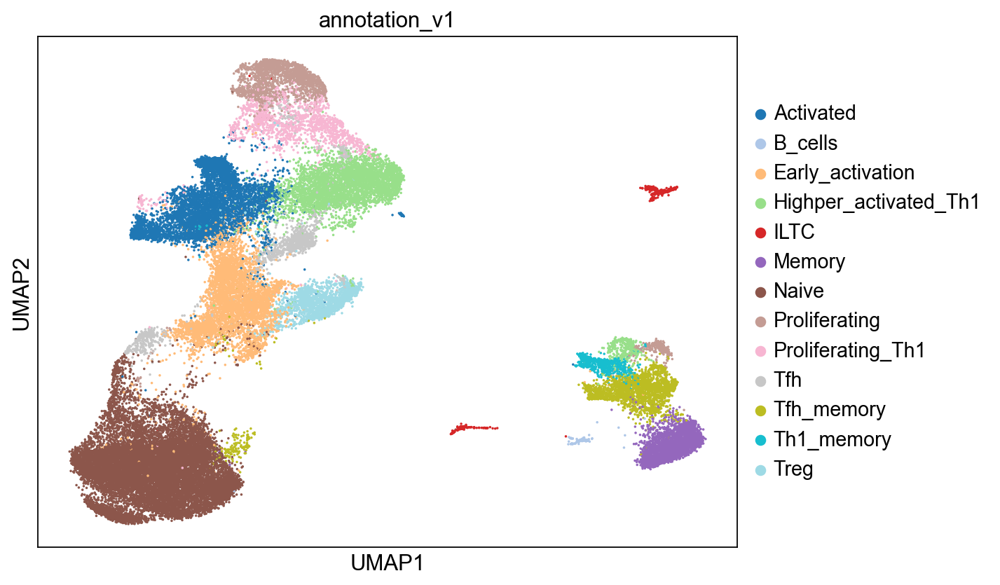

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14, figsize = (8, 6))
sc.pl.umap(adata, color = 'annotation_v1', s = 10, palette = 'tab20', ncols = 1)

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


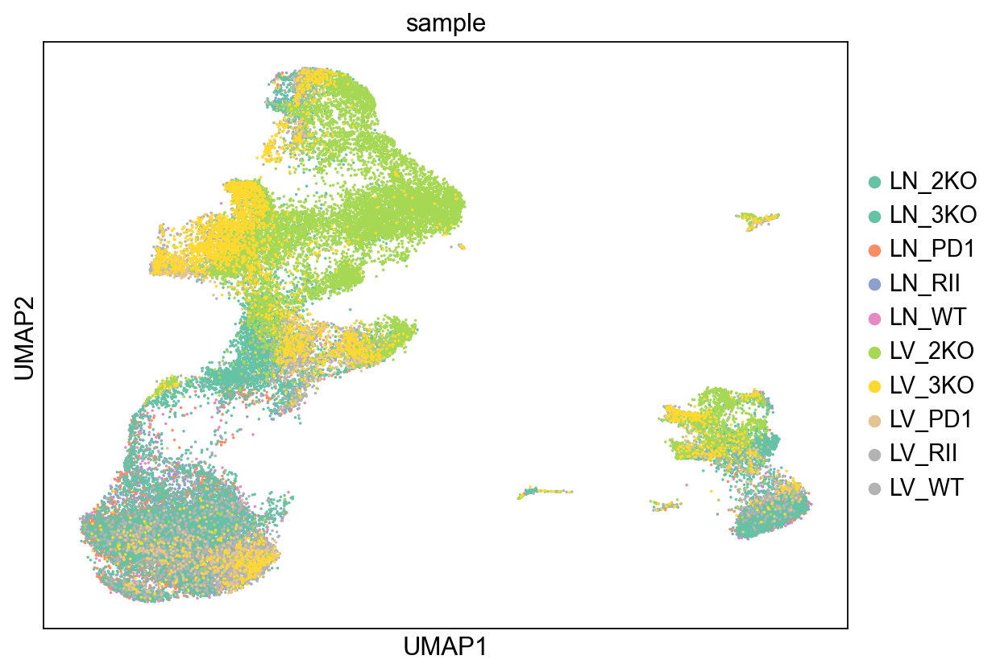

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14, figsize = (8, 6))
sc.pl.umap(adata, color = 'sample', s = 10, palette = 'Set2', ncols = 1)

In [ ]:
adata

AnnData object with n_obs × n_vars = 44489 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'pheno_louvain_str', 'pheno_louvain_0.4', 'pheno_louvain_0.6', 'pheno_louvain_0.8', 'pheno_louvain_1.0', 'annotation', 'annotation_v1'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'draw_graph', 'hash_colors', 'hvg', 'id_hvg', 'loadings', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'rank_genes_groups', 'umap', 'dendrogram_pheno_louvain', 'wilcoxon', 'pheno_louvain_str_colors', 'dendrogram_pheno_louvai

In [ ]:
adata.write_h5ad('normalized_gex_all_ranked_sample_annotated_v1.h5ad')

#### MAST comparing 2KO and 3KO, vacalno plot and GSEA plot: analysis_v3
In R

#### Milo
calling R from python environment

In [ ]:
adata = sc.read_h5ad('normalized_gex_all_ranked_sample_annotated_v1.h5ad')

In [ ]:
from sklearn.decomposition import PCA
#cols = utils.get_color_pal(100)
from matplotlib.cm import get_cmap
cols_use = get_cmap('tab20').colors

/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_1434/761151681.py:4: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cols_use = get_cmap('tab20').colors


##### take a look

In [ ]:
adata

AnnData object with n_obs × n_vars = 44489 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'pheno_louvain_str', 'pheno_louvain_0.4', 'pheno_louvain_0.6', 'pheno_louvain_0.8', 'pheno_louvain_1.0', 'annotation', 'annotation_v1', 'organ', 'sample', 'genotype'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'dendrogram_pheno_louvain', 'dendrogram_pheno_louvain_str', 'draw_graph', 'hash_colors', 'hvg', 'id_hvg', 'loadings', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'pheno_louvain_str_colors', 'r

In [ ]:
print(adata.obs['sample'].unique())

['LN_WT', 'LN_RII', 'LN_PD1', 'LN_2KO', 'LN_3KO', 'LV_WT', 'LV_RII', 'LV_PD1', 'LV_2KO', 'LV_3KO']
Categories (10, object): ['LN_2KO', 'LN_3KO', 'LN_PD1', 'LN_RII', ..., 'LV_3KO', 'LV_PD1', 'LV_RII', 'LV_WT']


In [ ]:
print(adata.obs['annotation_v1'].unique())

['Naive', 'Early_activation', 'Memory', 'ILTC', 'B_cells', ..., 'Proliferating_Th1', 'Activated', 'Tfh', 'Th1_memory', 'Highper_activated_Th1']
Length: 13
Categories (13, object): ['Activated', 'B_cells', 'Early_activation', 'Highper_activated_Th1', ..., 'Tfh', 'Tfh_memory', 'Th1_memory', 'Treg']


In [ ]:
df_temp = pd.DataFrame({'umap_x': adata.obsm['X_umap'][:, 0], 'umap_y': adata.obsm['X_umap'][:, 1], 
                        'sample': adata.obs['sample']}, index = adata.obs.index)

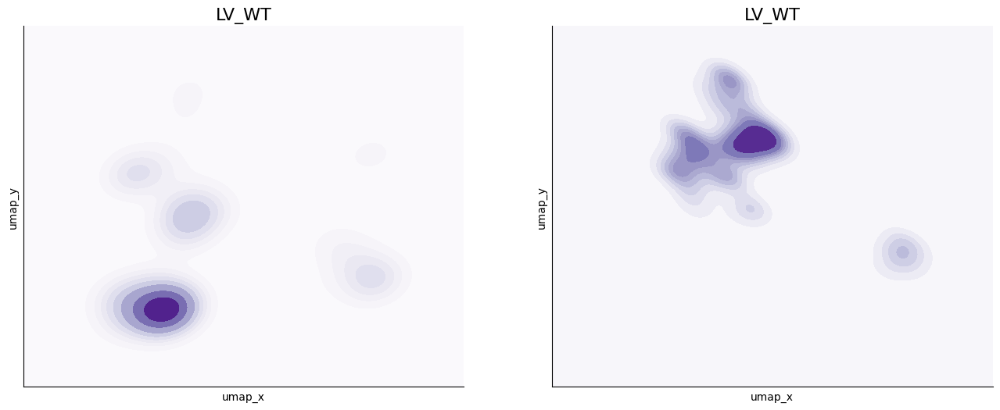

In [ ]:
import seaborn as sns
fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 2, 1)
sns.scatterplot(data = df_temp, x = 'umap_x', y = 'umap_y', s = 1, ax = ax)
sns.kdeplot(data=df_temp[df_temp['sample'] == 'LV_WT'], x="umap_x", y="umap_y",
    fill=True, thresh=0, levels=10, cmap="Purples", ax = ax, cut = 4)
ax.set_xticks([]);
ax.set_yticks([]);
ax.set_title('LV_WT', fontsize = 16)
ax.set_xlabel('umap_x')
ax.set_ylabel('umap_y')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

ax = fig.add_subplot(1, 2, 2)
sns.scatterplot(data = df_temp, x = 'umap_x', y = 'umap_y', s = 1, ax = ax)
sns.kdeplot(data=df_temp[df_temp['sample'] == 'LV_2KO'], x="umap_x", y="umap_y",
    fill=True, thresh=0, levels=10, cmap="Purples", ax = ax, cut = 4)
ax.set_xticks([]);
ax.set_yticks([]);
ax.set_title('LV_WT', fontsize = 16)
ax.set_xlabel('umap_x')
ax.set_ylabel('umap_y')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
#fig.savefig(outbase + 'Ctrl_DT_kdeplot_endo.png', dpi = 150, bbox_inches = 'tight')

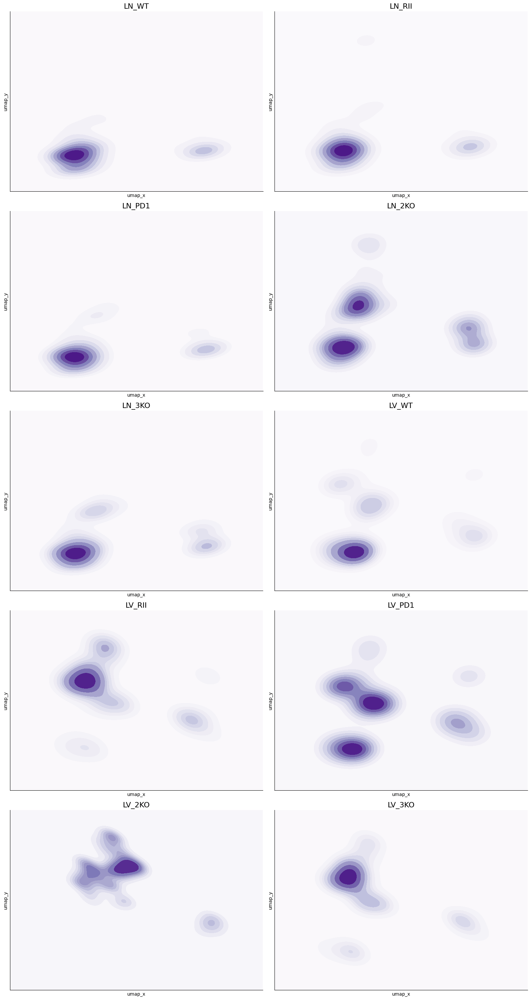

In [ ]:
unique_samples = adata.obs['sample'].unique()
nrows = 5
ncols = 2
#fig, axs = plt.subplots(nrows, ncols, figsize = (8*ncols, 6*nrows))
#axs = axs.flatten()  # Flatten to easily iterate over
fig = plt.figure(figsize = (8*ncols, 6*nrows))

for i, sample in enumerate(unique_samples):
    ax = fig.add_subplot(nrows, ncols, i+1)
    sns.scatterplot(data = df_temp, x = 'umap_x', y = 'umap_y', s = 1, ax = ax)
    sns.kdeplot(data=df_temp[df_temp['sample'] == sample], x="umap_x", y="umap_y",
        fill=True, thresh=0, levels=10, cmap="Purples", ax = ax, cut = 4)
    ax.set_xticks([]);
    ax.set_yticks([]);
    ax.set_title(sample, fontsize = 16)
    ax.set_xlabel('umap_x')
    ax.set_ylabel('umap_y')
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

plt.tight_layout()
plt.show()

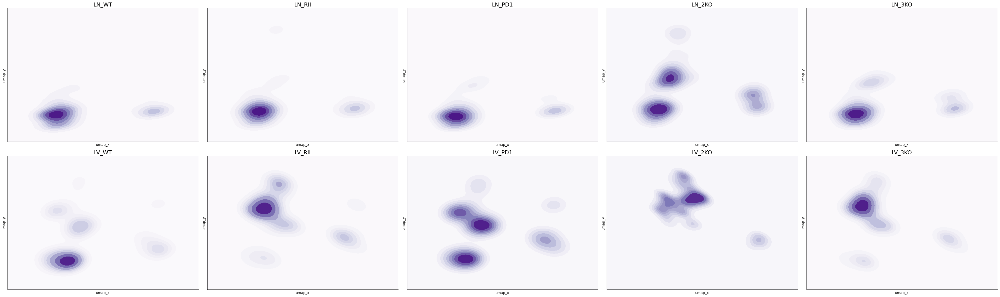

In [ ]:
unique_samples = adata.obs['sample'].unique()
nrows = 2
ncols = 5
#fig, axs = plt.subplots(nrows, ncols, figsize = (8*ncols, 6*nrows))
#axs = axs.flatten()  # Flatten to easily iterate over
fig = plt.figure(figsize = (8*ncols, 6*nrows))

for i, sample in enumerate(unique_samples):
    ax = fig.add_subplot(nrows, ncols, i+1)
    sns.scatterplot(data = df_temp, x = 'umap_x', y = 'umap_y', s = 1, ax = ax)
    sns.kdeplot(data=df_temp[df_temp['sample'] == sample], x="umap_x", y="umap_y",
        fill=True, thresh=0, levels=10, cmap="Purples", ax = ax, cut = 4)
    ax.set_xticks([]);
    ax.set_yticks([]);
    ax.set_title(sample, fontsize = 16)
    ax.set_xlabel('umap_x')
    ax.set_ylabel('umap_y')
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

plt.tight_layout()
plt.show()

In [ ]:
adata

AnnData object with n_obs × n_vars = 44489 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'pheno_louvain_str', 'pheno_louvain_0.4', 'pheno_louvain_0.6', 'pheno_louvain_0.8', 'pheno_louvain_1.0', 'annotation', 'annotation_v1', 'organ', 'sample', 'genotype'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'dendrogram_pheno_louvain', 'dendrogram_pheno_louvain_str', 'draw_graph', 'hash_colors', 'hvg', 'id_hvg', 'loadings', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'pheno_louvain_str_colors', 'r

In [ ]:
# Object for Milo
adata_milo = sc.AnnData(adata.X.copy(), 
                        obs = adata.obs[['sample', 'pheno_louvain_str', 'organ', 'genotype', 'annotation_v1']], 
                        var = adata.var)
adata_milo.obsm['X_pca'] = adata.obsm['X_pca']
adata_milo.obsm['X_umap'] = adata.obsm['X_umap']

In [ ]:
adata_milo.obs['sample_']= adata_milo.obs['sample']

In [ ]:
adata_milo.write('intermediate/adata_milo_v1.h5ad')

##### set up in R

In [ ]:
#py3.8
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc
import anndata
import scipy

In [ ]:
adata_milo = sc.read_h5ad('intermediate/adata_milo_v1.h5ad')

In [ ]:
adata_milo.obs['sample_']

AAACCTGAGTGTGAAT-1     LN_WT
AAACCTGCAAATTGCC-1     LN_WT
AAACCTGGTACATGTC-1     LN_WT
AAACCTGGTACGCTGC-1     LN_WT
AAACCTGTCCAAGTAC-1     LN_WT
                       ...  
TTTGGTTGTTCCCTTG-1    LV_3KO
TTTGGTTGTTGAACTC-1    LV_3KO
TTTGTCACACCGGAAA-1    LV_3KO
TTTGTCAGTATGAAAC-1    LV_3KO
TTTGTCATCAAACGGG-1    LV_3KO
Name: sample_, Length: 44489, dtype: category
Categories (10, object): ['LN_2KO', 'LN_3KO', 'LN_PD1', 'LN_RII', ..., 'LV_3KO', 'LV_PD1', 'LV_RII', 'LV_WT']

In [ ]:
# Check for NA values in 'col1'
has_na = pd.isna(adata_milo.obs['sample_']).any()
has_na

False

In [ ]:
# set up for MiloR
import os
os.environ['R_HOME'] = '/Library/Frameworks/R.framework/Resources'
os.environ['R_USER'] = '/Library/Frameworks/R.framework/Versions/4.3-x86_64/Resources/library'

import rpy2
import anndata2ri

# anndata2ri interconverts AnnData and Single Cell Experiment objects
anndata2ri.activate()
#%load_ext rpy2.ipython
%reload_ext rpy2.ipython

In [ ]:
%%R
library(miloR)
library(igraph)

R[write to console]: Loading required package: edgeR

R[write to console]: Loading required package: limma

R[write to console]: 
Attaching package: ‘igraph’


R[write to console]: The following object is masked from ‘package:miloR’:

    graph


R[write to console]: The following objects are masked from ‘package:stats’:

    decompose, spectrum


R[write to console]: The following object is masked from ‘package:base’:

    union




In [ ]:
adata_milo.obs[['sample', 'pheno_louvain_str', 'organ', 'genotype', 'annotation_v1', 
                'sample_']] = adata_milo.obs[['sample', 'pheno_louvain_str', 'organ', 'genotype', 'annotation_v1','sample_']].astype(str)

In [ ]:
%%R -i adata_milo
save(adata_milo, file = "intermediate/adata_milo_v1.RData")

# the anndata2ri packages will convert the anndata object into SingleCellExperiment object 
# (for more details see here: https://bioconductor.org/packages/release/bioc/html/SingleCellExperiment.html)
# kernel migth die, be prepared

In [ ]:
%%R 
r_milo <- Milo(adata_milo) # convert to a Milo object
r_milo

class: Milo 
dim: 16096 44489 
metadata(0):
assays(1): X
rownames(16096): Xkr4 Mrpl15 ... CAAA01147332.1 AC149090.1
rowData names(12): n_cells_by_counts mean_counts ... variances
  variances_norm
colnames(44489): AAACCTGAGTGTGAAT-1 AAACCTGCAAATTGCC-1 ...
  TTTGTCAGTATGAAAC-1 TTTGTCATCAAACGGG-1
colData names(6): sample pheno_louvain_str ... annotation_v1 sample_
reducedDimNames(2): PCA UMAP
mainExpName: NULL
altExpNames(0):
nhoods dimensions(2): 1 1
nhoodCounts dimensions(2): 1 1
nhoodDistances dimension(1): 0
graph names(0):
nhoodIndex names(1): 0
nhoodExpression dimension(2): 1 1
nhoodReducedDim names(0):
nhoodGraph names(0):
nhoodAdjacency dimension(2): 1 1


In [ ]:
%%R 
r_milo <- buildGraph(r_milo, k=30, d=30, reduced.dim = "PCA") # build a graph in the milo object

R[write to console]: Constructing kNN graph with k:30



In [ ]:
%%R 
## Define neighbourhoods
r_milo <- makeNhoods(r_milo, prop = 0.05, k = 30, d=30, refined = TRUE, reduced_dims = "PCA")

## Count cells in neighbourhoods
r_milo <- countCells(r_milo, meta.data = data.frame(colData(r_milo)), sample="sample")

## Calculate distances between cells in neighbourhoods
## for spatial FDR correction
r_milo <- calcNhoodDistance(r_milo, d=30, reduced.dim = "PCA")

R[write to console]: Checking valid object

R[write to console]: Running refined sampling with reduced_dim

R[write to console]: Checking meta.data validity

R[write to console]: Counting cells in neighbourhoods

R[write to console]: 'as(<dgTMatrix>, "dgCMatrix")' is deprecated.
Use 'as(., "CsparseMatrix")' instead.
See help("Deprecated") and help("Matrix-deprecated").



##### 2KO vs 3KO

In [ ]:
#design matrix
design_df = adata_milo.obs[["genotype", "sample"]].copy()
design_df.drop_duplicates(inplace=True)
design_df.index = design_df['sample']
design_df

,genotype,sample
sample,,
LN_WT,WT,LN_WT
LN_RII,RII,LN_RII
LN_PD1,PD1,LN_PD1
LN_2KO,2KO,LN_2KO
LN_3KO,3KO,LN_3KO
LV_WT,WT,LV_WT
LV_RII,RII,LV_RII
LV_PD1,PD1,LV_PD1
LV_2KO,2KO,LV_2KO


In [ ]:
%%R -i design_df -o DA_results
contrast.1 <- c("genotype2KO - genotype3KO")

## Test for differential abundance
DA_results <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")

# https://rdrr.io/github/MarioniLab/miloR/man/testNhoods.html
# https://bioconductor.org/packages/release/bioc/vignettes/miloR/inst/doc/milo_contrasts.html

R[write to console]: Using TMM normalisation



R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



In [ ]:
%%R
table(DA_results$SpatialFDR < 0.4)


FALSE  TRUE 
 1632   261 


In [ ]:
%%R
r_milo <- buildNhoodGraph(r_milo)

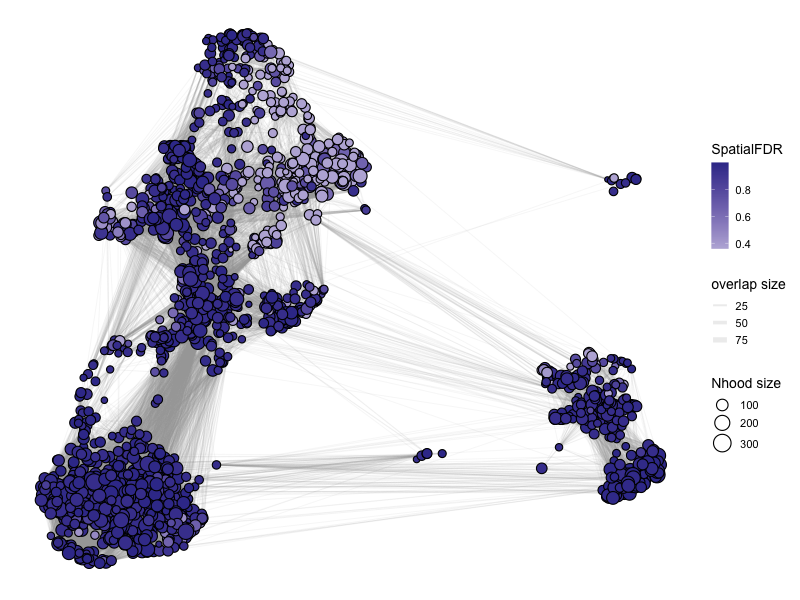

In [ ]:
%%R -w 800 -h 600
alpha_val = 1
library(ggplot2)
p1 <- plotNhoodGraphDA(r_milo, DA_results, res_column = 'SpatialFDR', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
p1

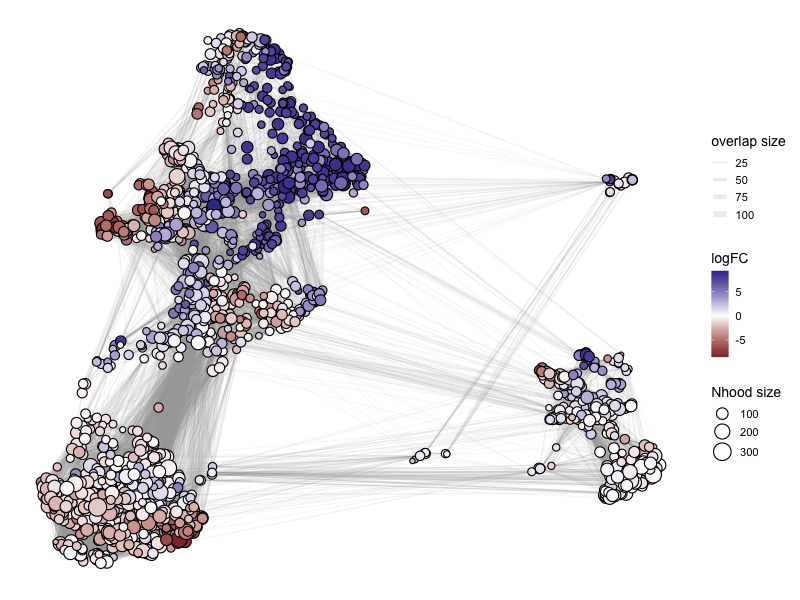

In [ ]:
%%R -w 800 -h 600
alpha_val = 1
library(ggplot2)
p1 <- plotNhoodGraphDA(r_milo, DA_results, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
p1

In [ ]:
%%R 
DA_results <- annotateNhoods(r_milo, DA_results, coldata_col = "annotation_v1")
head(DA_results)

R[write to console]: Converting annotation_v1 to factor...



        logFC   logCPM            F     PValue       FDR Nhood SpatialFDR
1  0.24145138 9.129662 6.443992e-03 0.93602065 0.9994587     1  0.9983706
2  7.83739198 9.008214 3.721621e+00 0.05374206 0.5176625     2  0.3740386
3 -0.54951576 8.835404 3.580002e-02 0.84993312 0.9994587     3  0.9960813
4  0.01841475 9.684184 3.958656e-05 0.99498005 0.9994587     4  0.9996562
5  3.47579046 9.280402 1.042039e+00 0.30737374 0.9994587     5  0.8560979
6  8.17193723 9.261216 3.788058e+00 0.05164904 0.5176625     6  0.3740386
          annotation_v1 annotation_v1_fraction
1                Memory              1.0000000
2 Highper_activated_Th1              1.0000000
3                 Naive              1.0000000
4                  Treg              0.5625000
5             Activated              0.9882353
6 Highper_activated_Th1              0.7093023


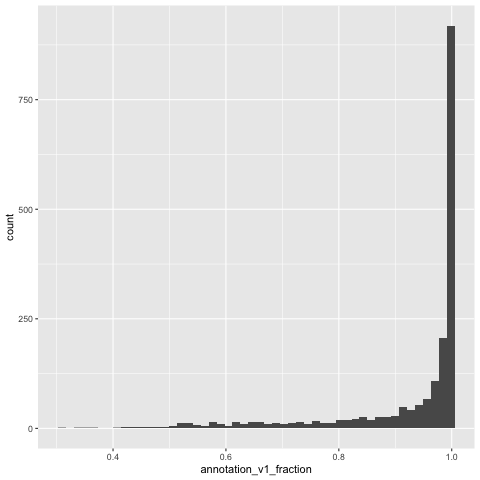

In [ ]:
%%R
library(ggplot2)
ggplot(DA_results, aes(annotation_v1_fraction)) + geom_histogram(bins=50)

In [ ]:
%%R -o DA_results
DA_results$annotation <- ifelse(DA_results$annotation_v1_fraction < 0.6, "Mixed", DA_results$annotation_v1)
head(DA_results)

        logFC   logCPM            F     PValue       FDR Nhood SpatialFDR
1  0.24145138 9.129662 6.443992e-03 0.93602065 0.9994587     1  0.9983706
2  7.83739198 9.008214 3.721621e+00 0.05374206 0.5176625     2  0.3740386
3 -0.54951576 8.835404 3.580002e-02 0.84993312 0.9994587     3  0.9960813
4  0.01841475 9.684184 3.958656e-05 0.99498005 0.9994587     4  0.9996562
5  3.47579046 9.280402 1.042039e+00 0.30737374 0.9994587     5  0.8560979
6  8.17193723 9.261216 3.788058e+00 0.05164904 0.5176625     6  0.3740386
          annotation_v1 annotation_v1_fraction            annotation
1                Memory              1.0000000                Memory
2 Highper_activated_Th1              1.0000000 Highper_activated_Th1
3                 Naive              1.0000000                 Naive
4                  Treg              0.5625000                 Mixed
5             Activated              0.9882353             Activated
6 Highper_activated_Th1              0.7093023 Highper_activated_Th1

R[write to console]: Converting group_by to factor...



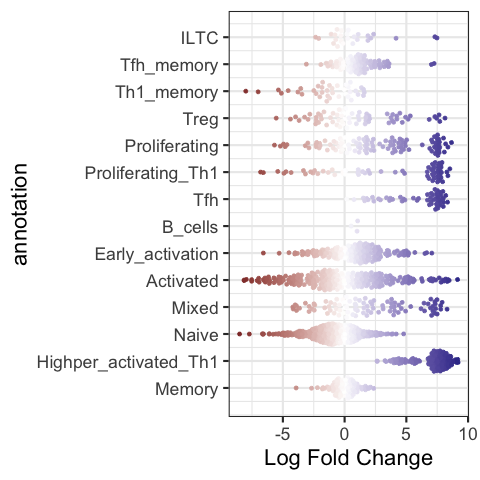

In [ ]:
%%R
plotDAbeeswarm(DA_results, group.by = "annotation", alpha = 1)

/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/2593296851.py:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticks(), fontsize = 18)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/2593296851.py:15: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize = 18)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/2593296851.py:31: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = fig.colorbar(scalarmappaple)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/2593296851.py:33: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.ax.set_yt

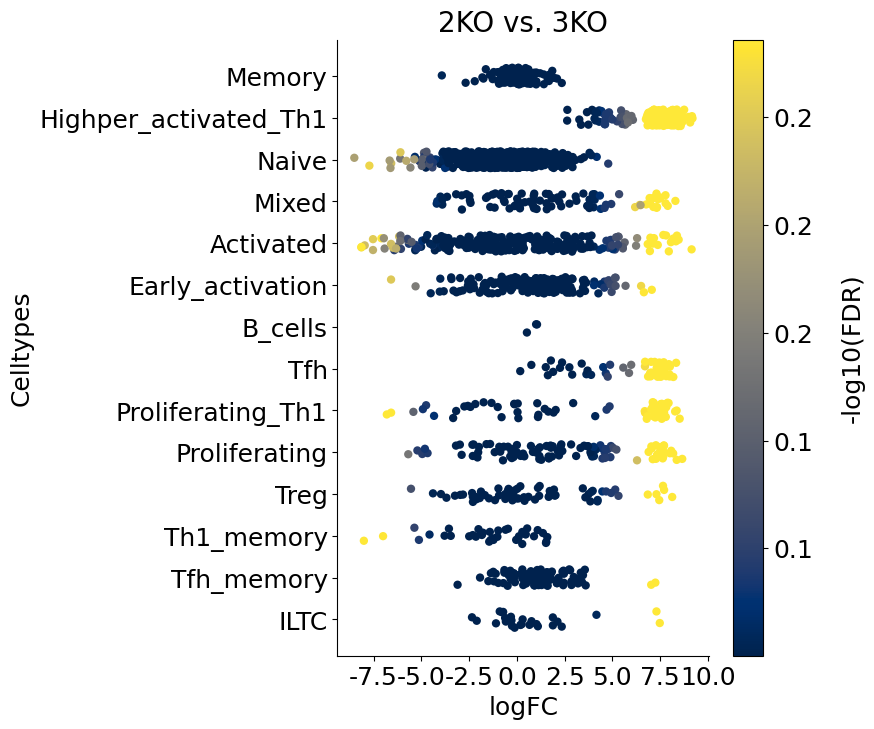

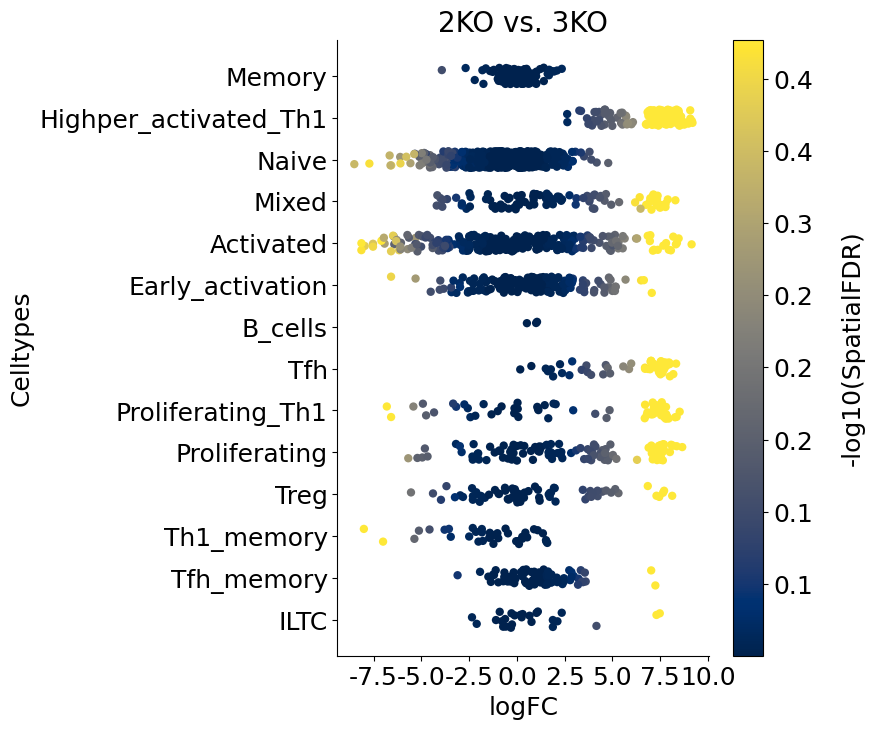

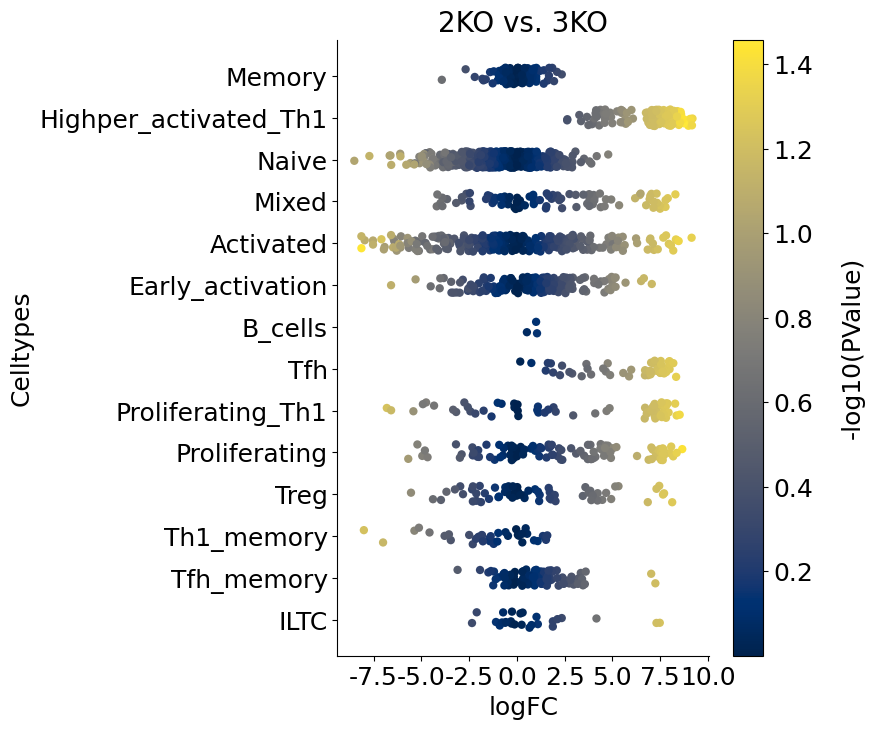

In [ ]:
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import seaborn as sns

for j, item in enumerate(['FDR', 'SpatialFDR', 'PValue']):
    fig = plt.figure(figsize = (6, 8))
    DA_results['log_' + item] = -np.log10(DA_results[item])
    ax = fig.add_subplot(1, 1, 1)
    plt.title('2KO vs. 3KO', fontsize=20)
    plot = sns.stripplot(x='logFC', y='annotation', hue='log_' + item, data=DA_results, size = 6, 
              palette='cividis', 
              jitter=0.2, edgecolor='none', ax = ax)
    plot.get_legend().set_visible(False)
    ax.set_xticklabels(ax.get_xticks(), fontsize = 18)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize = 18)
    ax.set_ylabel('Celltypes', fontsize = 18)
    ax.set_xlabel('logFC', fontsize = 18)
    sns.despine()

    # Drawing the side color bar
    normalize = mcolors.Normalize(vmin=DA_results['log_' + item].min(), 
                              vmax=DA_results['log_' + item].max())
    colormap = cm.cividis

    for n in DA_results['log_' + item]:
        plt.plot(color=colormap(normalize(n)))

    scalarmappaple = cm.ScalarMappable(norm=normalize, cmap=colormap)
    scalarmappaple.set_array(DA_results['log_' + item])
    cbar = fig.colorbar(scalarmappaple)
    ticks = cbar.ax.get_yticks()
    cbar.ax.set_yticklabels(['{:.1f}'.format(tick) for tick in ticks], fontsize=18)
    cbar.ax.set_ylabel('-log10(' + item + ')',  labelpad = 20, rotation=90, fontsize = 18)
    ax.grid(False)
    #fig.savefig(outbase + 'milor_endothelial_swarmplot_new_colored_by_log_' + item + '_july13.pdf', dpi = 300, bbox_inches = 'tight')

##### 2KO vs RII

In [ ]:
%%R -i design_df -o DA_results
contrast.1 <- c("genotype2KO - genotypeRII")

## Test for differential abundance
DA_results <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")

# https://rdrr.io/github/MarioniLab/miloR/man/testNhoods.html
# https://bioconductor.org/packages/release/bioc/vignettes/miloR/inst/doc/milo_contrasts.html

R[write to console]: Using TMM normalisation



R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



In [ ]:
%%R
r_milo <- buildNhoodGraph(r_milo)

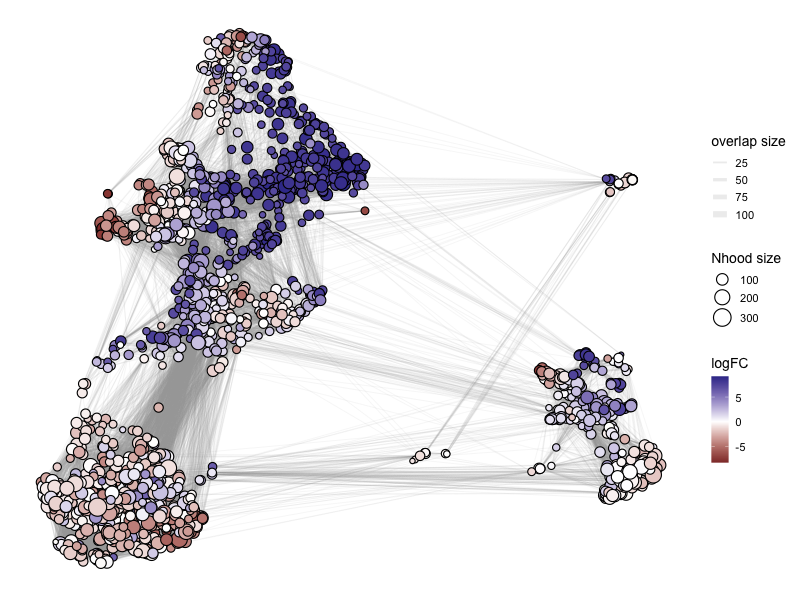

In [ ]:
%%R -w 800 -h 600
alpha_val = 1
library(ggplot2)
p1 <- plotNhoodGraphDA(r_milo, DA_results, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
p1

In [ ]:
%%R 
DA_results <- annotateNhoods(r_milo, DA_results, coldata_col = "annotation_v1")

R[write to console]: Converting annotation_v1 to factor...



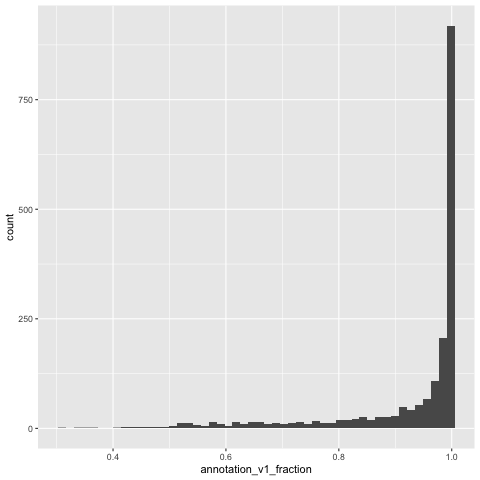

In [ ]:
%%R
library(ggplot2)
ggplot(DA_results, aes(annotation_v1_fraction)) + geom_histogram(bins=50)

In [ ]:
%%R -o DA_results
DA_results$annotation <- ifelse(DA_results$annotation_v1_fraction < 0.6, "Mixed", DA_results$annotation_v1)
head(DA_results)

        logFC   logCPM            F     PValue       FDR Nhood SpatialFDR
1 -1.04715610 9.129662 0.1201967900 0.72882886 0.9941020     1  0.9585737
2  7.83739198 9.008214 3.3311923911 0.06800908 0.4739998     2  0.3590204
3  5.54360477 8.835404 1.9718175355 0.16028788 0.7207244     3  0.5411701
4  0.06494043 9.684184 0.0004833422 0.98246035 1.0000000     4  0.9992671
5  4.71464410 9.280402 1.6310073053 0.20159511 0.8343339     5  0.6518054
6  8.17193723 9.261216 3.4150311292 0.06463637 0.4739998     6  0.3590204
          annotation_v1 annotation_v1_fraction            annotation
1                Memory              1.0000000                Memory
2 Highper_activated_Th1              1.0000000 Highper_activated_Th1
3                 Naive              1.0000000                 Naive
4                  Treg              0.5625000                 Mixed
5             Activated              0.9882353             Activated
6 Highper_activated_Th1              0.7093023 Highper_activated_Th1

R[write to console]: Converting group_by to factor...



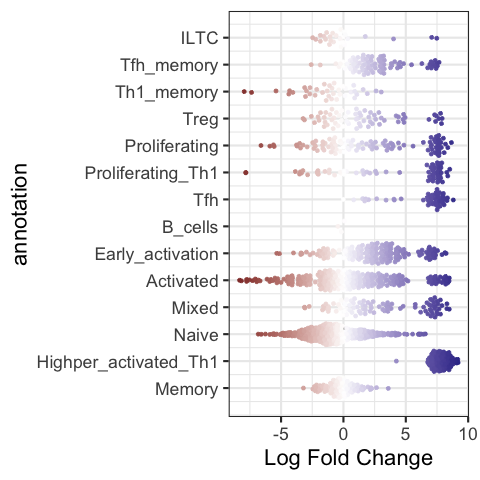

In [ ]:
%%R
plotDAbeeswarm(DA_results, group.by = "annotation", alpha = 1)

/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/1968502715.py:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticks(), fontsize = 18)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/1968502715.py:15: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize = 18)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/1968502715.py:30: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = fig.colorbar(scalarmappaple)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/1968502715.py:32: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.ax.set_yt

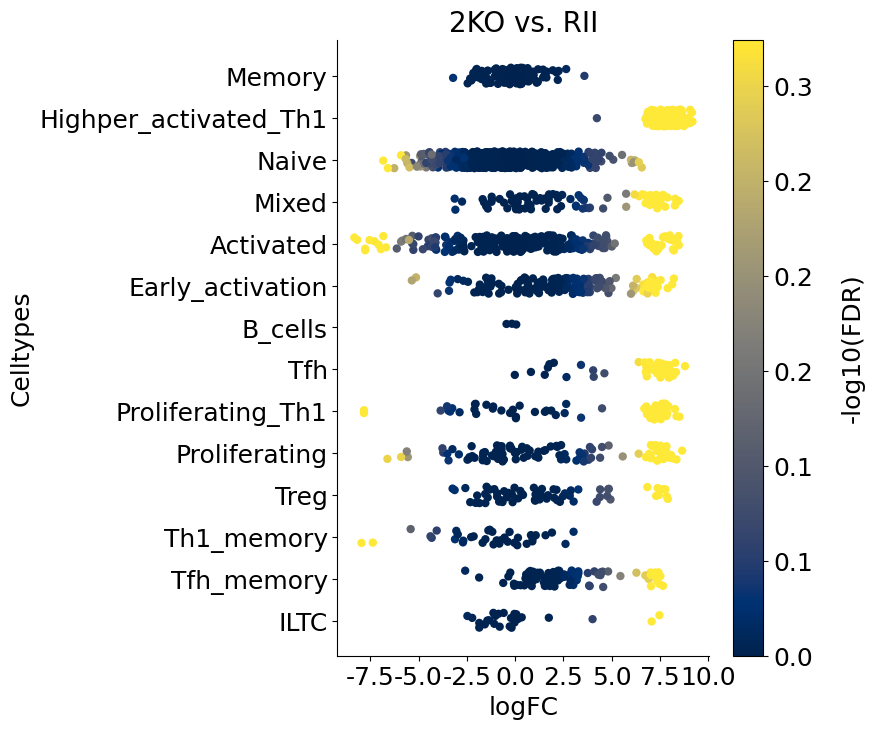

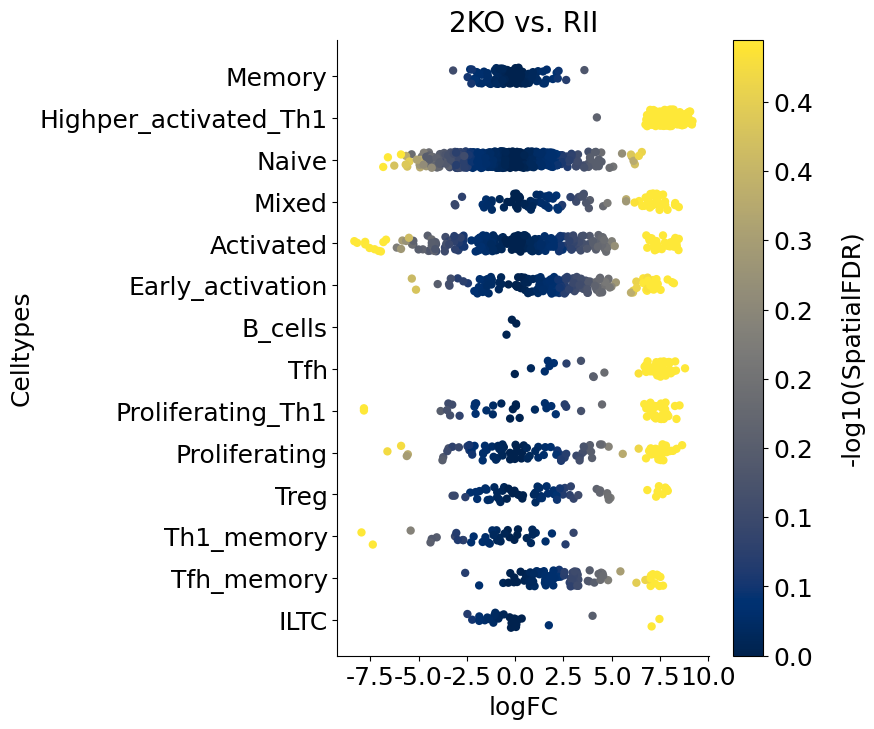

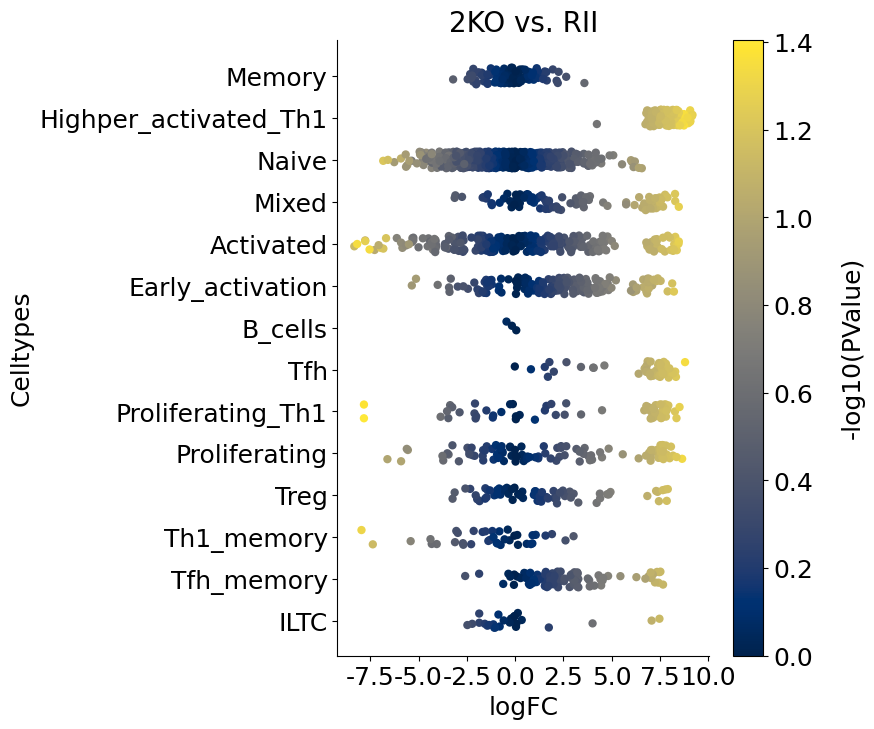

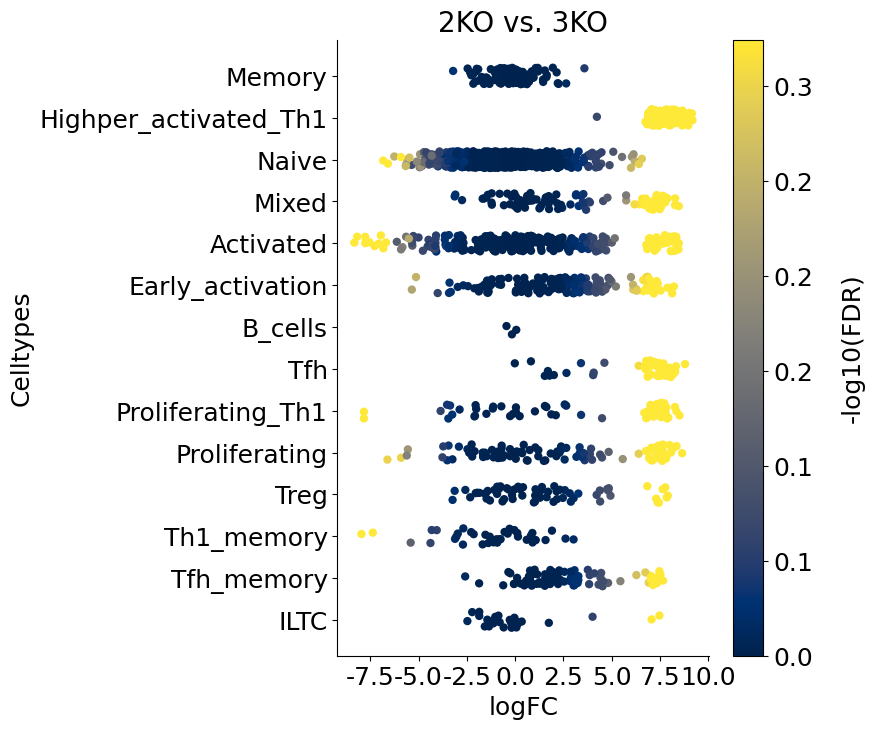

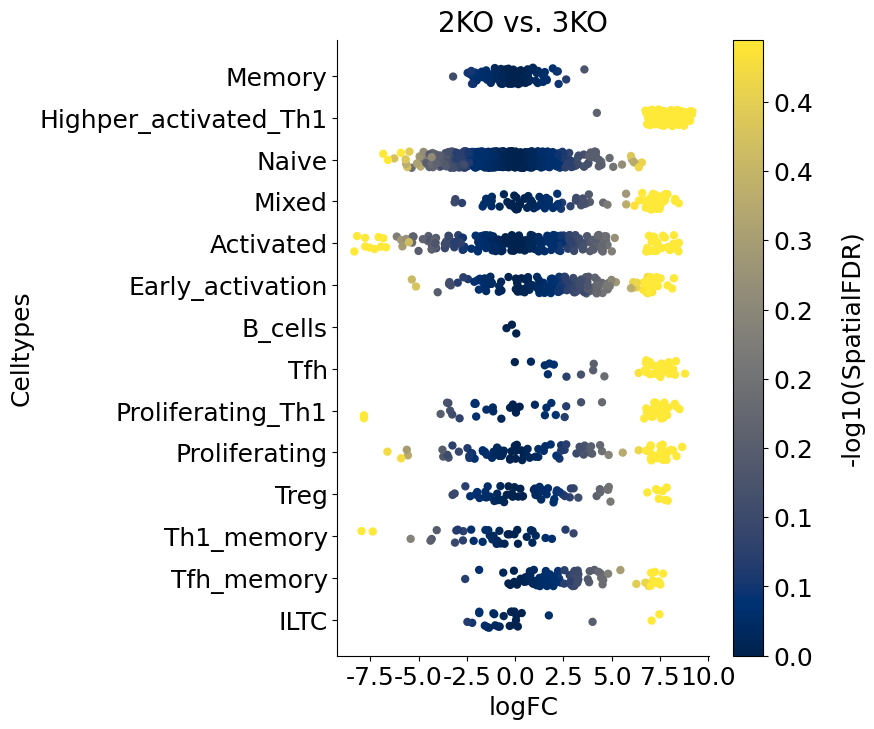

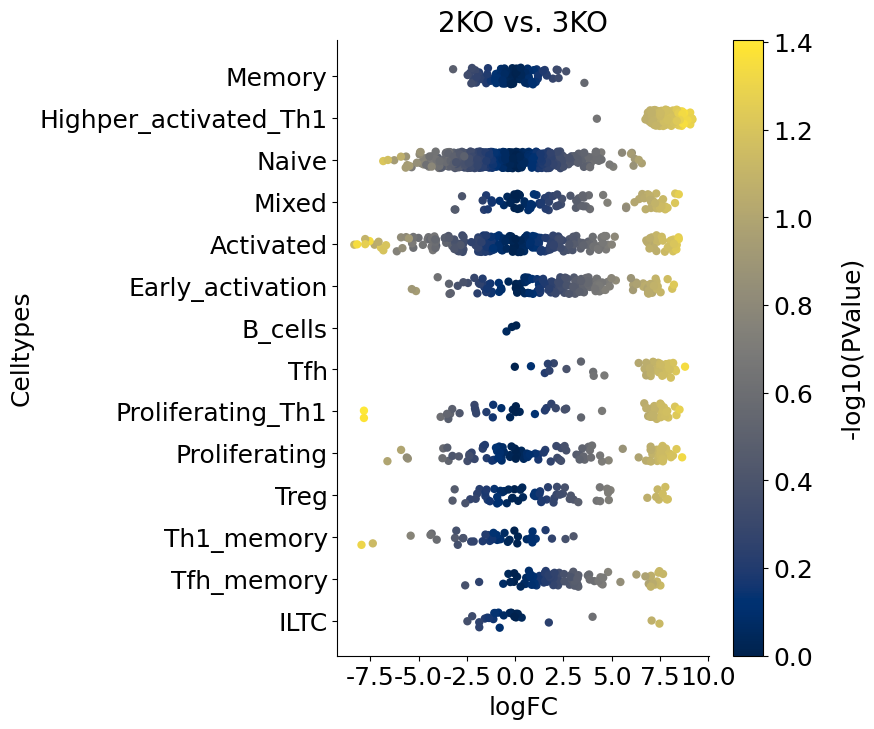

In [ ]:
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import seaborn as sns

for j, item in enumerate(['FDR', 'SpatialFDR', 'PValue']):
    fig = plt.figure(figsize = (6, 8))
    DA_results['log_' + item] = -np.log10(DA_results[item])
    ax = fig.add_subplot(1, 1, 1)
    plt.title('2KO vs. RII', fontsize=20)
    plot = sns.stripplot(x='logFC', y='annotation', hue='log_' + item, data=DA_results, size = 6, 
              palette='cividis', 
              jitter=0.2, edgecolor='none', ax = ax)
    plot.get_legend().set_visible(False)
    ax.set_xticklabels(ax.get_xticks(), fontsize = 18)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize = 18)
    ax.set_ylabel('Celltypes', fontsize = 18)
    ax.set_xlabel('logFC', fontsize = 18)
    sns.despine()

    # Drawing the side color bar
    normalize = mcolors.Normalize(vmin=DA_results['log_' + item].min(), 
                              vmax=DA_results['log_' + item].max())
    colormap = cm.cividis

    for n in DA_results['log_' + item]:
        plt.plot(color=colormap(normalize(n)))

    scalarmappaple = cm.ScalarMappable(norm=normalize, cmap=colormap)
    scalarmappaple.set_array(DA_results['log_' + item])
    cbar = fig.colorbar(scalarmappaple)
    ticks = cbar.ax.get_yticks()
    cbar.ax.set_yticklabels(['{:.1f}'.format(tick) for tick in ticks], fontsize=18)
    cbar.ax.set_ylabel('-log10(' + item + ')',  labelpad = 20, rotation=90, fontsize = 18)
    ax.grid(False)
    #fig.savefig(outbase + 'milor_endothelial_swarmplot_new_colored_by_log_' + item + '_july13.pdf', dpi = 300, bbox_inches = 'tight')import matplotlib.colors as mcolors
import matplotlib.cm as cm
import seaborn as sns

for j, item in enumerate(['FDR', 'SpatialFDR', 'PValue']):
    fig = plt.figure(figsize = (6, 8))
    DA_results['log_' + item] = -np.log10(DA_results[item])
    ax = fig.add_subplot(1, 1, 1)
    plt.title('2KO vs. 3KO', fontsize=20)
    plot = sns.stripplot(x='logFC', y='annotation', hue='log_' + item, data=DA_results, size = 6, 
              palette='cividis', 
              jitter=0.2, edgecolor='none', ax = ax)
    plot.get_legend().set_visible(False)
    ax.set_xticklabels(ax.get_xticks(), fontsize = 18)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize = 18)
    ax.set_ylabel('Celltypes', fontsize = 18)
    ax.set_xlabel('logFC', fontsize = 18)
    sns.despine()

    # Drawing the side color bar
    normalize = mcolors.Normalize(vmin=DA_results['log_' + item].min(), 
                              vmax=DA_results['log_' + item].max())
    colormap = cm.cividis

    for n in DA_results['log_' + item]:
        plt.plot(color=colormap(normalize(n)))

    scalarmappaple = cm.ScalarMappable(norm=normalize, cmap=colormap)
    scalarmappaple.set_array(DA_results['log_' + item])
    cbar = fig.colorbar(scalarmappaple)
    ticks = cbar.ax.get_yticks()
    cbar.ax.set_yticklabels(['{:.1f}'.format(tick) for tick in ticks], fontsize=18)
    cbar.ax.set_ylabel('-log10(' + item + ')',  labelpad = 20, rotation=90, fontsize = 18)
    ax.grid(False)
    #fig.savefig(outbase + 'milor_endothelial_swarmplot_new_colored_by_log_' + item + '_july13.pdf', dpi = 300, bbox_inches = 'tight')

##### 2KO vs PD1

In [ ]:
%%R -i design_df -o DA_results
contrast.1 <- c("genotype2KO - genotypePD1")

## Test for differential abundance
DA_results <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")

# https://rdrr.io/github/MarioniLab/miloR/man/testNhoods.html
# https://bioconductor.org/packages/release/bioc/vignettes/miloR/inst/doc/milo_contrasts.html

R[write to console]: Using TMM normalisation

R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



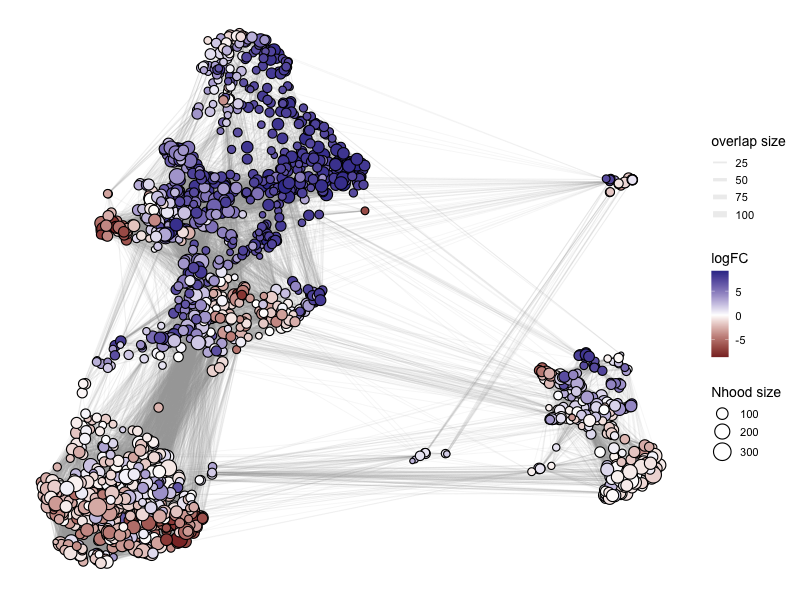

In [ ]:
%%R -w 800 -h 600
alpha_val = 1
library(ggplot2)
p1 <- plotNhoodGraphDA(r_milo, DA_results, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
p1

In [ ]:
%%R 
DA_results <- annotateNhoods(r_milo, DA_results, coldata_col = "annotation_v1")

R[write to console]: Converting annotation_v1 to factor...



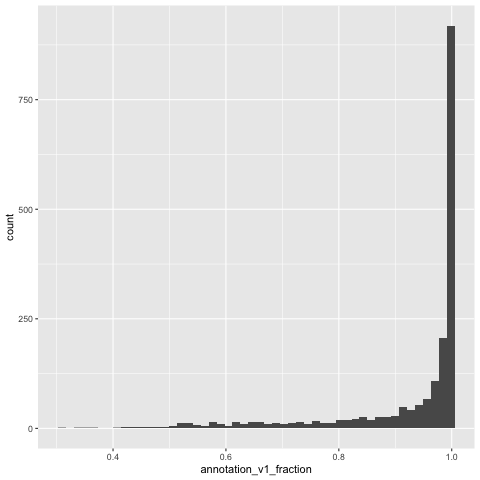

In [ ]:
%%R
library(ggplot2)
ggplot(DA_results, aes(annotation_v1_fraction)) + geom_histogram(bins=50)

In [ ]:
%%R -o DA_results
DA_results$annotation <- ifelse(DA_results$annotation_v1_fraction < 0.6, "Mixed", DA_results$annotation_v1)
head(DA_results)

       logFC   logCPM          F     PValue       FDR Nhood SpatialFDR
1 -0.6820446 9.129662 0.05199797 0.81962735 0.9660987     1  0.9429684
2  7.8373920 9.008214 3.55298438 0.05946906 0.3643738     2  0.2828819
3  0.6119211 8.835404 0.04363405 0.83454044 0.9693273     3  0.9520438
4  1.3417310 9.684184 0.19484640 0.65892332 0.9114744     4  0.8619371
5  8.0237981 9.280402 3.52950269 0.06031658 0.3643738     5  0.2828819
6  8.1719372 9.261216 3.62705170 0.05687772 0.3643738     6  0.2828819
          annotation_v1 annotation_v1_fraction            annotation
1                Memory              1.0000000                Memory
2 Highper_activated_Th1              1.0000000 Highper_activated_Th1
3                 Naive              1.0000000                 Naive
4                  Treg              0.5625000                 Mixed
5             Activated              0.9882353             Activated
6 Highper_activated_Th1              0.7093023 Highper_activated_Th1


R[write to console]: Converting group_by to factor...



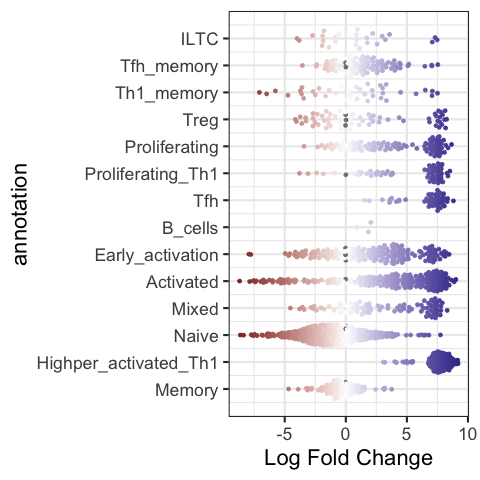

In [ ]:
%%R
plotDAbeeswarm(DA_results, group.by = "annotation", alpha = 1)

/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/79547577.py:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticks(), fontsize = 18)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/79547577.py:15: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize = 18)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/79547577.py:30: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = fig.colorbar(scalarmappaple)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/79547577.py:32: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.ax.set_yticklabel

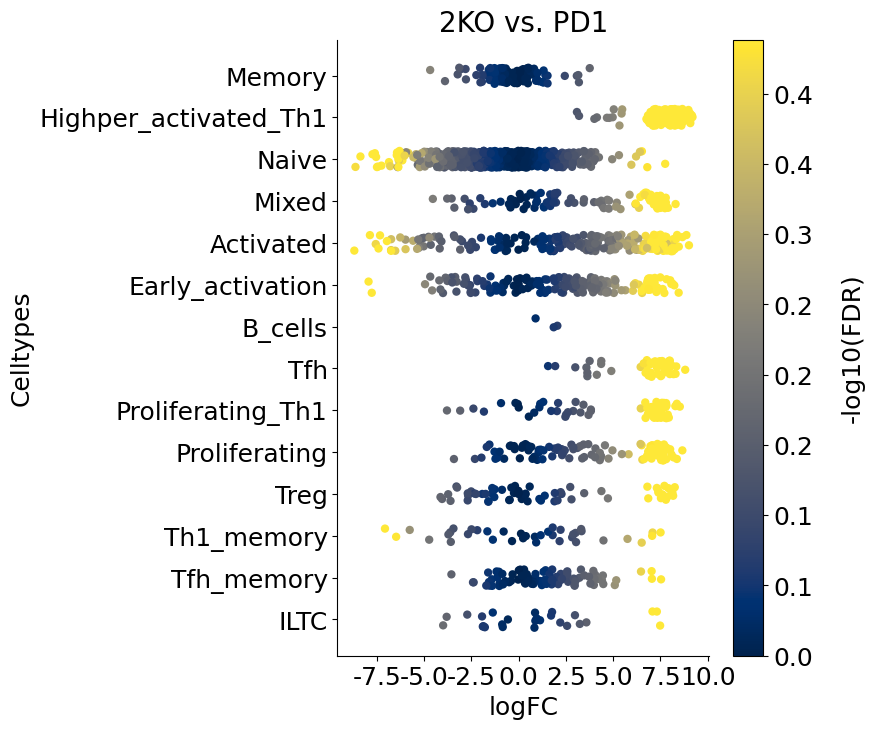

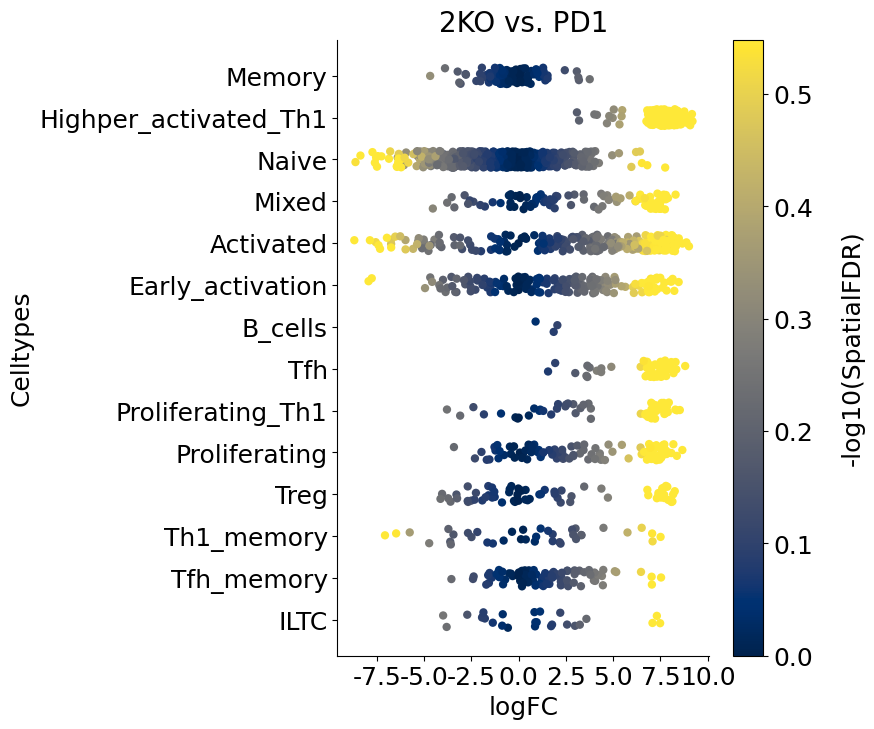

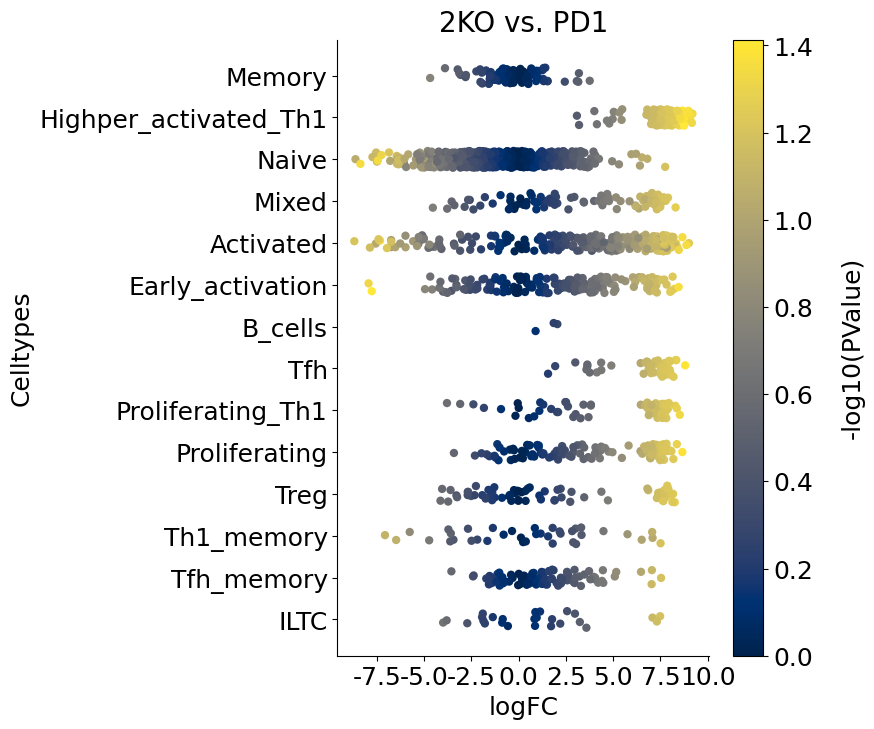

In [ ]:
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import seaborn as sns

for j, item in enumerate(['FDR', 'SpatialFDR', 'PValue']):
    fig = plt.figure(figsize = (6, 8))
    DA_results['log_' + item] = -np.log10(DA_results[item])
    ax = fig.add_subplot(1, 1, 1)
    plt.title('2KO vs. PD1', fontsize=20)
    plot = sns.stripplot(x='logFC', y='annotation', hue='log_' + item, data=DA_results, size = 6, 
              palette='cividis', 
              jitter=0.2, edgecolor='none', ax = ax)
    plot.get_legend().set_visible(False)
    ax.set_xticklabels(ax.get_xticks(), fontsize = 18)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize = 18)
    ax.set_ylabel('Celltypes', fontsize = 18)
    ax.set_xlabel('logFC', fontsize = 18)
    sns.despine()

    # Drawing the side color bar
    normalize = mcolors.Normalize(vmin=DA_results['log_' + item].min(), 
                              vmax=DA_results['log_' + item].max())
    colormap = cm.cividis

    for n in DA_results['log_' + item]:
        plt.plot(color=colormap(normalize(n)))

    scalarmappaple = cm.ScalarMappable(norm=normalize, cmap=colormap)
    scalarmappaple.set_array(DA_results['log_' + item])
    cbar = fig.colorbar(scalarmappaple)
    ticks = cbar.ax.get_yticks()
    cbar.ax.set_yticklabels(['{:.1f}'.format(tick) for tick in ticks], fontsize=18)
    cbar.ax.set_ylabel('-log10(' + item + ')',  labelpad = 20, rotation=90, fontsize = 18)
    ax.grid(False)
    #fig.savefig(outbase + 'milor_endothelial_swarmplot_new_colored_by_log_' + item + '_july13.pdf', dpi = 300, bbox_inches = 'tight')

##### 2KO vs WT

In [ ]:
%%R -i design_df -o DA_results
contrast.1 <- c("genotype2KO - genotypeWT")

## Test for differential abundance
DA_results <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")

# https://rdrr.io/github/MarioniLab/miloR/man/testNhoods.html
# https://bioconductor.org/packages/release/bioc/vignettes/miloR/inst/doc/milo_contrasts.html

R[write to console]: Using TMM normalisation



R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



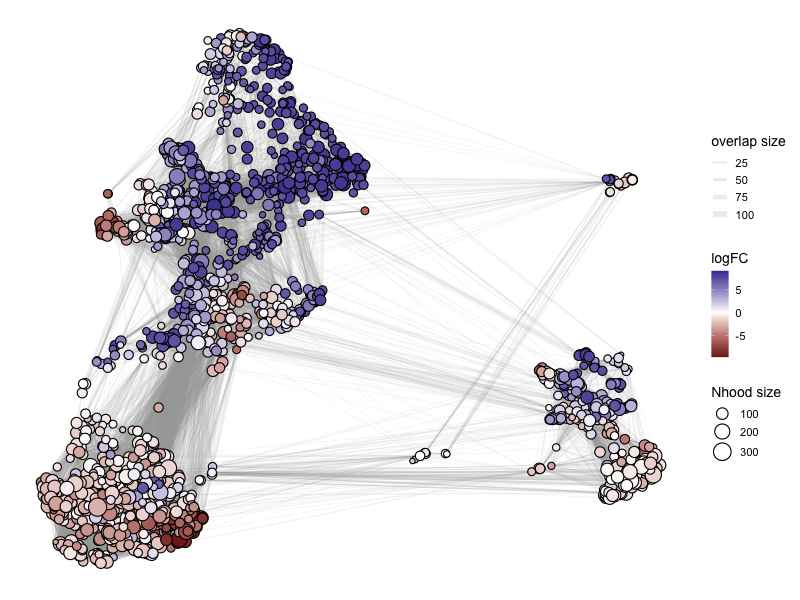

In [ ]:
%%R -w 800 -h 600
alpha_val = 1
library(ggplot2)
p1 <- plotNhoodGraphDA(r_milo, DA_results, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
p1

In [ ]:
%%R 
DA_results <- annotateNhoods(r_milo, DA_results, coldata_col = "annotation_v1")

R[write to console]: Converting annotation_v1 to factor...



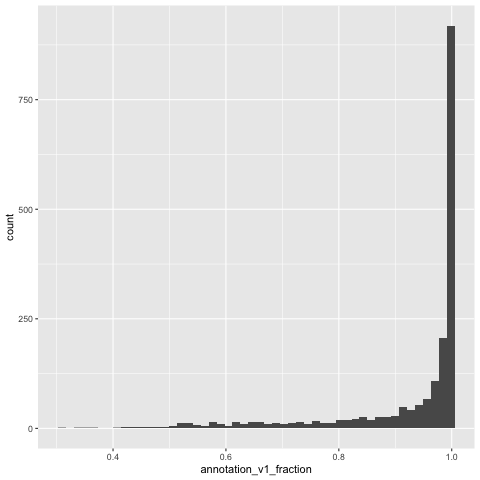

In [ ]:
%%R
library(ggplot2)
ggplot(DA_results, aes(annotation_v1_fraction)) + geom_histogram(bins=50)

In [ ]:
%%R -o DA_results
DA_results$annotation <- ifelse(DA_results$annotation_v1_fraction < 0.6, "Mixed", DA_results$annotation_v1)
head(DA_results)

       logFC   logCPM           F     PValue       FDR Nhood SpatialFDR
1 -1.9353961 9.129662 0.393609415 0.53042335 0.8271983     1  0.7729047
2  7.8373920 9.008214 3.615713807 0.05726649 0.3244142     2  0.2632286
3 -0.2539191 8.835404 0.007604955 0.93050930 0.9813955     3  0.9760675
4  1.1933287 9.684184 0.158182927 0.69084396 0.8914571     4  0.8571792
5  8.0237981 9.280402 3.589695424 0.05816935 0.3244142     5  0.2632286
6  8.1719372 9.261216 3.687819473 0.05484124 0.3244142     6  0.2632286
          annotation_v1 annotation_v1_fraction            annotation
1                Memory              1.0000000                Memory
2 Highper_activated_Th1              1.0000000 Highper_activated_Th1
3                 Naive              1.0000000                 Naive
4                  Treg              0.5625000                 Mixed
5             Activated              0.9882353             Activated
6 Highper_activated_Th1              0.7093023 Highper_activated_Th1


R[write to console]: Converting group_by to factor...



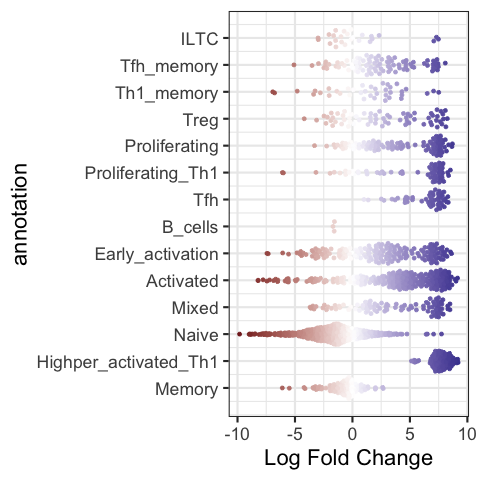

In [ ]:
%%R
plotDAbeeswarm(DA_results, group.by = "annotation", alpha = 1)

/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/307698149.py:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticks(), fontsize = 18)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/307698149.py:15: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize = 18)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/307698149.py:30: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = fig.colorbar(scalarmappaple)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/307698149.py:32: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.ax.set_ytickl

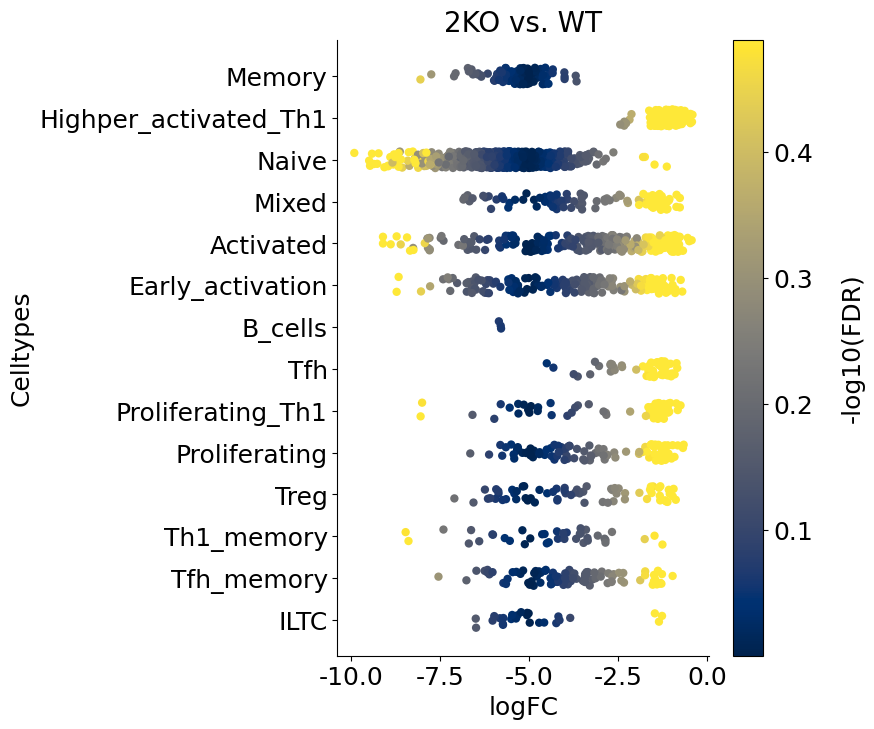

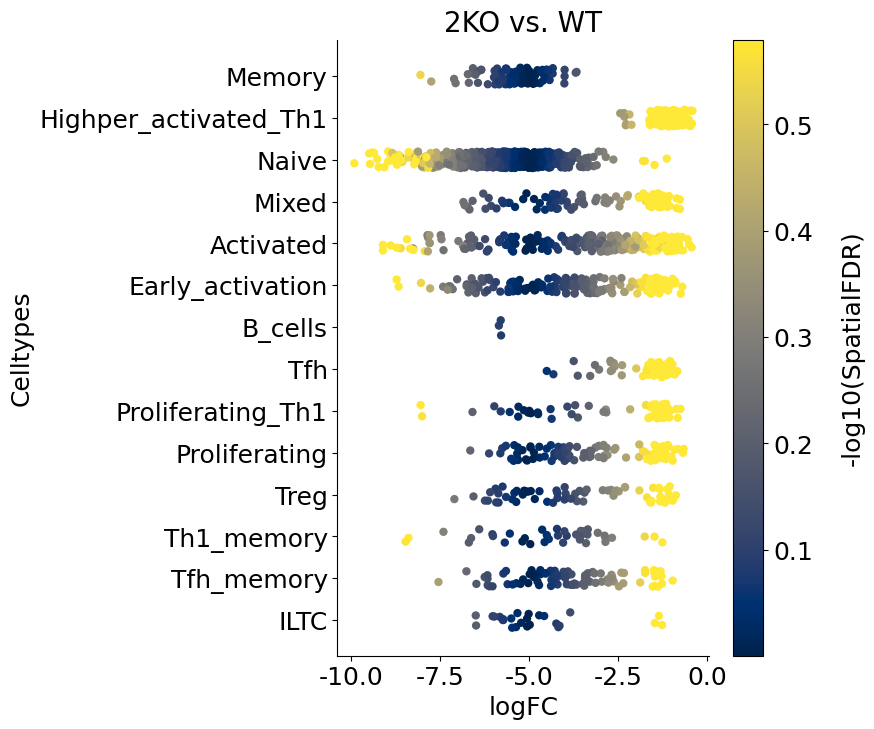

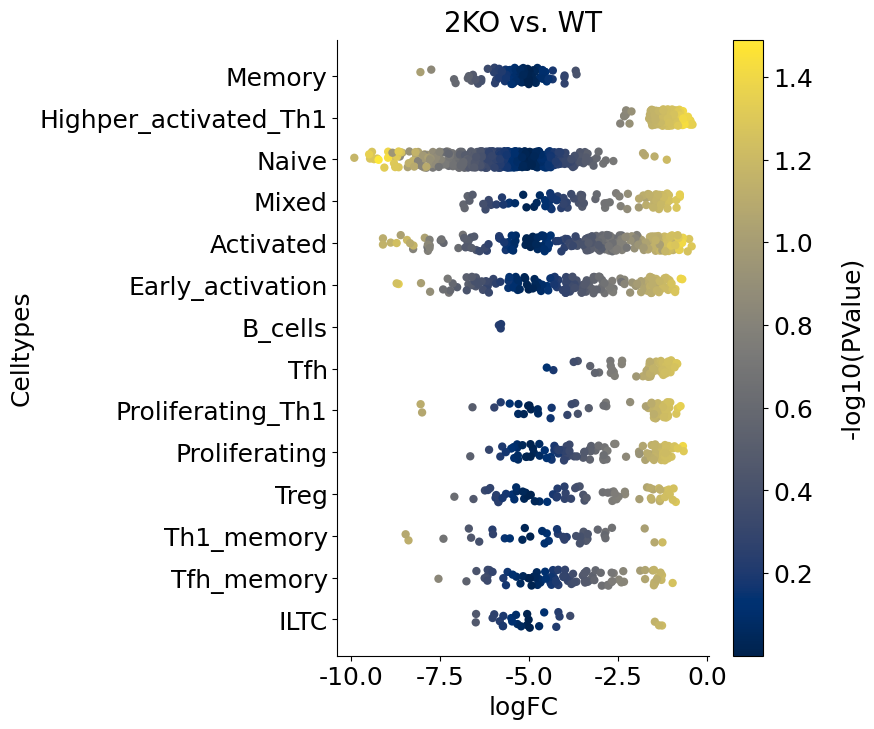

In [ ]:
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import seaborn as sns

for j, item in enumerate(['FDR', 'SpatialFDR', 'PValue']):
    fig = plt.figure(figsize = (6, 8))
    DA_results['log_' + item] = -np.log10(DA_results[item])
    ax = fig.add_subplot(1, 1, 1)
    plt.title('2KO vs. WT', fontsize=20)
    plot = sns.stripplot(x='logFC', y='annotation', hue='log_' + item, data=DA_results, size = 6, 
              palette='cividis', 
              jitter=0.2, edgecolor='none', ax = ax)
    plot.get_legend().set_visible(False)
    ax.set_xticklabels(ax.get_xticks(), fontsize = 18)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize = 18)
    ax.set_ylabel('Celltypes', fontsize = 18)
    ax.set_xlabel('logFC', fontsize = 18)
    sns.despine()

    # Drawing the side color bar
    normalize = mcolors.Normalize(vmin=DA_results['log_' + item].min(), 
                              vmax=DA_results['log_' + item].max())
    colormap = cm.cividis

    for n in DA_results['log_' + item]:
        plt.plot(color=colormap(normalize(n)))

    scalarmappaple = cm.ScalarMappable(norm=normalize, cmap=colormap)
    scalarmappaple.set_array(DA_results['log_' + item])
    cbar = fig.colorbar(scalarmappaple)
    ticks = cbar.ax.get_yticks()
    cbar.ax.set_yticklabels(['{:.1f}'.format(tick) for tick in ticks], fontsize=18)
    cbar.ax.set_ylabel('-log10(' + item + ')',  labelpad = 20, rotation=90, fontsize = 18)
    ax.grid(False)
    #fig.savefig(outbase + 'milor_endothelial_swarmplot_new_colored_by_log_' + item + '_july13.pdf', dpi = 300, bbox_inches = 'tight')

##### RII vs WT

In [ ]:
%%R -i design_df -o DA_results
contrast.1 <- c("genotypeRII - genotypeWT")

## Test for differential abundance
DA_results <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")

# https://rdrr.io/github/MarioniLab/miloR/man/testNhoods.html
# https://bioconductor.org/packages/release/bioc/vignettes/miloR/inst/doc/milo_contrasts.html

R[write to console]: Using TMM normalisation



R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



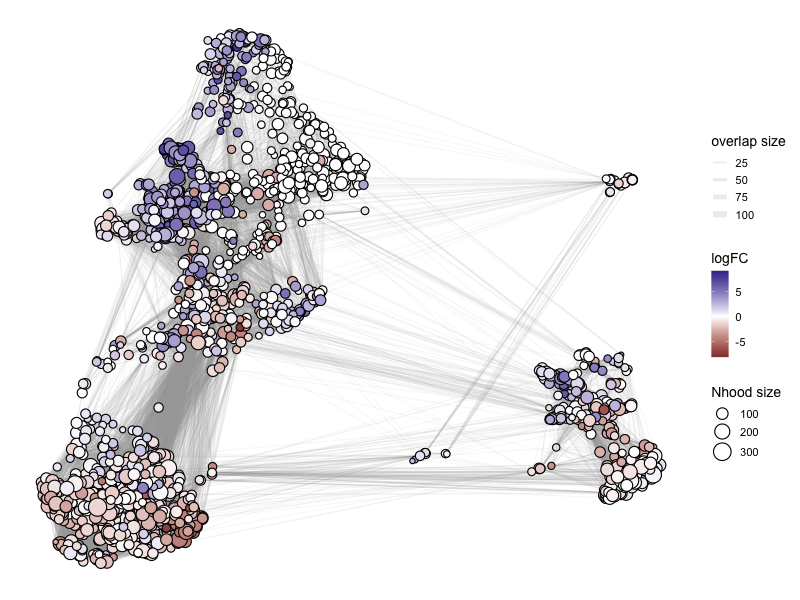

In [ ]:
%%R -w 800 -h 600
alpha_val = 1
library(ggplot2)
p1 <- plotNhoodGraphDA(r_milo, DA_results, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
p1

In [ ]:
%%R 
DA_results <- annotateNhoods(r_milo, DA_results, coldata_col = "annotation_v1")

R[write to console]: Converting annotation_v1 to factor...



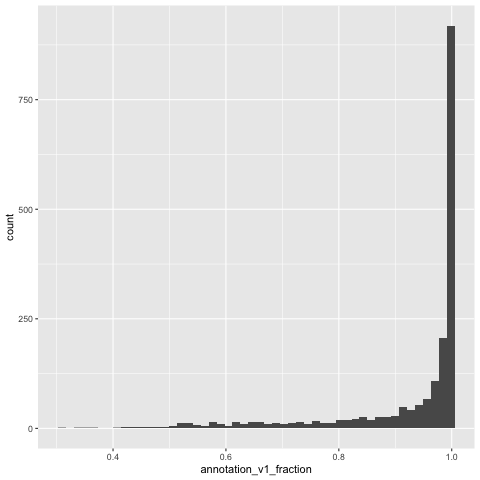

In [ ]:
%%R
library(ggplot2)
ggplot(DA_results, aes(annotation_v1_fraction)) + geom_histogram(bins=50)

In [ ]:
%%R -o DA_results
DA_results$annotation <- ifelse(DA_results$annotation_v1_fraction < 0.6, "Mixed", DA_results$annotation_v1)
head(DA_results)

          logFC   logCPM          F    PValue FDR Nhood SpatialFDR
1 -8.882400e-01 9.129662 0.08588382 0.7694832   1     1          1
2  2.562741e-15 9.008214 0.00000000 1.0000000   1     2          1
3 -5.797524e+00 8.835404 2.11030121 0.1463437   1     3          1
4  1.128388e+00 9.684184 0.13886166 0.7094237   1     4          1
5  3.309154e+00 9.280402 0.86854115 0.3513833   1     5          1
6  2.562741e-15 9.261216 0.00000000 1.0000000   1     6          1
          annotation_v1 annotation_v1_fraction            annotation
1                Memory              1.0000000                Memory
2 Highper_activated_Th1              1.0000000 Highper_activated_Th1
3                 Naive              1.0000000                 Naive
4                  Treg              0.5625000                 Mixed
5             Activated              0.9882353             Activated
6 Highper_activated_Th1              0.7093023 Highper_activated_Th1


R[write to console]: Converting group_by to factor...

R[write to console]: Error: Discrete value supplied to continuous scale



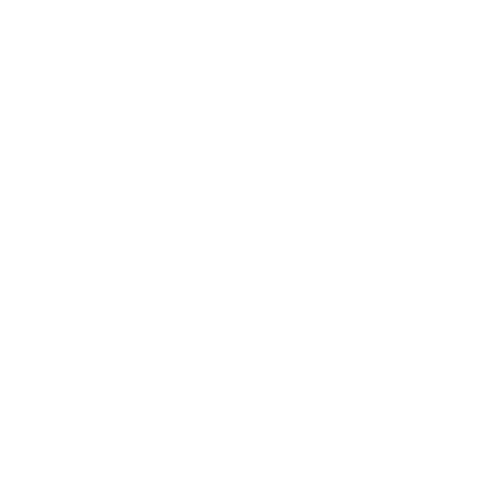

RRuntimeError: Error: Discrete value supplied to continuous scale


In [ ]:
%%R
plotDAbeeswarm(DA_results, group.by = "annotation", alpha = 1)

/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/1097528022.py:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticks(), fontsize = 18)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/1097528022.py:15: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize = 18)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/1097528022.py:30: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = fig.colorbar(scalarmappaple)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/1097528022.py:32: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.ax.set_yt

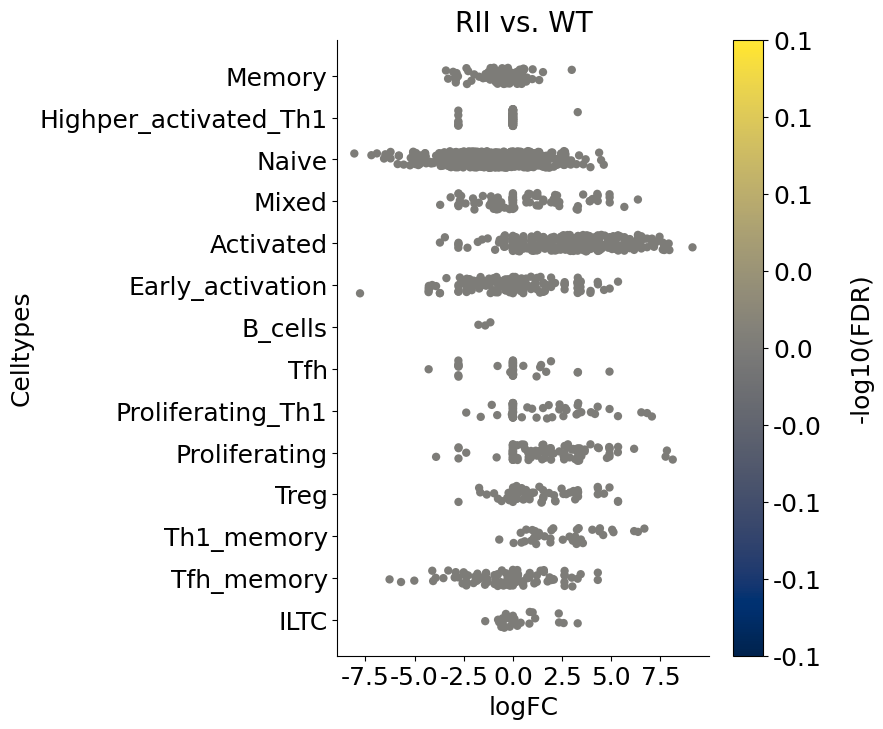

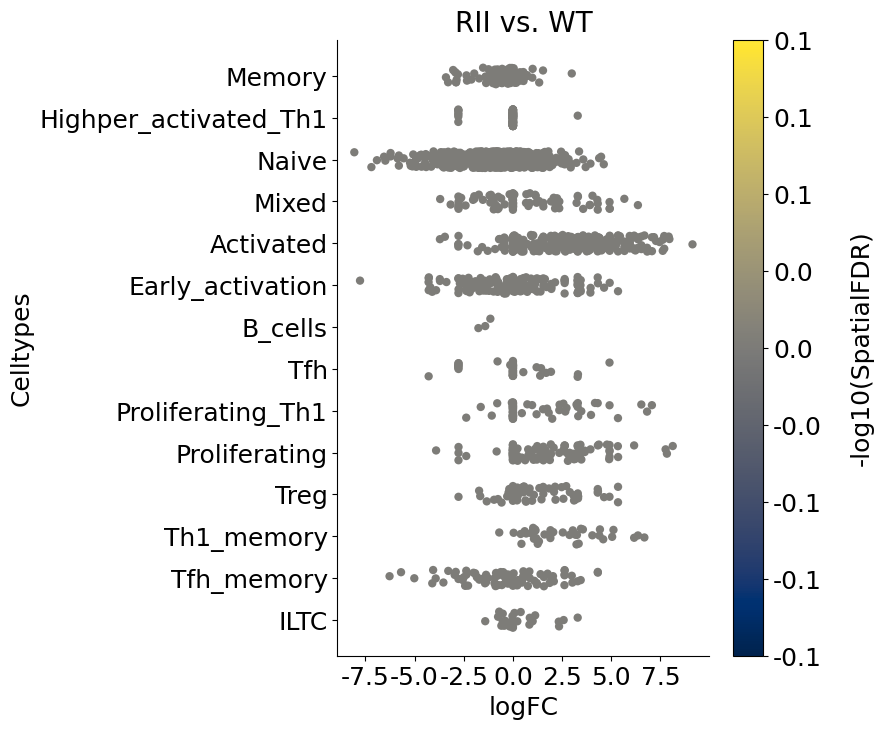

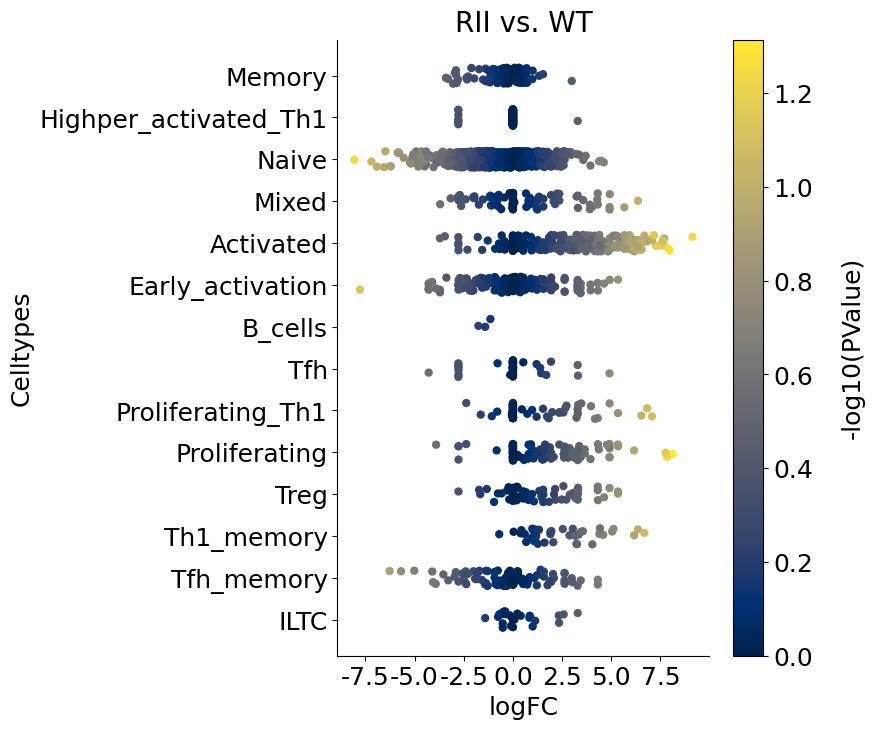

In [ ]:
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import seaborn as sns

for j, item in enumerate(['FDR', 'SpatialFDR', 'PValue']):
    fig = plt.figure(figsize = (6, 8))
    DA_results['log_' + item] = -np.log10(DA_results[item])
    ax = fig.add_subplot(1, 1, 1)
    plt.title('RII vs. WT', fontsize=20)
    plot = sns.stripplot(x='logFC', y='annotation', hue='log_' + item, data=DA_results, size = 6, 
              palette='cividis', 
              jitter=0.2, edgecolor='none', ax = ax)
    plot.get_legend().set_visible(False)
    ax.set_xticklabels(ax.get_xticks(), fontsize = 18)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize = 18)
    ax.set_ylabel('Celltypes', fontsize = 18)
    ax.set_xlabel('logFC', fontsize = 18)
    sns.despine()

    # Drawing the side color bar
    normalize = mcolors.Normalize(vmin=DA_results['log_' + item].min(), 
                              vmax=DA_results['log_' + item].max())
    colormap = cm.cividis

    for n in DA_results['log_' + item]:
        plt.plot(color=colormap(normalize(n)))

    scalarmappaple = cm.ScalarMappable(norm=normalize, cmap=colormap)
    scalarmappaple.set_array(DA_results['log_' + item])
    cbar = fig.colorbar(scalarmappaple)
    ticks = cbar.ax.get_yticks()
    cbar.ax.set_yticklabels(['{:.1f}'.format(tick) for tick in ticks], fontsize=18)
    cbar.ax.set_ylabel('-log10(' + item + ')',  labelpad = 20, rotation=90, fontsize = 18)
    ax.grid(False)
    #fig.savefig(outbase + 'milor_endothelial_swarmplot_new_colored_by_log_' + item + '_july13.pdf', dpi = 300, bbox_inches = 'tight')

##### PD1 vs WT

In [ ]:
%%R -i design_df -o DA_results
contrast.1 <- c("genotypePD1 - genotypeWT")

## Test for differential abundance
DA_results <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")

# https://rdrr.io/github/MarioniLab/miloR/man/testNhoods.html
# https://bioconductor.org/packages/release/bioc/vignettes/miloR/inst/doc/milo_contrasts.html

R[write to console]: Using TMM normalisation



R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



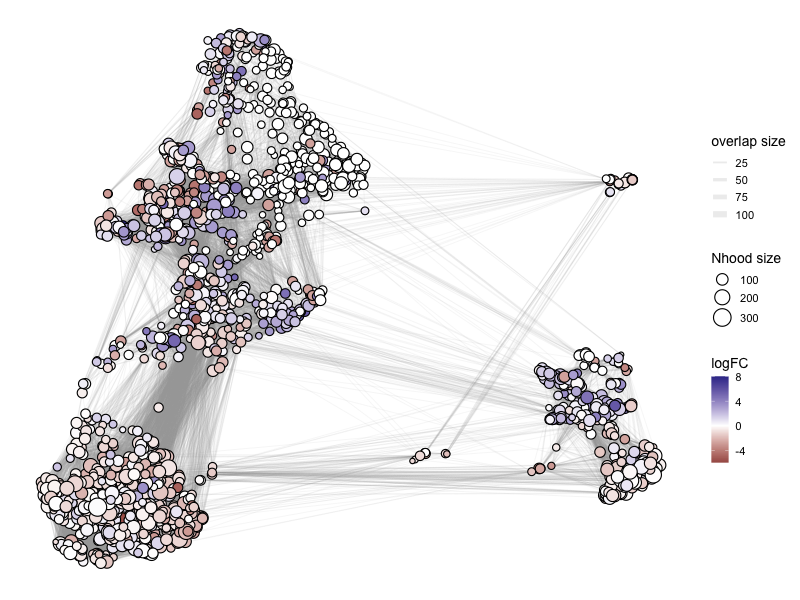

In [ ]:
%%R -w 800 -h 600
alpha_val = 1
library(ggplot2)
p1 <- plotNhoodGraphDA(r_milo, DA_results, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
p1

In [ ]:
%%R 
DA_results <- annotateNhoods(r_milo, DA_results, coldata_col = "annotation_v1")

R[write to console]: Converting annotation_v1 to factor...



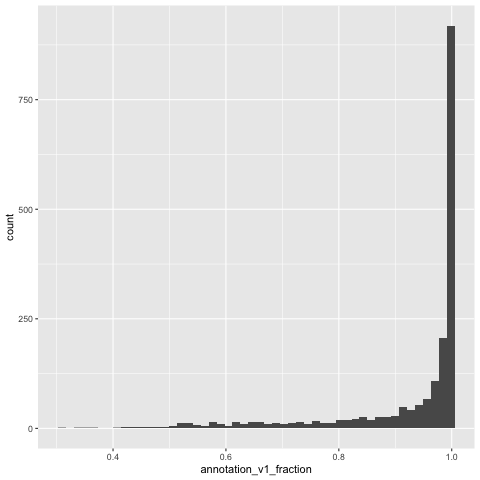

In [ ]:
%%R
library(ggplot2)
ggplot(DA_results, aes(annotation_v1_fraction)) + geom_histogram(bins=50)

In [ ]:
%%R -o DA_results
DA_results$annotation <- ifelse(DA_results$annotation_v1_fraction < 0.6, "Mixed", DA_results$annotation_v1)
head(DA_results)

       logFC   logCPM           F    PValue FDR Nhood SpatialFDR
1 -1.2533515 9.129662 0.169494456 0.6805708   1     1          1
2  0.0000000 9.008214 0.000000000 1.0000000   1     2          1
3 -0.8658403 8.835404 0.085635536 0.7698072   1     3          1
4 -0.1484022 9.684184 0.002431001 0.9606771   1     4          1
5  0.0000000 9.280402 0.000000000 1.0000000   1     5          1
6  0.0000000 9.261216 0.000000000 1.0000000   1     6          1
          annotation_v1 annotation_v1_fraction            annotation
1                Memory              1.0000000                Memory
2 Highper_activated_Th1              1.0000000 Highper_activated_Th1
3                 Naive              1.0000000                 Naive
4                  Treg              0.5625000                 Mixed
5             Activated              0.9882353             Activated
6 Highper_activated_Th1              0.7093023 Highper_activated_Th1


/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/1134990356.py:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticks(), fontsize = 18)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/1134990356.py:15: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize = 18)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/1134990356.py:30: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = fig.colorbar(scalarmappaple)
/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_12214/1134990356.py:32: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.ax.set_yt

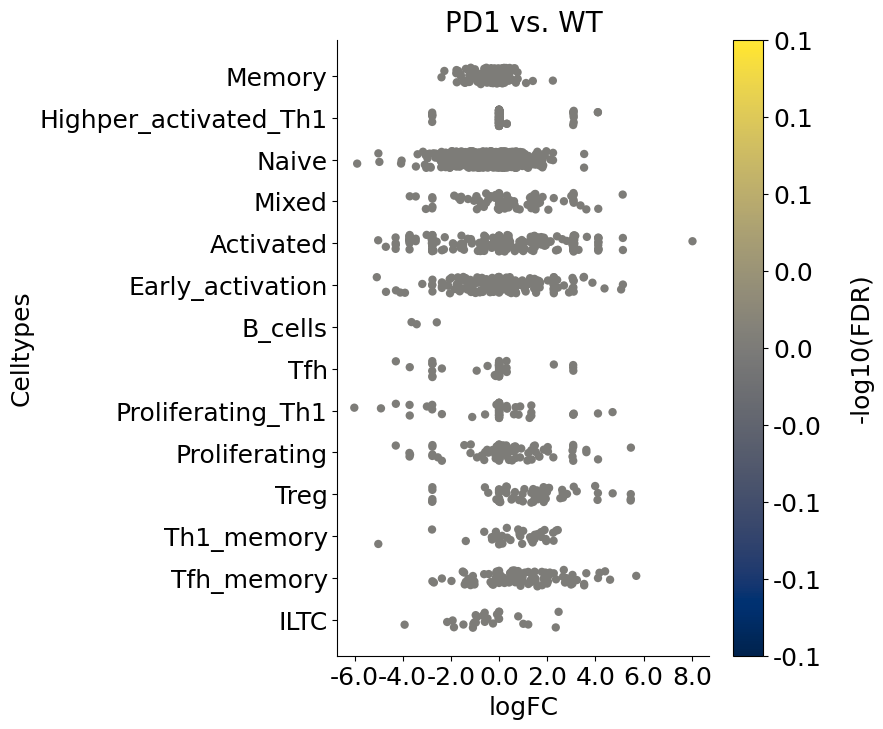

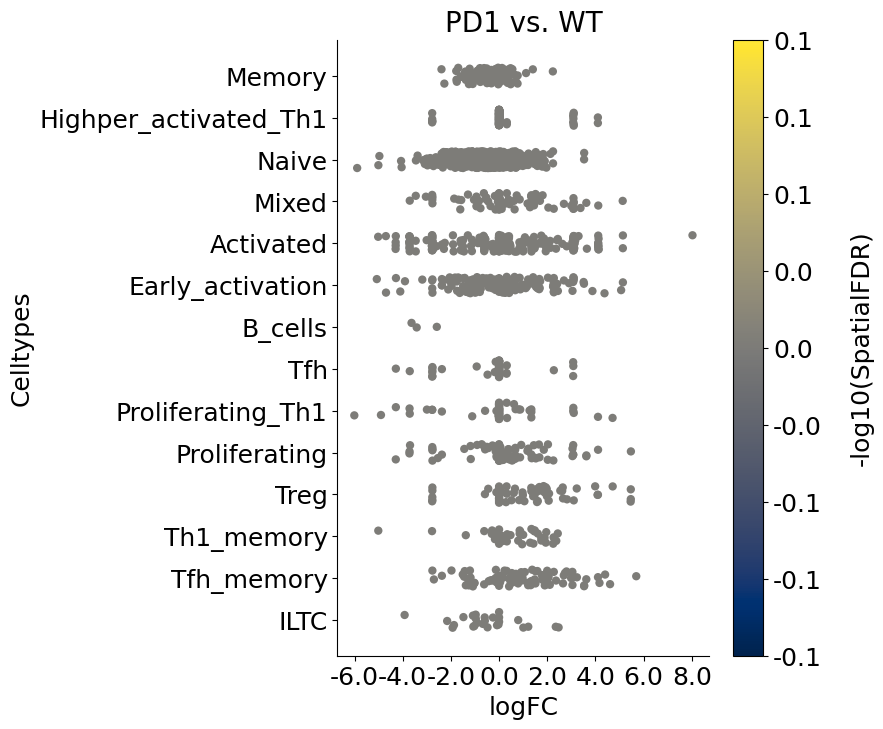

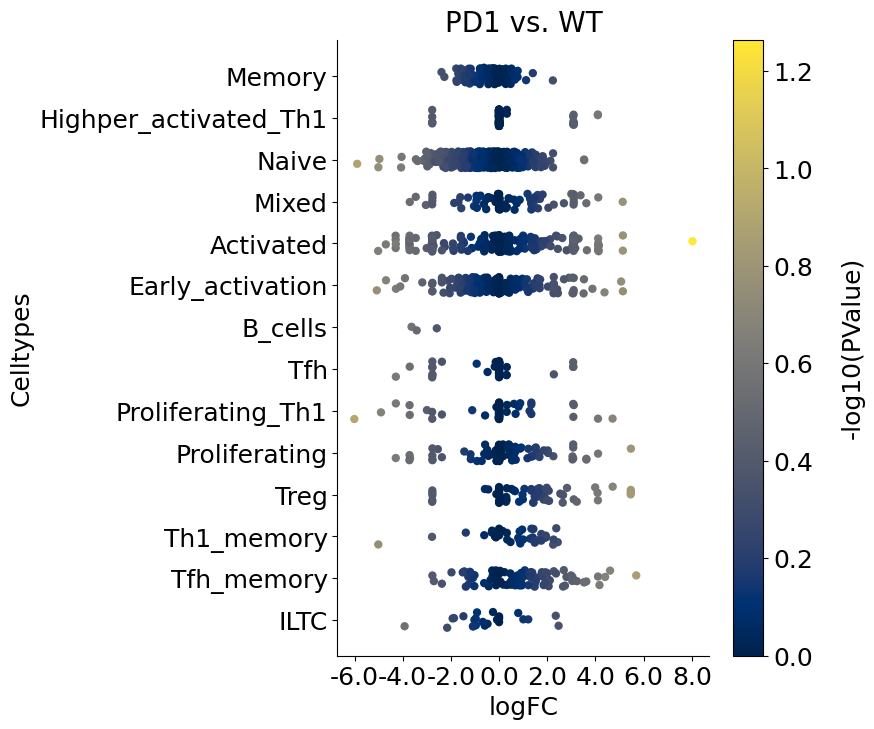

In [ ]:
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import seaborn as sns

for j, item in enumerate(['FDR', 'SpatialFDR', 'PValue']):
    fig = plt.figure(figsize = (6, 8))
    DA_results['log_' + item] = -np.log10(DA_results[item])
    ax = fig.add_subplot(1, 1, 1)
    plt.title('PD1 vs. WT', fontsize=20)
    plot = sns.stripplot(x='logFC', y='annotation', hue='log_' + item, data=DA_results, size = 6, 
              palette='cividis', 
              jitter=0.2, edgecolor='none', ax = ax)
    plot.get_legend().set_visible(False)
    ax.set_xticklabels(ax.get_xticks(), fontsize = 18)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize = 18)
    ax.set_ylabel('Celltypes', fontsize = 18)
    ax.set_xlabel('logFC', fontsize = 18)
    sns.despine()

    # Drawing the side color bar
    normalize = mcolors.Normalize(vmin=DA_results['log_' + item].min(), 
                              vmax=DA_results['log_' + item].max())
    colormap = cm.cividis

    for n in DA_results['log_' + item]:
        plt.plot(color=colormap(normalize(n)))

    scalarmappaple = cm.ScalarMappable(norm=normalize, cmap=colormap)
    scalarmappaple.set_array(DA_results['log_' + item])
    cbar = fig.colorbar(scalarmappaple)
    ticks = cbar.ax.get_yticks()
    cbar.ax.set_yticklabels(['{:.1f}'.format(tick) for tick in ticks], fontsize=18)
    cbar.ax.set_ylabel('-log10(' + item + ')',  labelpad = 20, rotation=90, fontsize = 18)
    ax.grid(False)
    #fig.savefig(outbase + 'milor_endothelial_swarmplot_new_colored_by_log_' + item + '_july13.pdf', dpi = 300, bbox_inches = 'tight')

#### TCR clonality analysis

In [ ]:
#py3.9 use muon for multimodel data intergration
import tarfile
import warnings
from glob import glob

import anndata
import mudata
import matplotlib.pyplot as plt
import muon as mu
import pandas as pd
import scanpy as sc
import scirpy as ir
import numpy as np

In [ ]:
tcr_all = sc.read_h5ad('intermediate/concatenate_tcr_all.h5ad')
adata = sc.read_h5ad('normalized_gex_all_ranked_sample_annotated_v1.h5ad')
mdata = mu.MuData({"gex": adata, "airr": tcr_all})
mdata

/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/mudata/_core/mudata.py:322: UserWarning: Duplicated obs_names should not be present in different modalities due to the ambiguity that leads to.
  warnings.warn(
/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/mudata/_core/mudata.py:322: UserWarning: Duplicated obs_names should not be present in different modalities due to the ambiguity that leads to.
  warnings.warn(
/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/mudata/_core/mudata.py:479: UserWarning: obs_

MuData object with n_obs × n_vars = 45102 × 16096
  2 modalities
    gex:	44489 x 16096
      obs:	'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'pheno_louvain_str', 'pheno_louvain_0.4', 'pheno_louvain_0.6', 'pheno_louvain_0.8', 'pheno_louvain_1.0', 'annotation', 'annotation_v1', 'organ', 'sample', 'genotype'
      var:	'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
      uns:	'dendrogram_pheno_louvain', 'dendrogram_pheno_louvain_str', 'draw_graph', 'hash_colors', 'hvg', 'id_hvg', 'loadings', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'pheno_louvain_str_colors', 'rank_genes_groups', 'umap', 'wilcoxon'
      obsm:	'X_draw_graph_fa', 'X_pca', 'X_umap'
      varm:	'PCs'
      layers:	'norm_counts', 'raw_data', 'zs_norm_log'
      obsp:	'neighbors_30_connectivities', 'neighbors_30_distances', 'pheno_jaccard_ig'
    airr:	34455 x 0
      obsm:	'airr'

In [ ]:
#testing saving and reading
mdata.write('intermediate/mudata_annotated_v1.h5mu')

/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/mudata/_core/mudata.py:322: UserWarning: Duplicated obs_names should not be present in different modalities due to the ambiguity that leads to.
  warnings.warn(
/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/mudata/_core/mudata.py:479: UserWarning: obs_names are not unique. To make them unique, call `.obs_names_make_unique`.
  warnings.warn(


In [ ]:
mdata2 = mudata.read_h5mu('intermediate/mudata_start.h5mu')

/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/mudata/_core/mudata.py:322: UserWarning: Duplicated obs_names should not be present in different modalities due to the ambiguity that leads to.
  warnings.warn(
/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/mudata/_core/mudata.py:322: UserWarning

In [ ]:
mdata2

MuData object with n_obs × n_vars = 46056 × 16096
  2 modalities
    gex:	44489 x 16096
      obs:	'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'organ', 'genotype', 'sample'
      var:	'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
      uns:	'draw_graph', 'hash_colors', 'hvg', 'id_hvg', 'loadings', 'neighbors_30', 'on_norm_log', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'rank_genes_groups', 'umap'
      obsm:	'X_draw_graph_fa', 'X_pca', 'X_umap'
      varm:	'PCs'
      layers:	'norm_counts', 'raw_data', 'zs_norm_log'
      obsp:	'neighbors_30_connectivities', 'neighbors_30_distances', 'pheno_jaccard_ig'
    airr:	34455 x 0
      obsm:	'airr'

##### index TCR and QC

In [ ]:
adata.obs_names_make_unique()
tcr_all.obs_names_make_unique()
ir.pp.index_chains(mdata)

###### I have a big concern here, why are there duplicates in cell barcodes and how should I deal with it

100%|██████████| 7/7 [00:02<00:00,  2.50it/s]


In [ ]:
ir.tl.chain_qc(mdata)
mdata.update()

##### take a look

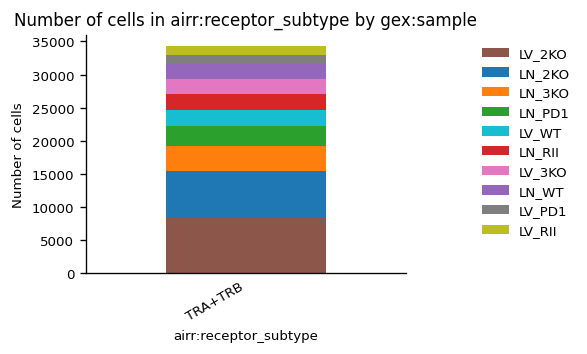

In [ ]:
_ = ir.pl.group_abundance(
    mdata, groupby="airr:receptor_subtype", target_col="gex:sample"
)

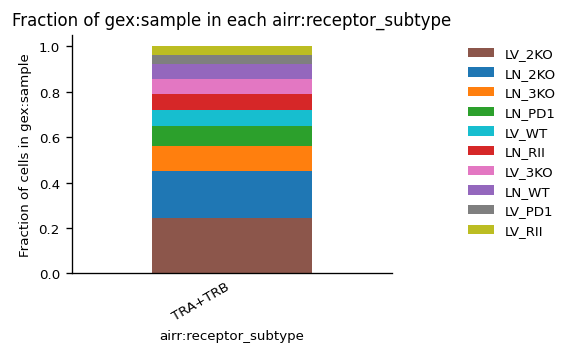

In [ ]:
_ = ir.pl.group_abundance(
    mdata, groupby="airr:receptor_subtype", target_col="gex:sample", normalize = True
)

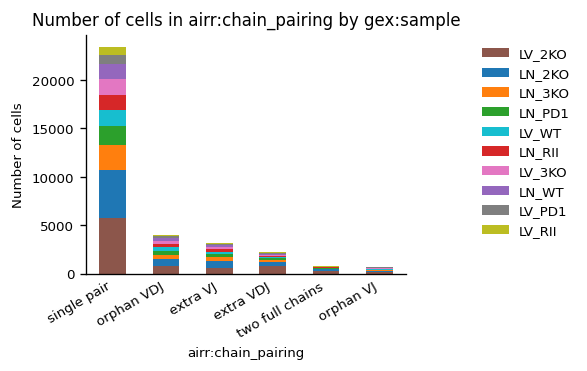

In [ ]:
_ = ir.pl.group_abundance(mdata, groupby="airr:chain_pairing", target_col="gex:sample")

In [ ]:
print(
    "Fraction of cells with more than one pair of TCRs: {:.2f}".format(
        np.sum(
            mdata.obs["airr:chain_pairing"].isin(
                ["extra VJ", "extra VDJ", "two full chains", "multichain"]
            )
        )
        / mdata["airr"].n_obs
    )
)

Fraction of cells with more than one pair of TCRs: 0.18


In [ ]:
# remove "orphan VDJ", "orphan VJ"
mu.pp.filter_obs(
    mdata, "airr:chain_pairing", lambda x: ~np.isin(x, ["orphan VDJ", "orphan VJ"])
)

##### define clonotypes and clonotype clusters
https://scirpy.scverse.org/en/latest/tutorials/tutorial_3k_tcr.html

In [ ]:
# using default parameters, `ir_dist` will compute nucleotide sequence identity
ir.pp.ir_dist(mdata)
ir.tl.define_clonotypes(mdata, receptor_arms="all", dual_ir="primary_only")

100%|██████████| 21781/21781 [01:09<00:00, 311.88it/s]
/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/scirpy/util/__init__.py:183: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.mdata.obs[mudata_key] = value
/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/scirpy/util/__init__.py:183: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.mdata.obs[mudata_key] = value


In [ ]:
#saving
mdata.write('intermediate/mudata_annotated_v1_clonotypes.h5mu')

In [ ]:
ir.tl.clonotype_network(mdata, min_cells=2)
# not so familiar with clonotype network

In [ ]:
mdata.obs.groupby("gex:sample", dropna=False).size()

gex:sample
LN_2KO     7558
LN_3KO     3885
LN_PD1     2855
LN_RII     2419
LN_WT      2302
LV_2KO    11632
LV_3KO     2900
LV_PD1     1665
LV_RII     1664
LV_WT      2962
NaN         126
dtype: int64

In [ ]:
mdata.obs.groupby("gex:genotype", dropna=False).size()

gex:genotype
2KO    19190
3KO     6785
PD1     4520
RII     4083
WT      5264
NaN      126
dtype: int64

In [ ]:
ir.tl.clonal_expansion(mdata)

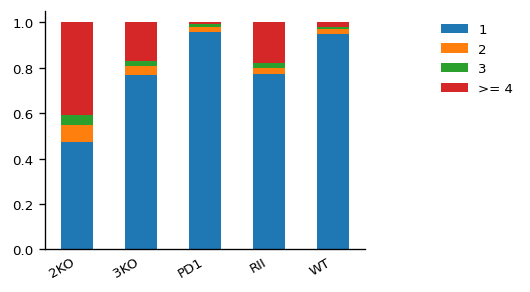

In [ ]:
_ = ir.pl.clonal_expansion(
    mdata, target_col="clone_id", groupby="gex:genotype", clip_at=4, normalize=True
)

In [ ]:
mdata

MuData object with n_obs × n_vars = 39968 × 16096
  2 modalities
    gex:	39842 x 16096
      obs:	'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'pheno_louvain', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'pheno_louvain_str', 'pheno_louvain_0.4', 'pheno_louvain_0.6', 'pheno_louvain_0.8', 'pheno_louvain_1.0', 'annotation', 'annotation_v1', 'organ', 'sample', 'genotype'
      var:	'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
      uns:	'dendrogram_pheno_louvain', 'dendrogram_pheno_louvain_str', 'draw_graph', 'hash_colors', 'hvg', 'id_hvg', 'loadings', 'neighbors_30', 'pca', 'pheno_jaccard_q', 'pheno_louvain_colors', 'pheno_louvain_str_colors', 'rank_genes_groups', 'umap', 'wilcoxon'
      obsm:	'X_draw_graph_fa', 'X_pca', 'X_umap'
      varm:	'PCs'
      layers:	'norm_counts', 'raw_data', 'zs_norm_log'
      obsp:	'neighbors_30_connectivities', 'neighbors_30_distances', 'pheno_jaccard_ig'
    airr:	29741 x 0
      obs:	'receptor_type', 'receptor_subtype', 'chain_pairing', 'clone_id', 'clone_id_size', 'clonal_expansion'
      uns:	'chain_indices', 'ir_dist_nt_identity', 'clone_id', 'clonotype_network'
      obsm:	'airr', 'chain_indices', 'X_clonotype_network'

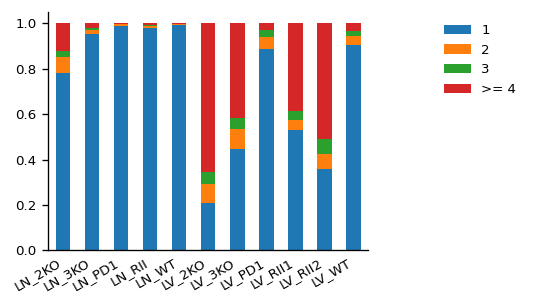

In [ ]:
_ = ir.pl.clonal_expansion(
    mdata, target_col="clone_id", groupby="gex:hash", clip_at=4, normalize=True
)

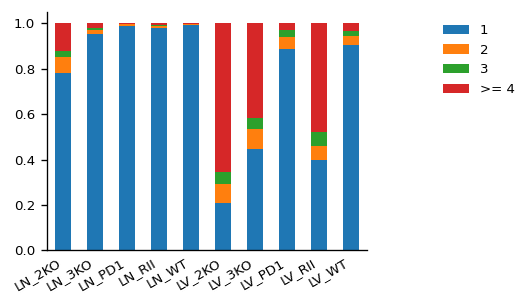

In [ ]:
_ = ir.pl.clonal_expansion(
    mdata, target_col="clone_id", groupby="gex:sample", clip_at=4, normalize=True
)

In [ ]:
mdata.write('intermediate/mudata_annotated_v1_clonotypes_clonalExpansion.h5mu')

In [ ]:
#mdata = mudata.read_h5mu('intermediate/mudata_start.h5mu')

/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/anndata/_core/aligned_mapping.py:54: ExperimentalFeatureWarning: Support for Awkward Arrays is currently experimental. Behavior may change in the future. Please report any issues you may encounter!
  warnings.warn(
/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/gaos1/anaconda3/envs/py39/lib/python3.9

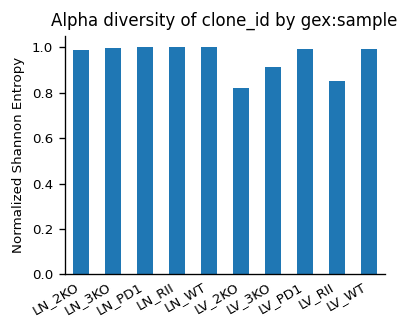

In [ ]:
_ = ir.pl.alpha_diversity(
    mdata, metric="normalized_shannon_entropy", groupby="gex:sample"
)

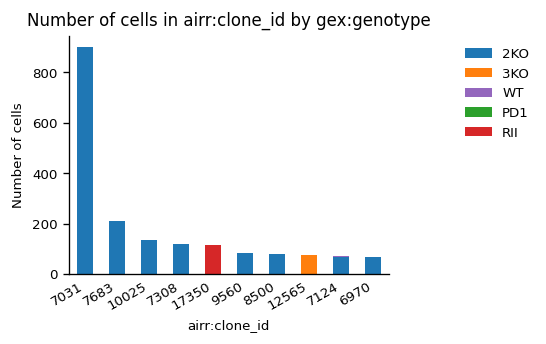

In [ ]:
_ = ir.pl.group_abundance(
    mdata, groupby="airr:clone_id", target_col="gex:genotype", max_cols=10
)

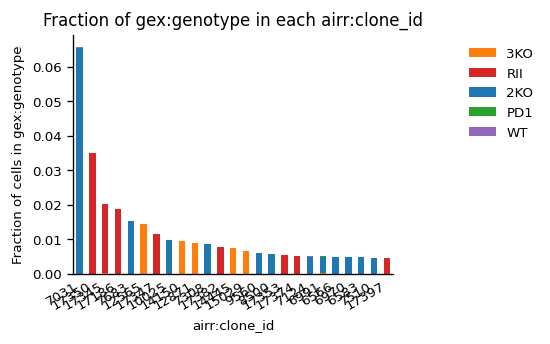

In [ ]:
import scirpy as ir
_ = ir.pl.group_abundance(
    mdata, groupby="airr:clone_id", target_col="gex:genotype", normalize= 'gex:genotype', max_cols=25
)

In [ ]:
# the sorting in the original function is by count by default, while I want it to be sorted by normalized count
# need to write customized functions

##### sorting by normalized count in group_abundance

In [ ]:
from collections.abc import Sequence
from typing import Literal, Union
from scirpy.get import _has_ir
from scirpy.util import DataHandler, _is_na, _normalize_counts
from anndata import AnnData
from mudata import MuData

def _group_abundance_normaized(
    ir_obs: pd.DataFrame,
    groupby: str,
    target_col: str,
    *,
    fraction: Union[None, str, bool] = None,
    sort: Union[Literal["count", "alphabetical"], Sequence[str]] = "count",
) -> pd.DataFrame:
    ir_obs
    # remove NA rows
    na_mask = _is_na(ir_obs[groupby]) | _is_na(ir_obs[target_col])
    ir_obs = ir_obs.loc[~na_mask, :]

    # normalize to fractions
    scale_vector = _normalize_counts(ir_obs, normalize=fraction, default_col=groupby)
    ir_obs = ir_obs.assign(count=1, weight=scale_vector)

    # Calculate distribution of lengths in each group. Use sum instead of count
    # to reflect weights
    group_counts = (
        ir_obs.loc[:, [groupby, target_col, "count", "weight"]]
        .groupby([groupby, target_col], observed=True)
        .sum()
        .reset_index()
        .rename(columns={"weight": "weighted_count"})
    )

    result_df = group_counts.pivot(index=groupby, columns=target_col, values="weighted_count").fillna(value=0.0)

    # required that we can still sort by abundance even if normalized
    result_df_count = group_counts.pivot(index=groupby, columns=target_col, values="count").fillna(value=0.0)

    # By default, the most abundant group should be the first on the plot,
    # therefore we need their order
    if isinstance(sort, str) and sort == "alphabetical":
        ranked_target = sorted(result_df.index)
    elif isinstance(sort, str) and sort == "count":
        ranked_target = result_df.apply(np.sum, axis=1).sort_values(ascending=False).index.values
    else:
        ranked_target = sort

    ranked_groups = result_df.apply(np.sum, axis=0).sort_values(ascending=False).index.values
    result_df = result_df.loc[ranked_target, ranked_groups]

    return result_df

def group_abundance_normaized(
    adata: Union[AnnData, MuData],
    groupby: str,
    target_col: str = "has_ir",
    *,
    fraction: Union[None, str, bool] = None,
    sort: Union[Literal["count", "alphabetical"], Sequence[str]] = "count",
) -> pd.DataFrame:
    """\
    Summarizes the number/fraction of cells of a certain category by a certain group.

    Ignores NaN values.

    Parameters
    ----------
    adata
        AnnData object to work on.
    groupby
        Group by this column from `obs`. E.g, sample, or group.
    target_col
        Caregorical variable from `obs` according to which the abundance/fractions
        will be computed. This defaults to "has_ir", simply counting
        the number of cells with a detected :term:`IR` by group.
    fraction
        If `True`, compute fractions of abundances relative to the `groupby` column
        rather than reporting abosolute numbers. Alternatively, a column
        name can be provided according to that the values will be normalized.
    sort
        How to arrange the dataframe columns.
        Default is by the category count ("count").
        Other options are "alphabetical" or to provide a list of column names.
        By providing an explicit list, the DataFrame can also be subsetted to
        specific categories.

    Returns
    -------
    Returns a data frame with the number (or fraction) of cells per group.
    """
    ir_obs = adata.obs

    # TODO temporarily adding `has_ir` is a temporary workaround to make this function work
    # with the new datastructure (has_ir doesn't exist anymore by default) until
    # This whole function is rewritten (see https://github.com/scverse/scirpy/issues/232)
    if target_col == "has_ir" and "has_ir" not in adata.obs.columns:
        ir_obs = ir_obs.copy().assign(
            # TODO I didn't expose the params check keyword arguments in this function
            # because the whole function needs to be rewritten.
            has_ir=_has_ir(DataHandler.default(adata)).astype(str)
        )

    if target_col not in ir_obs.columns:
        raise ValueError("`target_col` not found in obs`")

    return _group_abundance_normaized(ir_obs, groupby, target_col=target_col, fraction=fraction, sort=sort)


In [ ]:
import base
from styling import _get_colors

def plot_group_abundance_normaized(
    adata: Union[AnnData, MuData],
    groupby: str,
    target_col: str = "has_ir",
    *,
    normalize: Union[None, str, bool] = None,
    max_cols: Union[None, int] = None,
    sort: Union[Literal["count", "alphabetical"], Sequence[str]] = "count",
    **kwargs,
) -> plt.Axes:
    
    abundance = group_abundance_normaized(adata, groupby, target_col=target_col, fraction=normalize, sort=sort)

    if abundance.shape[0] > 100 and max_cols is None:
        raise ValueError(
            "Attempting to plot more than 100 columns. "
            "Set `max_cols` to a sensible value or to `0` to disable this message"
        )
    if max_cols is not None and max_cols > 0:
        abundance = abundance.iloc[:max_cols, :]

    # TODO workaround for temporarily added has_ir column. Don't get colors in that case
    if target_col != "has_ir":
        if "color" not in kwargs:
            colors = _get_colors(DataHandler.default(adata), target_col)
            if colors is not None:
                kwargs["color"] = [colors[cat] for cat in abundance.columns]

    # Create text for default labels
    if normalize:
        fraction_base = target_col if normalize is True else normalize
        title = "Fraction of " + target_col + " in each " + groupby
        xlab = groupby
        ylab = "Fraction of cells in " + fraction_base
    else:
        title = "Number of cells in " + groupby + " by " + target_col
        xlab = groupby
        ylab = "Number of cells"

    default_style_kws = {"title": title, "xlab": xlab, "ylab": ylab}
    if "style_kws" in kwargs:
        default_style_kws.update(kwargs["style_kws"])
    kwargs["style_kws"] = default_style_kws

    return base.bar(abundance, **kwargs)

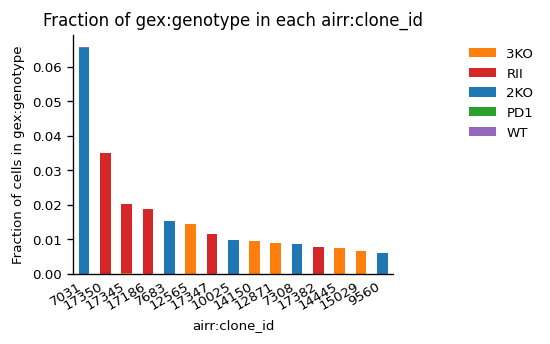

In [ ]:
_ = plot_group_abundance_normaized(
    mdata, groupby="airr:clone_id", target_col="gex:genotype", normalize= 'gex:genotype', max_cols=15
)

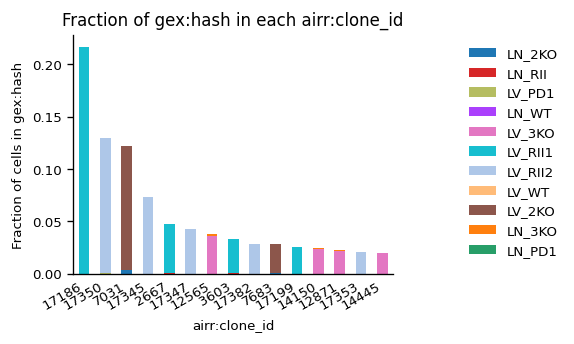

In [ ]:
_ = plot_group_abundance_normaized(
    mdata, groupby="airr:clone_id", target_col="gex:hash", normalize= 'gex:hash', max_cols=15
)

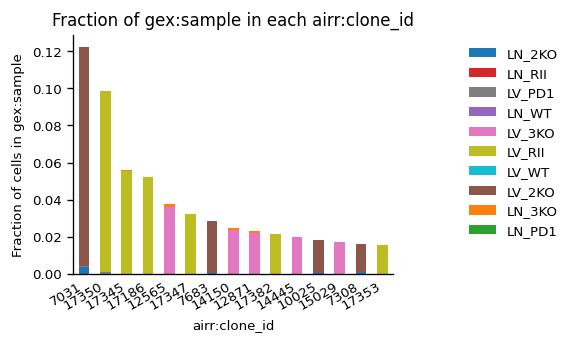

In [ ]:
_ = plot_group_abundance_normaized(
    mdata, groupby="airr:clone_id", target_col="gex:sample", normalize= 'gex:sample', max_cols=15
)

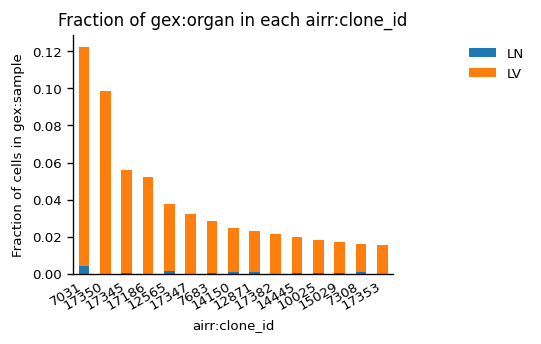

In [ ]:
_ = plot_group_abundance_normaized(
    mdata,
    groupby="airr:clone_id",
    target_col="gex:organ",
    max_cols=15,
    normalize="gex:sample",
)

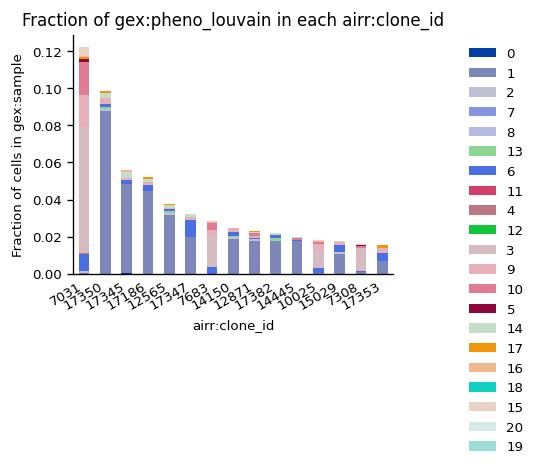

In [ ]:
_ = plot_group_abundance_normaized(
    mdata,
    groupby="airr:clone_id",
    target_col="gex:pheno_louvain",
    max_cols=15,
    normalize="gex:sample",
)

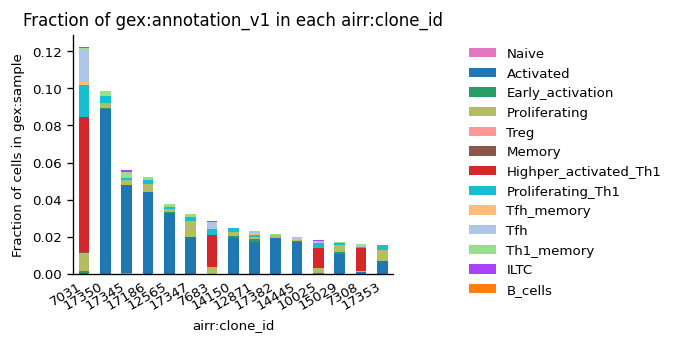

In [ ]:
_ = plot_group_abundance_normaized(
    mdata,
    groupby="airr:clone_id",
    target_col="gex:annotation_v1",
    max_cols=15,
    normalize="gex:sample",
)

### Conclusions

While it is clear that the gene expression profile is very different in 2KO compared to the control groups, such as upregulation of hyperactivated populations and signature genes, it seems the data need further clean up due to the following reasons:
- cluster 4, 5, 14, 15, 17 (bottom right conor) has higher mito fraction, and have similar signature genes and trend (such as how they change in each genotype) as some clusters in the major population on the left; it is possible that these are unhealthy cells that got separated from the major clusters due to higher mito content
- cluster 16, 19 express innate like T cell signature genes (ILTC)
- cluster 20 is contaminating B cells

/Users/gaos1/anaconda3/envs/py39/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


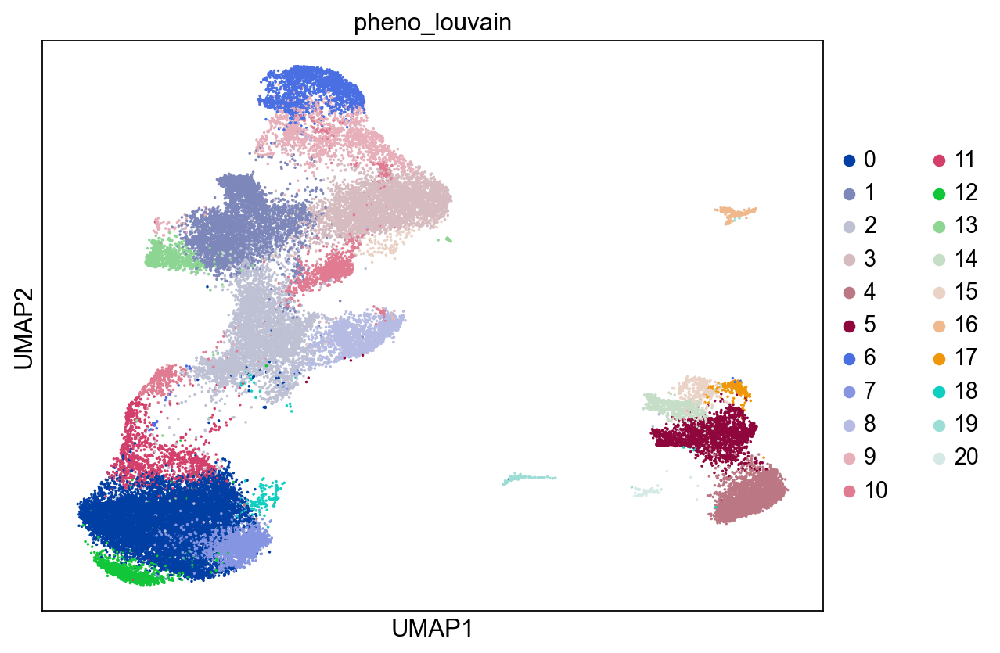

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14, figsize = (8, 6))
sc.pl.umap(adata, color = 'pheno_louvain', s = 10, palette = sc.pl.palettes.zeileis_28, ncols = 2)

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


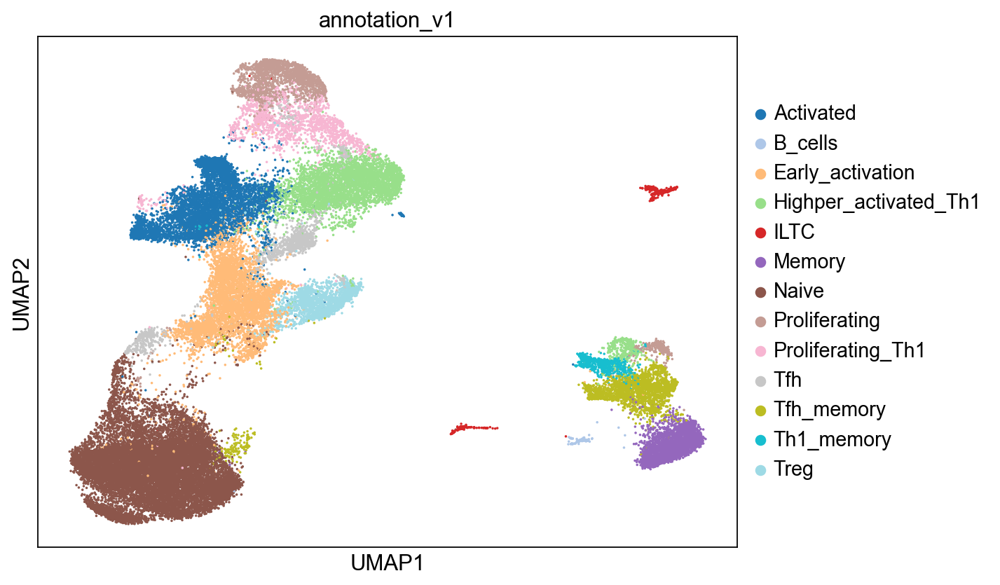

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14, figsize = (8, 6))
sc.pl.umap(adata, color = 'annotation_v1', s = 10, palette = 'tab20', ncols = 1)

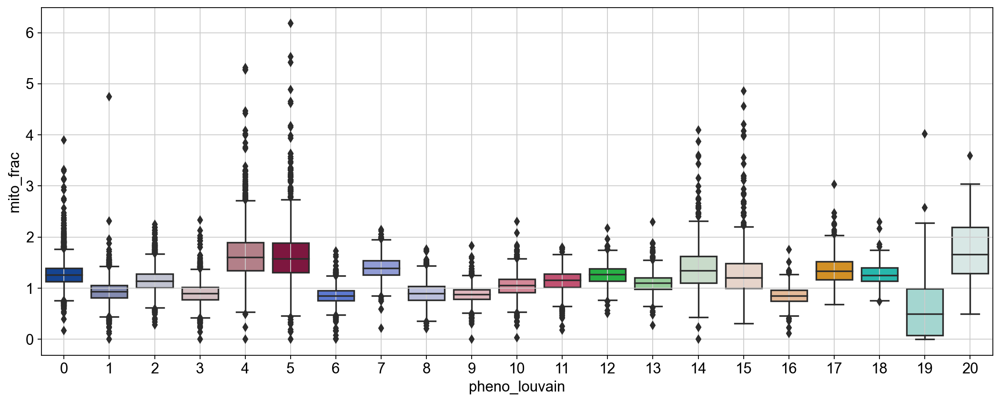

In [ ]:
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = adata.obs[['mito_frac', 'pheno_louvain']]

import seaborn as sns
fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.boxplot(x = "pheno_louvain", y = "mito_frac", data = df_temp, ax = ax, 
            palette = sc.pl.palettes.zeileis_28)
ax.grid('on')

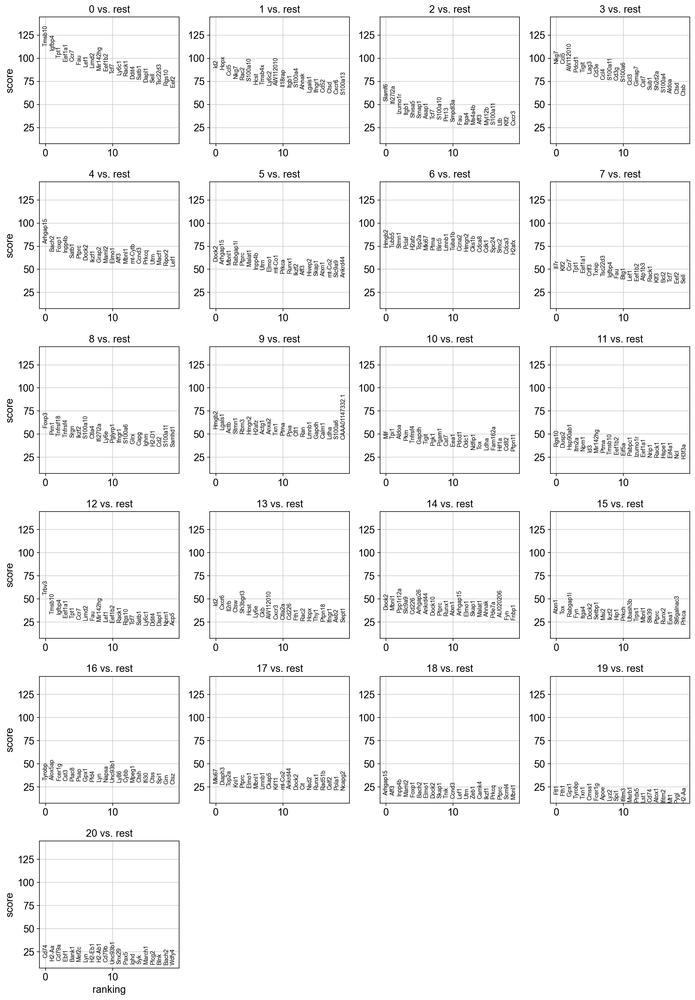

In [ ]:
sc.pl.rank_genes_groups(adata)

In [ ]:
# remove cluster 4, 5, 14, 15, 17 (higher mito frac), 16, 19 (ILTC), 20 (B)
cells_remove = np.isin(adata.obs['pheno_louvain'], [4, 5, 14, 15, 17, 16, 19, 20])
adata_clean2 = sc.AnnData(adata.X[~cells_remove, :], 
                         obs = adata.obs.iloc[~cells_remove, :], 
                         var = adata.var)
adata_clean2.layers['norm_counts'] = adata.layers['norm_counts'][~cells_remove, :].copy()
adata_clean2.layers['raw_data'] = adata.layers['raw_data'][~cells_remove, :].copy()
adata_clean2.layers['zs_norm_log'] = adata.layers['zs_norm_log'][~cells_remove, :].copy()


In [ ]:
adata_clean2.write_h5ad('intermediate/half_dead_cells_removed.h5ad')

## END